In [1]:
# Get the data for expeirment
import sklearn
import pandas as pd 
import numpy as np
import time

from sklearn import tree
from sklearn.metrics import r2_score
from sklearn.preprocessing import StandardScaler
from sklearn import preprocessing
from sklearn.metrics import explained_variance_score, mean_squared_error
from scipy.spatial.distance import cdist
from numpy.linalg import pinv
from math import sqrt

from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
from sklearn.neural_network import MLPRegressor
from sklearn.model_selection import KFold
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import geopy.distance as distance
from sklearn.preprocessing import MinMaxScaler

import Data_utils
import matplotlib.ticker as ticker
from functools import reduce
from collections import Counter

In [2]:
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt
from tensorflow.keras import datasets, layers, models, losses

print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  1


In [3]:
# Experiment results for features of wind speed only

In [4]:
train_data = pd.read_csv('Data\processed_ab_teacher_train.txt')
test_data = pd.read_csv('Data\processed_ab_teacher_test.txt')

C:\Users\PPL\AppData\Local\Temp\ipykernel_125484\1566597681.py:1: DtypeWarning: Columns (3) have mixed types. Specify dtype option on import or set low_memory=False.
  train_data = pd.read_csv('Data\processed_ab_teacher_train.txt')
C:\Users\PPL\AppData\Local\Temp\ipykernel_125484\1566597681.py:2: DtypeWarning: Columns (3) have mixed types. Specify dtype option on import or set low_memory=False.
  test_data = pd.read_csv('Data\processed_ab_teacher_test.txt')


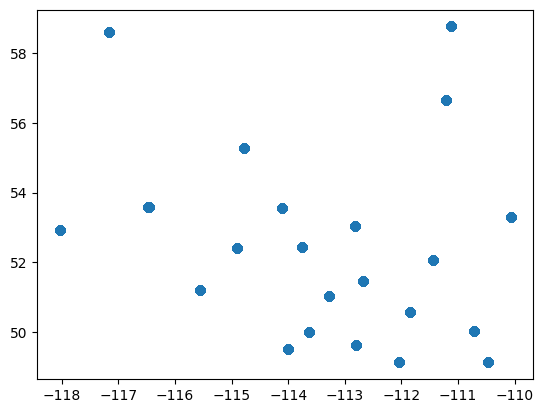

In [5]:
plt.scatter(x=train_data['longitude'], y=train_data['latitude'])
plt.show()

In [6]:
train_data_dates = train_data['date'].unique()

In [7]:
train_data_dates.shape

(28721,)

In [36]:
train_data['name'].unique().shape

(25,)

Text(0.5, 0, 'Number of stations')

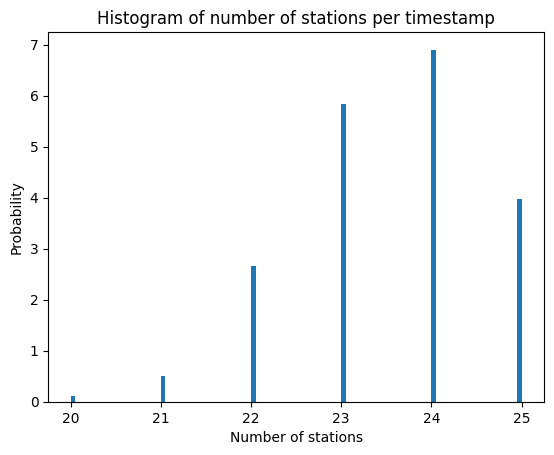

In [39]:
grouped_by_date_data = train_data.groupby('date')
size = grouped_by_date_data.size()

plt.hist(size, bins=100, density=True)
plt.title("Histogram of number of stations per timestamp")
plt.ylabel("Probability")
plt.xlabel("Number of stations")

In [8]:
# Source: From the TSmodel
def preprocess_data(train, validation):
    scaler = StandardScaler()
    train_data = scaler.fit_transform(train)
    validation_data = scaler.transform(validation)
    
    return train_data, validation_data

In [9]:
def fcm_rule_model(train_x, train_y, validation_x, validation_y):
    start_time = time.time()

    # Fcm hyperparameters
    FCM_Nc = 30
    FCM_m = 2
    tol = 1e-5
    max_iter = 200
        
    N = train_x.shape[0]
    U = np.random.rand(N, FCM_Nc)
    U = U / np.sum(U, axis=1, keepdims=True)
    qs = []

    # Fuzzy C-Means 聚类
    for _ in range(max_iter):
        U_old = U.copy()
        mf = U ** FCM_m
        cen = np.dot(mf.T, train_x) / np.sum(mf, axis=0, keepdims=True).T
        dists = cdist(train_x, cen)
        tmp = np.power(dists, -2 / (FCM_m - 1))
        U = tmp / np.sum(tmp, axis=1, keepdims=True)

        q = np.sum((U ** FCM_m) * (dists ** 2))
        qs.append(q)

        # 检查是否收敛
        if np.linalg.norm(U - U_old) < tol:
            break
    # 模型训练 find if this can be optimized
    z = np.hstack((np.ones((N, 1)), train_x))
    H = np.zeros((N, FCM_Nc * (train_x.shape[1] + 1)))

    # 生成模糊规则矩阵 H
    for j in range(FCM_Nc):
        Uj = np.tile(U[:, j], (train_x.shape[1] + 1, 1)).T
        H[:, (j * (train_x.shape[1] + 1)):((j + 1) * (train_x.shape[1] + 1))] = Uj * z

    # 计算权重 W
    W = pinv(np.dot(H.T, H)).dot(H.T).dot(train_y)

        
    # 在训练集上进行预测
    y_hat_train = np.dot(H, W)
    mse_train = mean_squared_error(train_y, y_hat_train)
    rmse_train = sqrt(mean_squared_error(train_y, y_hat_train))
    print("FCM traning RMSE:", rmse_train)
    
    # validation
    N_validation = validation_x.shape[0]
    z_validation = np.hstack((np.ones((N_validation, 1)), validation_x))
    H_validation = np.zeros((N_validation, FCM_Nc * (validation_x.shape[1] + 1)))
    dists_validation = cdist(validation_x, cen)
    tmp_validation = np.power(dists_validation, -2 / (FCM_m - 1))
    U_validation = tmp_validation / np.sum(tmp_validation, axis=1, keepdims=True)

    # 生成模糊规则矩阵 H_test
    for j in range(FCM_Nc):
        Uj_validation = np.tile(U_validation[:, j], (validation_x.shape[1] + 1, 1)).T
        H_validation[:, (j * (validation_x.shape[1] + 1)):((j + 1) * (validation_x.shape[1] + 1))] = Uj_validation * z_validation

    # validation set
    y_hat_validation = np.dot(H_validation, W)
    mse_validation = mean_squared_error(validation_y, y_hat_validation)
    rmse_validation = sqrt(mse_validation)
    print("FCM val RMSE:", rmse_validation)
    

    # 模型测试
#     N_test = test_x.shape[0]
#     z_test = np.hstack((np.ones((N_test, 1)), test_x))
#     H_test = np.zeros((N_test, FCM_Nc * (test_x.shape[1] + 1)))
#     dists_test = cdist(test_x, cen)
#     tmp_test = np.power(dists_test, -2 / (FCM_m - 1))
#     U_test = tmp_test / np.sum(tmp_test, axis=1, keepdims=True)

#     # 生成模糊规则矩阵 H_test
#     for j in range(FCM_Nc):
#         Uj_test = np.tile(U_test[:, j], (test_x.shape[1] + 1, 1)).T
#         H_test[:, (j * (test_x.shape[1] + 1)):((j + 1) * (test_x.shape[1] + 1))] = Uj_test * z_test

#     # 在测试集上进行预测
#     y_hat_test = np.dot(H_test, W)
#     mse_test = mean_squared_error(test_y, y_hat_test)
#     rmse_test = sqrt(mean_squared_error(test_y, y_hat_test))
#     print("test MSE:", mse_test)
#     print("test RMSE:", rmse_test)
#     test_results.append({'fcm_test':rmse_test})
    
        
#     print('r2 score')
#     print(r2_score(test_y, y_hat_test))


    # 绘制拟合曲线
#     plt.figure()
#     plt.subplot(1, 2, 1)
#     plt.plot([min(train_y),max(train_y)], [min(train_y),max(train_y)], 'k--')
#     plt.plot(train_y, y_hat_train, 'ro', alpha=.2)
#     plt.title('Training')
#     plt.legend()

#     plt.subplot(1, 2, 2)
#     plt.plot([min(validation_y),max(validation_y)], [min(validation_y),max(validation_y)], 'k--')
#     plt.plot(validation_y, y_hat_validation, 'ro', alpha=.2)
#     plt.title('Testing')
#     plt.legend()
#     plt.show()
    # Plot the prediction vs the true value
    plt.figure(figsize=(8,8))    
    plt.plot([min(validation_y),max(validation_y)], [min(validation_y),max(validation_y)], 'k--')
    plt.plot(validation_y, y_hat_validation, 'ro', alpha=.2)
    plt.title('TS model prediction vs true value for testing data')
    #plt.legend()
    plt.title('TS model optimization target Q v.s. iteration')
    plt.figure(figsize=(8,8))
    plt.plot(qs)
    #plt.show()

    return rmse_train, rmse_validation, time.time() - start_time


In [10]:
def linear_model(train_x, train_y, validation_x, validation_y):
    start_time = time.time()

    reg = LinearRegression().fit(train_x, train_y)
        
    train_pred = reg.predict(train_x)
    
    validation_pred = reg.predict(validation_x)
    
    print("linear train")
    print(mean_squared_error(train_y, train_pred, squared = False))
    
    print("linear_validation")
    print(mean_squared_error(validation_y, validation_pred, squared = False))
    
    return mean_squared_error(train_y, train_pred, squared = False), mean_squared_error(validation_y, validation_pred, squared = False),time.time() - start_time

In [11]:
def build_neural_network_model():
    model = models.Sequential()
    model.add(layers.Dense(30, activation=tf.keras.activations.tanh))    
    model.add(layers.Dense(1))    
    
    return model

In [12]:
def neural_network_model(train_x, train_y, validation_x, validation_y):
    start_time = time.time()
    
    neural_network_model = build_neural_network_model()
    
    neural_network_model.compile(
        optimizer='adam',
        loss=tf.keras.losses.MeanSquaredError(),
        metrics=[tf.keras.metrics.RootMeanSquaredError()]
    )
    
    history = neural_network_model.fit(
        train_x, 
        train_y, 
        epochs=number_of_epochs, 
        validation_data=(validation_x, validation_y)
    )
    
    return history, np.mean(np.array(history.history['root_mean_squared_error'])), np.mean(np.array(history.history['val_root_mean_squared_error'])), neural_network_model,time.time() - start_time

In [13]:
# Filter and process the data suitable for the training/testing
def generate_exp_data(raw_data, number_of_stations, max_threshold_distance, min_threshold_distance, features_to_use):
    # First fitler the data based on the settings
    x = []
    y = []

    for station in raw_data['name'].unique():
        features, target = Data_utils.generate_data(
            raw_data, 
            station, 
            number_of_stations, 
            max_threshold_distance, 
            min_threshold_distance
        )

        if (len(features)!=0) & (len(target)!=0):
            np_features = np.array(features)
            np_target = np.array(target)

            x.append(np_features)
            y.append(np_target)
    
    return x, y

In [21]:
# hyperparameters for the expeirment
number_of_neighbour_stations = [1,2,3,4,5,6,7,8,9, 10,12,13,14, 15,20]
number_of_epochs = 50

# Expeirment related parameters
number_of_folds = 10 # have to be 10 fold
# General hyperparameter
max_threshold_distance = 100000 #km
min_threshold_distance = 0 #km

# Results containers
training_results = []
training_times = []
validation_results = []
nn_histories = []

features_to_use=['wind_speed']

# Determine the optimal value for the given hyperparameter
def do_experiment(hyper_parameter_to_test_values): #, training_data):
    kf = KFold(n_splits=number_of_folds, shuffle=True)
    
    for hyperparameter_value in hyper_parameter_to_test_values:
        # First fitler the data based on the settings
        train_x, train_y = generate_exp_data(train_data, hyperparameter_value, max_threshold_distance, min_threshold_distance, features_to_use)
        
        # After all stations are filtered, flatten the data into a huge list        
        flatten_x = np.array([data for sublist in train_x for data in sublist])
        flatten_y = np.array([data for sublist in train_y for data in sublist])
        
        temp_x = pd.DataFrame(flatten_x)
        temp_x.to_csv(f"Data\exp\{hyperparameter_value}x.csv")
        temp_y = pd.DataFrame(flatten_y)
        temp_y.to_csv(f"Data\exp\{hyperparameter_value}y.csv")
        # Station data is generated already, only need to train the model
        #flatten_x = pd.read_csv(f"Data/exp/1016completed/{hyperparameter_value}x.csv", index_col=0).to_numpy()
        #flatten_y = pd.read_csv(f"Data/exp/1016completed/{hyperparameter_value}y.csv", index_col=0).to_numpy()
        
        # After all data are ready, do a 10 fold cross validation
        training_results_fold = []
        validation_results_fold = []
        test_results_fold = []
        nn_history_fold = []
        
        for i, (train_index, val_index) in enumerate(kf.split(flatten_x)):
            split_train_x = flatten_x[train_index]
            split_train_y = flatten_y[train_index]

            split_val_x = flatten_x[val_index]
            split_val_y = flatten_y[val_index]
            # Normalize the input
            split_train_x, split_val_x = preprocess_data(split_train_x, split_val_x)            
            # Linear model
            li_train_rmse, li_val_rmse, li_train_time = linear_model(split_train_x, split_train_y, split_val_x , split_val_y)
            training_results_fold.append({'linear_train' : li_train_rmse})
            training_times.append({'linear_train' : li_train_time})
            validation_results_fold.append({'linear_val' : li_val_rmse})
            
            # FCM model
            fcm_train_rmse, fcm_val_rmse,fcm_train_time = fcm_rule_model(split_train_x, split_train_y, split_val_x , split_val_y)
            training_results_fold.append({'fcm_train' : fcm_train_rmse})
            training_times.append({'fcm_train' : fcm_train_time})
            validation_results_fold.append({'fcm_val' : fcm_val_rmse})
            
            # NN
            nn_history, nn_train_rmse, nn_val_rmse, nn_model, nn_train_time = neural_network_model(split_train_x, split_train_y, split_val_x , split_val_y)
            
            nn_val_prediction = nn_model.predict(split_val_x)
            # Plot the prediction vs the true value for neural network
            plt.figure(figsize=(8,8))    
            plt.plot([min(split_val_y),max(split_val_y)], [min(split_val_y),max(split_val_y)], 'k--')
            plt.plot(split_val_y, nn_val_prediction, 'ro', alpha=.2)
            plt.title('Neural network prediction vs true value for validation data')
            # Record results
            nn_history_fold.append(nn_history.history)
            training_results_fold.append({'nn_train' : nn_train_rmse})
            training_times.append({'nn_train' : nn_train_time})
            validation_results_fold.append({'nn_val' : nn_val_rmse})
        
        #After all folds are done, update the result containers
        training_results.append(training_results_fold)
        validation_results.append(validation_results_fold)
        nn_histories.append(nn_history_fold)        
        

linear train
7.604970347977437
linear_validation
7.5200302305817806
FCM traning RMSE: 7.5094998562157285
FCM val RMSE: 7.430305202032328
Epoch 1/50
17840/17840 [==============================] - 25s 1ms/step - loss: 59.9687 - root_mean_squared_error: 7.7439 - val_loss: 52.9691 - val_root_mean_squared_error: 7.2780
Epoch 2/50
17840/17840 [==============================] - 26s 1ms/step - loss: 53.1273 - root_mean_squared_error: 7.2888 - val_loss: 51.1969 - val_root_mean_squared_error: 7.1552
Epoch 3/50
17840/17840 [==============================] - 25s 1ms/step - loss: 51.8768 - root_mean_squared_error: 7.2026 - val_loss: 50.3311 - val_root_mean_squared_error: 7.0944
Epoch 4/50
17840/17840 [==============================] - 25s 1ms/step - loss: 50.9905 - root_mean_squared_error: 7.1408 - val_loss: 49.4738 - val_root_mean_squared_error: 7.0338
Epoch 5/50
17840/17840 [==============================] - 26s 1ms/step - loss: 50.1146 - root_mean_squared_error: 7.0792 - val_loss: 48.5175 - val_

Epoch 46/50
17840/17840 [==============================] - 26s 1ms/step - loss: 43.9015 - root_mean_squared_error: 6.6258 - val_loss: 43.0884 - val_root_mean_squared_error: 6.5642
Epoch 47/50
17840/17840 [==============================] - 25s 1ms/step - loss: 43.8855 - root_mean_squared_error: 6.6246 - val_loss: 43.0773 - val_root_mean_squared_error: 6.5633
Epoch 48/50
17840/17840 [==============================] - 25s 1ms/step - loss: 43.8830 - root_mean_squared_error: 6.6244 - val_loss: 43.0411 - val_root_mean_squared_error: 6.5606
Epoch 49/50
17840/17840 [==============================] - 25s 1ms/step - loss: 43.8646 - root_mean_squared_error: 6.6230 - val_loss: 42.9940 - val_root_mean_squared_error: 6.5570
Epoch 50/50
1983/1983 [==============================] - 1s 531us/step
linear train
7.5899794703500145
linear_validation
7.6551419066981135
FCM traning RMSE: 7.502580853865727
FCM val RMSE: 7.56608678730374
Epoch 1/50
17840/17840 [==============================] - 20s 1ms/step - 

17840/17840 [==============================] - 20s 1ms/step - loss: 43.9788 - root_mean_squared_error: 6.6317 - val_loss: 44.6982 - val_root_mean_squared_error: 6.6857
Epoch 41/50
17840/17840 [==============================] - 20s 1ms/step - loss: 43.9594 - root_mean_squared_error: 6.6302 - val_loss: 44.7314 - val_root_mean_squared_error: 6.6882
Epoch 42/50
17840/17840 [==============================] - 20s 1ms/step - loss: 43.9474 - root_mean_squared_error: 6.6293 - val_loss: 44.6843 - val_root_mean_squared_error: 6.6846
Epoch 43/50
17840/17840 [==============================] - 20s 1ms/step - loss: 43.9228 - root_mean_squared_error: 6.6274 - val_loss: 44.6596 - val_root_mean_squared_error: 6.6828
Epoch 44/50
17840/17840 [==============================] - 19s 1ms/step - loss: 43.9118 - root_mean_squared_error: 6.6266 - val_loss: 44.7639 - val_root_mean_squared_error: 6.6906
Epoch 45/50
17840/17840 [==============================] - 19s 1ms/step - loss: 43.8969 - root_mean_squared_erro

17840/17840 [==============================] - 20s 1ms/step - loss: 43.9407 - root_mean_squared_error: 6.6288 - val_loss: 44.0339 - val_root_mean_squared_error: 6.6358
Epoch 35/50
17840/17840 [==============================] - 20s 1ms/step - loss: 43.9181 - root_mean_squared_error: 6.6271 - val_loss: 44.2095 - val_root_mean_squared_error: 6.6490
Epoch 36/50
17840/17840 [==============================] - 20s 1ms/step - loss: 43.8908 - root_mean_squared_error: 6.6250 - val_loss: 44.0736 - val_root_mean_squared_error: 6.6388
Epoch 37/50
17840/17840 [==============================] - 20s 1ms/step - loss: 43.8835 - root_mean_squared_error: 6.6245 - val_loss: 44.1179 - val_root_mean_squared_error: 6.6421
Epoch 38/50
17840/17840 [==============================] - 20s 1ms/step - loss: 43.8684 - root_mean_squared_error: 6.6233 - val_loss: 44.0296 - val_root_mean_squared_error: 6.6355
Epoch 39/50
17840/17840 [==============================] - 20s 1ms/step - loss: 43.8504 - root_mean_squared_erro

17840/17840 [==============================] - 20s 1ms/step - loss: 44.0357 - root_mean_squared_error: 6.6359 - val_loss: 43.3230 - val_root_mean_squared_error: 6.5820
Epoch 29/50
17840/17840 [==============================] - 20s 1ms/step - loss: 44.0052 - root_mean_squared_error: 6.6336 - val_loss: 43.3638 - val_root_mean_squared_error: 6.5851
Epoch 30/50
17840/17840 [==============================] - 21s 1ms/step - loss: 43.9792 - root_mean_squared_error: 6.6317 - val_loss: 43.2633 - val_root_mean_squared_error: 6.5775
Epoch 31/50
17840/17840 [==============================] - 21s 1ms/step - loss: 43.9534 - root_mean_squared_error: 6.6297 - val_loss: 43.2403 - val_root_mean_squared_error: 6.5757
Epoch 32/50
17840/17840 [==============================] - 20s 1ms/step - loss: 43.9333 - root_mean_squared_error: 6.6282 - val_loss: 43.1798 - val_root_mean_squared_error: 6.5711
Epoch 33/50
17840/17840 [==============================] - 20s 1ms/step - loss: 43.9073 - root_mean_squared_erro

17840/17840 [==============================] - 19s 1ms/step - loss: 44.5841 - root_mean_squared_error: 6.6771 - val_loss: 43.6693 - val_root_mean_squared_error: 6.6083
Epoch 23/50
17840/17840 [==============================] - 19s 1ms/step - loss: 44.5393 - root_mean_squared_error: 6.6738 - val_loss: 43.6553 - val_root_mean_squared_error: 6.6072
Epoch 24/50
17840/17840 [==============================] - 20s 1ms/step - loss: 44.4852 - root_mean_squared_error: 6.6697 - val_loss: 43.5937 - val_root_mean_squared_error: 6.6026
Epoch 25/50
17840/17840 [==============================] - 20s 1ms/step - loss: 44.4424 - root_mean_squared_error: 6.6665 - val_loss: 43.5554 - val_root_mean_squared_error: 6.5997
Epoch 26/50
17840/17840 [==============================] - 20s 1ms/step - loss: 44.4057 - root_mean_squared_error: 6.6638 - val_loss: 43.5958 - val_root_mean_squared_error: 6.6027
Epoch 27/50
17840/17840 [==============================] - 20s 1ms/step - loss: 44.3595 - root_mean_squared_erro

17840/17840 [==============================] - 20s 1ms/step - loss: 44.7175 - root_mean_squared_error: 6.6871 - val_loss: 45.0231 - val_root_mean_squared_error: 6.7099
Epoch 17/50
17840/17840 [==============================] - 20s 1ms/step - loss: 44.6115 - root_mean_squared_error: 6.6792 - val_loss: 45.0247 - val_root_mean_squared_error: 6.7100
Epoch 18/50
17840/17840 [==============================] - 20s 1ms/step - loss: 44.5312 - root_mean_squared_error: 6.6732 - val_loss: 44.8745 - val_root_mean_squared_error: 6.6988
Epoch 19/50
17840/17840 [==============================] - 20s 1ms/step - loss: 44.4355 - root_mean_squared_error: 6.6660 - val_loss: 44.7769 - val_root_mean_squared_error: 6.6916
Epoch 20/50
17840/17840 [==============================] - 19s 1ms/step - loss: 44.3744 - root_mean_squared_error: 6.6614 - val_loss: 44.7235 - val_root_mean_squared_error: 6.6876
Epoch 21/50
17840/17840 [==============================] - 19s 1ms/step - loss: 44.2879 - root_mean_squared_erro

17840/17840 [==============================] - 20s 1ms/step - loss: 46.2588 - root_mean_squared_error: 6.8014 - val_loss: 45.8570 - val_root_mean_squared_error: 6.7718
Epoch 11/50
17840/17840 [==============================] - 19s 1ms/step - loss: 45.7269 - root_mean_squared_error: 6.7622 - val_loss: 45.5455 - val_root_mean_squared_error: 6.7487
Epoch 12/50
17840/17840 [==============================] - 20s 1ms/step - loss: 45.3590 - root_mean_squared_error: 6.7349 - val_loss: 45.0912 - val_root_mean_squared_error: 6.7150
Epoch 13/50
17840/17840 [==============================] - 20s 1ms/step - loss: 45.1421 - root_mean_squared_error: 6.7188 - val_loss: 44.9730 - val_root_mean_squared_error: 6.7062
Epoch 14/50
17840/17840 [==============================] - 20s 1ms/step - loss: 44.9935 - root_mean_squared_error: 6.7077 - val_loss: 44.8548 - val_root_mean_squared_error: 6.6974
Epoch 15/50
17840/17840 [==============================] - 20s 1ms/step - loss: 44.8693 - root_mean_squared_erro

C:\Users\PPL\AppData\Local\Temp\ipykernel_125484\3049062189.py:70: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(8,8))


linear train
7.597587535769556
linear_validation
7.586902739794464
FCM traning RMSE: 7.492028541143686
FCM val RMSE: 7.483018165552298
Epoch 1/50
17840/17840 [==============================] - 20s 1ms/step - loss: 60.3080 - root_mean_squared_error: 7.7658 - val_loss: 54.0227 - val_root_mean_squared_error: 7.3500
Epoch 2/50
17840/17840 [==============================] - 20s 1ms/step - loss: 53.3353 - root_mean_squared_error: 7.3031 - val_loss: 52.2746 - val_root_mean_squared_error: 7.2301
Epoch 3/50
17840/17840 [==============================] - 20s 1ms/step - loss: 51.6902 - root_mean_squared_error: 7.1896 - val_loss: 50.8431 - val_root_mean_squared_error: 7.1304
Epoch 4/50
17840/17840 [==============================] - 20s 1ms/step - loss: 50.4117 - root_mean_squared_error: 7.1001 - val_loss: 49.4674 - val_root_mean_squared_error: 7.0333
Epoch 5/50
17840/17840 [==============================] - 20s 1ms/step - loss: 48.8488 - root_mean_squared_error: 6.9892 - val_loss: 47.8918 - val_ro

Epoch 46/50
17840/17840 [==============================] - 20s 1ms/step - loss: 43.8282 - root_mean_squared_error: 6.6203 - val_loss: 43.6689 - val_root_mean_squared_error: 6.6082
Epoch 47/50
17840/17840 [==============================] - 19s 1ms/step - loss: 43.8141 - root_mean_squared_error: 6.6192 - val_loss: 43.7412 - val_root_mean_squared_error: 6.6137
Epoch 48/50
17840/17840 [==============================] - 20s 1ms/step - loss: 43.8129 - root_mean_squared_error: 6.6191 - val_loss: 43.6415 - val_root_mean_squared_error: 6.6062
Epoch 49/50
17840/17840 [==============================] - 19s 1ms/step - loss: 43.7926 - root_mean_squared_error: 6.6176 - val_loss: 43.7699 - val_root_mean_squared_error: 6.6159
Epoch 50/50
1983/1983 [==============================] - 1s 535us/step
linear train
7.589502079568595
linear_validation
7.659400225942206
FCM traning RMSE: 7.494944162176547
FCM val RMSE: 7.565482467527631
Epoch 1/50
17840/17840 [==============================] - 20s 1ms/step - l

17840/17840 [==============================] - 20s 1ms/step - loss: 43.8052 - root_mean_squared_error: 6.6186 - val_loss: 44.3291 - val_root_mean_squared_error: 6.6580
Epoch 41/50
17840/17840 [==============================] - 21s 1ms/step - loss: 43.7848 - root_mean_squared_error: 6.6170 - val_loss: 44.3271 - val_root_mean_squared_error: 6.6579
Epoch 42/50
17840/17840 [==============================] - 21s 1ms/step - loss: 43.7839 - root_mean_squared_error: 6.6169 - val_loss: 44.4254 - val_root_mean_squared_error: 6.6652
Epoch 43/50
17840/17840 [==============================] - 20s 1ms/step - loss: 43.7723 - root_mean_squared_error: 6.6161 - val_loss: 44.2542 - val_root_mean_squared_error: 6.6524
Epoch 44/50
17840/17840 [==============================] - 20s 1ms/step - loss: 43.7616 - root_mean_squared_error: 6.6153 - val_loss: 44.3246 - val_root_mean_squared_error: 6.6577
Epoch 45/50
17840/17840 [==============================] - 20s 1ms/step - loss: 43.7550 - root_mean_squared_erro

17840/17840 [==============================] - 20s 1ms/step - loss: 43.8634 - root_mean_squared_error: 6.6229 - val_loss: 44.3617 - val_root_mean_squared_error: 6.6605
Epoch 35/50
17840/17840 [==============================] - 20s 1ms/step - loss: 43.8435 - root_mean_squared_error: 6.6214 - val_loss: 44.3275 - val_root_mean_squared_error: 6.6579
Epoch 36/50
17840/17840 [==============================] - 19s 1ms/step - loss: 43.8214 - root_mean_squared_error: 6.6198 - val_loss: 44.3633 - val_root_mean_squared_error: 6.6606
Epoch 37/50
17840/17840 [==============================] - 20s 1ms/step - loss: 43.8052 - root_mean_squared_error: 6.6185 - val_loss: 44.2831 - val_root_mean_squared_error: 6.6546
Epoch 38/50
17840/17840 [==============================] - 19s 1ms/step - loss: 43.7934 - root_mean_squared_error: 6.6177 - val_loss: 44.2745 - val_root_mean_squared_error: 6.6539
Epoch 39/50
17840/17840 [==============================] - 20s 1ms/step - loss: 43.7676 - root_mean_squared_erro

16973/16973 [==============================] - 25s 1ms/step - loss: 38.4724 - root_mean_squared_error: 6.2026 - val_loss: 38.6193 - val_root_mean_squared_error: 6.2144
Epoch 29/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.4623 - root_mean_squared_error: 6.2018 - val_loss: 38.6502 - val_root_mean_squared_error: 6.2169
Epoch 30/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.4444 - root_mean_squared_error: 6.2004 - val_loss: 38.6194 - val_root_mean_squared_error: 6.2144
Epoch 31/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.4253 - root_mean_squared_error: 6.1988 - val_loss: 38.6514 - val_root_mean_squared_error: 6.2170
Epoch 32/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.4151 - root_mean_squared_error: 6.1980 - val_loss: 38.6146 - val_root_mean_squared_error: 6.2141
Epoch 33/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.3920 - root_mean_squared_erro

16973/16973 [==============================] - 25s 1ms/step - loss: 38.6148 - root_mean_squared_error: 6.2141 - val_loss: 38.8733 - val_root_mean_squared_error: 6.2348
Epoch 23/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.5878 - root_mean_squared_error: 6.2119 - val_loss: 38.7388 - val_root_mean_squared_error: 6.2240
Epoch 24/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.5518 - root_mean_squared_error: 6.2090 - val_loss: 38.9612 - val_root_mean_squared_error: 6.2419
Epoch 25/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.5318 - root_mean_squared_error: 6.2074 - val_loss: 38.8100 - val_root_mean_squared_error: 6.2298
Epoch 26/50
16973/16973 [==============================] - 25s 1ms/step - loss: 38.5054 - root_mean_squared_error: 6.2053 - val_loss: 38.6660 - val_root_mean_squared_error: 6.2182
Epoch 27/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.4769 - root_mean_squared_erro

16973/16973 [==============================] - 25s 1ms/step - loss: 38.7165 - root_mean_squared_error: 6.2223 - val_loss: 39.3028 - val_root_mean_squared_error: 6.2692
Epoch 17/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.6887 - root_mean_squared_error: 6.2200 - val_loss: 39.0991 - val_root_mean_squared_error: 6.2529
Epoch 18/50
16973/16973 [==============================] - 25s 1ms/step - loss: 38.6655 - root_mean_squared_error: 6.2182 - val_loss: 39.1439 - val_root_mean_squared_error: 6.2565
Epoch 19/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.6252 - root_mean_squared_error: 6.2149 - val_loss: 39.1502 - val_root_mean_squared_error: 6.2570
Epoch 20/50
16973/16973 [==============================] - 25s 1ms/step - loss: 38.6033 - root_mean_squared_error: 6.2132 - val_loss: 39.0568 - val_root_mean_squared_error: 6.2495
Epoch 21/50
16973/16973 [==============================] - 25s 1ms/step - loss: 38.5695 - root_mean_squared_erro

16973/16973 [==============================] - 24s 1ms/step - loss: 39.0794 - root_mean_squared_error: 6.2514 - val_loss: 38.6861 - val_root_mean_squared_error: 6.2198
Epoch 11/50
16973/16973 [==============================] - 24s 1ms/step - loss: 39.0054 - root_mean_squared_error: 6.2454 - val_loss: 38.7727 - val_root_mean_squared_error: 6.2268
Epoch 12/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.9470 - root_mean_squared_error: 6.2408 - val_loss: 38.6569 - val_root_mean_squared_error: 6.2175
Epoch 13/50
16973/16973 [==============================] - 25s 1ms/step - loss: 38.8863 - root_mean_squared_error: 6.2359 - val_loss: 38.6895 - val_root_mean_squared_error: 6.2201
Epoch 14/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.8397 - root_mean_squared_error: 6.2321 - val_loss: 38.5419 - val_root_mean_squared_error: 6.2082
Epoch 15/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.7998 - root_mean_squared_erro

16973/16973 [==============================] - 24s 1ms/step - loss: 40.9002 - root_mean_squared_error: 6.3953 - val_loss: 40.8396 - val_root_mean_squared_error: 6.3906
Epoch 5/50
16973/16973 [==============================] - 25s 1ms/step - loss: 40.4285 - root_mean_squared_error: 6.3583 - val_loss: 40.5082 - val_root_mean_squared_error: 6.3646
Epoch 6/50
16973/16973 [==============================] - 24s 1ms/step - loss: 40.0835 - root_mean_squared_error: 6.3312 - val_loss: 40.3713 - val_root_mean_squared_error: 6.3538
Epoch 7/50
16973/16973 [==============================] - 24s 1ms/step - loss: 39.8111 - root_mean_squared_error: 6.3096 - val_loss: 39.9256 - val_root_mean_squared_error: 6.3187
Epoch 8/50
16973/16973 [==============================] - 24s 1ms/step - loss: 39.6140 - root_mean_squared_error: 6.2940 - val_loss: 39.6492 - val_root_mean_squared_error: 6.2968
Epoch 9/50
16973/16973 [==============================] - 24s 1ms/step - loss: 39.4691 - root_mean_squared_error: 6.

16973/16973 [==============================] - 24s 1ms/step - loss: 38.1847 - root_mean_squared_error: 6.1794 - val_loss: 38.4013 - val_root_mean_squared_error: 6.1969
Epoch 50/50
1886/1886 [==============================] - 1s 502us/step
linear train
7.326465922058372
linear_validation
7.343472447265928
FCM traning RMSE: 6.887274759792673
FCM val RMSE: 6.899935632582546
Epoch 1/50
16973/16973 [==============================] - 25s 1ms/step - loss: 53.3414 - root_mean_squared_error: 7.3035 - val_loss: 44.9573 - val_root_mean_squared_error: 6.7050
Epoch 2/50
16973/16973 [==============================] - 24s 1ms/step - loss: 43.1291 - root_mean_squared_error: 6.5673 - val_loss: 41.9535 - val_root_mean_squared_error: 6.4772
Epoch 3/50
16973/16973 [==============================] - 24s 1ms/step - loss: 41.4095 - root_mean_squared_error: 6.4350 - val_loss: 40.9892 - val_root_mean_squared_error: 6.4023
Epoch 4/50
16973/16973 [==============================] - 24s 1ms/step - loss: 40.7234 - 

16973/16973 [==============================] - 24s 1ms/step - loss: 38.2347 - root_mean_squared_error: 6.1834 - val_loss: 38.2971 - val_root_mean_squared_error: 6.1885
Epoch 44/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.2218 - root_mean_squared_error: 6.1824 - val_loss: 38.4888 - val_root_mean_squared_error: 6.2039
Epoch 45/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.2155 - root_mean_squared_error: 6.1819 - val_loss: 38.3197 - val_root_mean_squared_error: 6.1903
Epoch 46/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.2004 - root_mean_squared_error: 6.1806 - val_loss: 38.1938 - val_root_mean_squared_error: 6.1801
Epoch 47/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.1864 - root_mean_squared_error: 6.1795 - val_loss: 38.2394 - val_root_mean_squared_error: 6.1838
Epoch 48/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.1682 - root_mean_squared_erro

16973/16973 [==============================] - 24s 1ms/step - loss: 38.4133 - root_mean_squared_error: 6.1978 - val_loss: 38.3686 - val_root_mean_squared_error: 6.1942
Epoch 38/50
16973/16973 [==============================] - 23s 1ms/step - loss: 38.3990 - root_mean_squared_error: 6.1967 - val_loss: 38.2810 - val_root_mean_squared_error: 6.1872
Epoch 39/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.3917 - root_mean_squared_error: 6.1961 - val_loss: 38.2957 - val_root_mean_squared_error: 6.1884
Epoch 40/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.3700 - root_mean_squared_error: 6.1944 - val_loss: 38.1985 - val_root_mean_squared_error: 6.1805
Epoch 41/50
16973/16973 [==============================] - 25s 1ms/step - loss: 38.3502 - root_mean_squared_error: 6.1928 - val_loss: 38.2411 - val_root_mean_squared_error: 6.1839
Epoch 42/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.3237 - root_mean_squared_erro

16973/16973 [==============================] - 25s 2ms/step - loss: 38.4960 - root_mean_squared_error: 6.2045 - val_loss: 38.2405 - val_root_mean_squared_error: 6.1839
Epoch 32/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.4834 - root_mean_squared_error: 6.2035 - val_loss: 38.2530 - val_root_mean_squared_error: 6.1849
Epoch 33/50
16973/16973 [==============================] - 25s 1ms/step - loss: 38.4704 - root_mean_squared_error: 6.2025 - val_loss: 38.1480 - val_root_mean_squared_error: 6.1764
Epoch 34/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.4640 - root_mean_squared_error: 6.2019 - val_loss: 38.0451 - val_root_mean_squared_error: 6.1681
Epoch 35/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.4457 - root_mean_squared_error: 6.2005 - val_loss: 37.9387 - val_root_mean_squared_error: 6.1594
Epoch 36/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.4278 - root_mean_squared_erro

16973/16973 [==============================] - 24s 1ms/step - loss: 38.6563 - root_mean_squared_error: 6.2174 - val_loss: 38.7021 - val_root_mean_squared_error: 6.2211
Epoch 26/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.6326 - root_mean_squared_error: 6.2155 - val_loss: 38.7756 - val_root_mean_squared_error: 6.2270
Epoch 27/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.6121 - root_mean_squared_error: 6.2139 - val_loss: 38.7330 - val_root_mean_squared_error: 6.2236
Epoch 28/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.6055 - root_mean_squared_error: 6.2133 - val_loss: 38.5749 - val_root_mean_squared_error: 6.2109
Epoch 29/50
16973/16973 [==============================] - 25s 1ms/step - loss: 38.5883 - root_mean_squared_error: 6.2119 - val_loss: 38.6197 - val_root_mean_squared_error: 6.2145
Epoch 30/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.5775 - root_mean_squared_erro

16973/16973 [==============================] - 25s 1ms/step - loss: 38.8342 - root_mean_squared_error: 6.2317 - val_loss: 38.8833 - val_root_mean_squared_error: 6.2356
Epoch 20/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.8171 - root_mean_squared_error: 6.2303 - val_loss: 38.8584 - val_root_mean_squared_error: 6.2336
Epoch 21/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.7903 - root_mean_squared_error: 6.2282 - val_loss: 38.6568 - val_root_mean_squared_error: 6.2175
Epoch 22/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.7518 - root_mean_squared_error: 6.2251 - val_loss: 38.6025 - val_root_mean_squared_error: 6.2131
Epoch 23/50
16973/16973 [==============================] - 25s 1ms/step - loss: 38.7330 - root_mean_squared_error: 6.2236 - val_loss: 38.5063 - val_root_mean_squared_error: 6.2053
Epoch 24/50
16973/16973 [==============================] - 24s 1ms/step - loss: 38.7037 - root_mean_squared_erro

16295/16295 [==============================] - 23s 1ms/step - loss: 36.2903 - root_mean_squared_error: 6.0241 - val_loss: 35.8631 - val_root_mean_squared_error: 5.9886
Epoch 14/50
16295/16295 [==============================] - 23s 1ms/step - loss: 36.2329 - root_mean_squared_error: 6.0194 - val_loss: 35.5150 - val_root_mean_squared_error: 5.9594
Epoch 15/50
16295/16295 [==============================] - 23s 1ms/step - loss: 36.1883 - root_mean_squared_error: 6.0157 - val_loss: 35.5521 - val_root_mean_squared_error: 5.9626
Epoch 16/50
16295/16295 [==============================] - 23s 1ms/step - loss: 36.1506 - root_mean_squared_error: 6.0125 - val_loss: 35.8045 - val_root_mean_squared_error: 5.9837
Epoch 17/50
16295/16295 [==============================] - 24s 1ms/step - loss: 36.1098 - root_mean_squared_error: 6.0091 - val_loss: 35.3989 - val_root_mean_squared_error: 5.9497
Epoch 18/50
16295/16295 [==============================] - 23s 1ms/step - loss: 36.0712 - root_mean_squared_erro

16295/16295 [==============================] - 23s 1ms/step - loss: 36.5230 - root_mean_squared_error: 6.0434 - val_loss: 36.1844 - val_root_mean_squared_error: 6.0153
Epoch 8/50
16295/16295 [==============================] - 24s 1ms/step - loss: 36.3661 - root_mean_squared_error: 6.0304 - val_loss: 36.0583 - val_root_mean_squared_error: 6.0049
Epoch 9/50
16295/16295 [==============================] - 24s 1ms/step - loss: 36.2661 - root_mean_squared_error: 6.0221 - val_loss: 35.9333 - val_root_mean_squared_error: 5.9944
Epoch 10/50
16295/16295 [==============================] - 24s 1ms/step - loss: 36.1713 - root_mean_squared_error: 6.0143 - val_loss: 35.7130 - val_root_mean_squared_error: 5.9760
Epoch 11/50
16295/16295 [==============================] - 23s 1ms/step - loss: 36.1120 - root_mean_squared_error: 6.0093 - val_loss: 35.7908 - val_root_mean_squared_error: 5.9825
Epoch 12/50
16295/16295 [==============================] - 23s 1ms/step - loss: 36.0434 - root_mean_squared_error:

16295/16295 [==============================] - 24s 1ms/step - loss: 48.0590 - root_mean_squared_error: 6.9325 - val_loss: 40.3144 - val_root_mean_squared_error: 6.3494
Epoch 2/50
16295/16295 [==============================] - 24s 1ms/step - loss: 39.3543 - root_mean_squared_error: 6.2733 - val_loss: 39.0024 - val_root_mean_squared_error: 6.2452
Epoch 3/50
16295/16295 [==============================] - 23s 1ms/step - loss: 38.3287 - root_mean_squared_error: 6.1910 - val_loss: 38.1557 - val_root_mean_squared_error: 6.1770
Epoch 4/50
16295/16295 [==============================] - 23s 1ms/step - loss: 37.7367 - root_mean_squared_error: 6.1430 - val_loss: 37.5980 - val_root_mean_squared_error: 6.1317
Epoch 5/50
16295/16295 [==============================] - 24s 1ms/step - loss: 37.3202 - root_mean_squared_error: 6.1090 - val_loss: 37.2260 - val_root_mean_squared_error: 6.1013
Epoch 6/50
16295/16295 [==============================] - 24s 1ms/step - loss: 37.0324 - root_mean_squared_error: 6.

16295/16295 [==============================] - 24s 1ms/step - loss: 35.6277 - root_mean_squared_error: 5.9689 - val_loss: 35.8755 - val_root_mean_squared_error: 5.9896
Epoch 47/50
16295/16295 [==============================] - 24s 2ms/step - loss: 35.6225 - root_mean_squared_error: 5.9685 - val_loss: 35.7336 - val_root_mean_squared_error: 5.9778
Epoch 48/50
16295/16295 [==============================] - 24s 1ms/step - loss: 35.5994 - root_mean_squared_error: 5.9665 - val_loss: 36.0747 - val_root_mean_squared_error: 6.0062
Epoch 49/50
16295/16295 [==============================] - 24s 1ms/step - loss: 35.5844 - root_mean_squared_error: 5.9653 - val_loss: 35.9175 - val_root_mean_squared_error: 5.9931
Epoch 50/50
1811/1811 [==============================] - 1s 529us/step
linear train
7.082629335214214
linear_validation
7.079236885279498
FCM traning RMSE: 6.640606406362003
FCM val RMSE: 6.626676574839026
Epoch 1/50
16295/16295 [==============================] - 23s 1ms/step - loss: 48.5590

16295/16295 [==============================] - 24s 1ms/step - loss: 35.3732 - root_mean_squared_error: 5.9475 - val_loss: 35.5282 - val_root_mean_squared_error: 5.9606
Epoch 41/50
16295/16295 [==============================] - 23s 1ms/step - loss: 35.3690 - root_mean_squared_error: 5.9472 - val_loss: 35.5779 - val_root_mean_squared_error: 5.9647
Epoch 42/50
16295/16295 [==============================] - 23s 1ms/step - loss: 35.3583 - root_mean_squared_error: 5.9463 - val_loss: 35.5284 - val_root_mean_squared_error: 5.9606
Epoch 43/50
16295/16295 [==============================] - 23s 1ms/step - loss: 35.3477 - root_mean_squared_error: 5.9454 - val_loss: 35.4001 - val_root_mean_squared_error: 5.9498
Epoch 44/50
16295/16295 [==============================] - 23s 1ms/step - loss: 35.3415 - root_mean_squared_error: 5.9449 - val_loss: 35.3991 - val_root_mean_squared_error: 5.9497
Epoch 45/50
16295/16295 [==============================] - 23s 1ms/step - loss: 35.3390 - root_mean_squared_erro

16295/16295 [==============================] - 23s 1ms/step - loss: 35.5756 - root_mean_squared_error: 5.9645 - val_loss: 35.7957 - val_root_mean_squared_error: 5.9830
Epoch 35/50
16295/16295 [==============================] - 24s 1ms/step - loss: 35.5712 - root_mean_squared_error: 5.9642 - val_loss: 35.8461 - val_root_mean_squared_error: 5.9872
Epoch 36/50
16295/16295 [==============================] - 23s 1ms/step - loss: 35.5435 - root_mean_squared_error: 5.9618 - val_loss: 35.8709 - val_root_mean_squared_error: 5.9892
Epoch 37/50
16295/16295 [==============================] - 25s 2ms/step - loss: 35.5382 - root_mean_squared_error: 5.9614 - val_loss: 35.8906 - val_root_mean_squared_error: 5.9909
Epoch 38/50
16295/16295 [==============================] - 23s 1ms/step - loss: 35.5259 - root_mean_squared_error: 5.9604 - val_loss: 35.8357 - val_root_mean_squared_error: 5.9863
Epoch 39/50
16295/16295 [==============================] - 24s 1ms/step - loss: 35.5190 - root_mean_squared_erro

16295/16295 [==============================] - 24s 1ms/step - loss: 35.6695 - root_mean_squared_error: 5.9724 - val_loss: 36.0958 - val_root_mean_squared_error: 6.0080
Epoch 29/50
16295/16295 [==============================] - 23s 1ms/step - loss: 35.6539 - root_mean_squared_error: 5.9711 - val_loss: 36.4316 - val_root_mean_squared_error: 6.0359
Epoch 30/50
16295/16295 [==============================] - 23s 1ms/step - loss: 35.6236 - root_mean_squared_error: 5.9686 - val_loss: 36.0437 - val_root_mean_squared_error: 6.0036
Epoch 31/50
16295/16295 [==============================] - 24s 1ms/step - loss: 35.6080 - root_mean_squared_error: 5.9672 - val_loss: 35.9504 - val_root_mean_squared_error: 5.9959
Epoch 32/50
16295/16295 [==============================] - 23s 1ms/step - loss: 35.5988 - root_mean_squared_error: 5.9665 - val_loss: 35.9776 - val_root_mean_squared_error: 5.9981
Epoch 33/50
16295/16295 [==============================] - 23s 1ms/step - loss: 35.5764 - root_mean_squared_erro

16295/16295 [==============================] - 24s 1ms/step - loss: 35.6569 - root_mean_squared_error: 5.9713 - val_loss: 36.1919 - val_root_mean_squared_error: 6.0160
Epoch 23/50
16295/16295 [==============================] - 24s 1ms/step - loss: 35.6389 - root_mean_squared_error: 5.9698 - val_loss: 36.1512 - val_root_mean_squared_error: 6.0126
Epoch 24/50
16295/16295 [==============================] - 23s 1ms/step - loss: 35.6233 - root_mean_squared_error: 5.9685 - val_loss: 36.0737 - val_root_mean_squared_error: 6.0061
Epoch 25/50
16295/16295 [==============================] - 23s 1ms/step - loss: 35.6076 - root_mean_squared_error: 5.9672 - val_loss: 36.2109 - val_root_mean_squared_error: 6.0176
Epoch 26/50
16295/16295 [==============================] - 23s 1ms/step - loss: 35.5955 - root_mean_squared_error: 5.9662 - val_loss: 36.0011 - val_root_mean_squared_error: 6.0001
Epoch 27/50
16295/16295 [==============================] - 23s 1ms/step - loss: 35.5800 - root_mean_squared_erro

16295/16295 [==============================] - 18s 1ms/step - loss: 35.9557 - root_mean_squared_error: 5.9963 - val_loss: 36.3319 - val_root_mean_squared_error: 6.0276
Epoch 17/50
16295/16295 [==============================] - 18s 1ms/step - loss: 35.9066 - root_mean_squared_error: 5.9922 - val_loss: 36.4875 - val_root_mean_squared_error: 6.0405
Epoch 18/50
16295/16295 [==============================] - 18s 1ms/step - loss: 35.8613 - root_mean_squared_error: 5.9884 - val_loss: 36.3256 - val_root_mean_squared_error: 6.0271
Epoch 19/50
16295/16295 [==============================] - 18s 1ms/step - loss: 35.8333 - root_mean_squared_error: 5.9861 - val_loss: 36.2241 - val_root_mean_squared_error: 6.0186
Epoch 20/50
16295/16295 [==============================] - 18s 1ms/step - loss: 35.7792 - root_mean_squared_error: 5.9816 - val_loss: 36.3673 - val_root_mean_squared_error: 6.0305
Epoch 21/50
16295/16295 [==============================] - 18s 1ms/step - loss: 35.7469 - root_mean_squared_erro

16295/16295 [==============================] - 18s 1ms/step - loss: 36.3320 - root_mean_squared_error: 6.0276 - val_loss: 35.4659 - val_root_mean_squared_error: 5.9553
Epoch 11/50
16295/16295 [==============================] - 18s 1ms/step - loss: 36.2493 - root_mean_squared_error: 6.0207 - val_loss: 35.2055 - val_root_mean_squared_error: 5.9334
Epoch 12/50
16295/16295 [==============================] - 18s 1ms/step - loss: 36.1897 - root_mean_squared_error: 6.0158 - val_loss: 35.3410 - val_root_mean_squared_error: 5.9448
Epoch 13/50
16295/16295 [==============================] - 18s 1ms/step - loss: 36.1319 - root_mean_squared_error: 6.0110 - val_loss: 35.2437 - val_root_mean_squared_error: 5.9366
Epoch 14/50
16295/16295 [==============================] - 18s 1ms/step - loss: 36.0865 - root_mean_squared_error: 6.0072 - val_loss: 35.1311 - val_root_mean_squared_error: 5.9271
Epoch 15/50
16295/16295 [==============================] - 18s 1ms/step - loss: 36.0498 - root_mean_squared_erro

16295/16295 [==============================] - 18s 1ms/step - loss: 37.5094 - root_mean_squared_error: 6.1245 - val_loss: 37.9293 - val_root_mean_squared_error: 6.1587
Epoch 5/50
16295/16295 [==============================] - 18s 1ms/step - loss: 37.1130 - root_mean_squared_error: 6.0920 - val_loss: 37.7007 - val_root_mean_squared_error: 6.1401
Epoch 6/50
16295/16295 [==============================] - 19s 1ms/step - loss: 36.8807 - root_mean_squared_error: 6.0729 - val_loss: 37.2726 - val_root_mean_squared_error: 6.1051
Epoch 7/50
16295/16295 [==============================] - 18s 1ms/step - loss: 36.7117 - root_mean_squared_error: 6.0590 - val_loss: 37.4421 - val_root_mean_squared_error: 6.1190
Epoch 8/50
16295/16295 [==============================] - 19s 1ms/step - loss: 36.5925 - root_mean_squared_error: 6.0492 - val_loss: 37.2367 - val_root_mean_squared_error: 6.1022
Epoch 9/50
16295/16295 [==============================] - 18s 1ms/step - loss: 36.4965 - root_mean_squared_error: 6.

16295/16295 [==============================] - 18s 1ms/step - loss: 35.2645 - root_mean_squared_error: 5.9384 - val_loss: 35.9588 - val_root_mean_squared_error: 5.9966
Epoch 50/50
1811/1811 [==============================] - 1s 524us/step
linear train
6.8802101931821715
linear_validation
6.893070611810828
FCM traning RMSE: 6.687035204796753
FCM val RMSE: 6.699879090168704
Epoch 1/50
15434/15434 [==============================] - 22s 1ms/step - loss: 47.8504 - root_mean_squared_error: 6.9174 - val_loss: 39.6003 - val_root_mean_squared_error: 6.2929
Epoch 2/50
15434/15434 [==============================] - 22s 1ms/step - loss: 38.3551 - root_mean_squared_error: 6.1931 - val_loss: 38.3750 - val_root_mean_squared_error: 6.1948
Epoch 3/50
15434/15434 [==============================] - 22s 1ms/step - loss: 37.3423 - root_mean_squared_error: 6.1108 - val_loss: 37.5695 - val_root_mean_squared_error: 6.1294
Epoch 4/50
15434/15434 [==============================] - 22s 1ms/step - loss: 36.8329 -

15434/15434 [==============================] - 22s 1ms/step - loss: 34.8403 - root_mean_squared_error: 5.9026 - val_loss: 35.5102 - val_root_mean_squared_error: 5.9590
Epoch 44/50
15434/15434 [==============================] - 22s 1ms/step - loss: 34.8320 - root_mean_squared_error: 5.9019 - val_loss: 35.4921 - val_root_mean_squared_error: 5.9575
Epoch 45/50
15434/15434 [==============================] - 21s 1ms/step - loss: 34.8354 - root_mean_squared_error: 5.9022 - val_loss: 35.4142 - val_root_mean_squared_error: 5.9510
Epoch 46/50
15434/15434 [==============================] - 23s 1ms/step - loss: 34.8089 - root_mean_squared_error: 5.8999 - val_loss: 35.4601 - val_root_mean_squared_error: 5.9548
Epoch 47/50
15434/15434 [==============================] - 22s 1ms/step - loss: 34.7950 - root_mean_squared_error: 5.8987 - val_loss: 35.4161 - val_root_mean_squared_error: 5.9511
Epoch 48/50
15434/15434 [==============================] - 22s 1ms/step - loss: 34.7920 - root_mean_squared_erro

15434/15434 [==============================] - 22s 1ms/step - loss: 34.8017 - root_mean_squared_error: 5.8993 - val_loss: 35.1026 - val_root_mean_squared_error: 5.9247
Epoch 38/50
15434/15434 [==============================] - 22s 1ms/step - loss: 34.8005 - root_mean_squared_error: 5.8992 - val_loss: 34.8778 - val_root_mean_squared_error: 5.9057
Epoch 39/50
15434/15434 [==============================] - 22s 1ms/step - loss: 34.7909 - root_mean_squared_error: 5.8984 - val_loss: 35.0324 - val_root_mean_squared_error: 5.9188
Epoch 40/50
15434/15434 [==============================] - 22s 1ms/step - loss: 34.7646 - root_mean_squared_error: 5.8961 - val_loss: 34.9439 - val_root_mean_squared_error: 5.9113
Epoch 41/50
15434/15434 [==============================] - 22s 1ms/step - loss: 34.7614 - root_mean_squared_error: 5.8959 - val_loss: 34.9697 - val_root_mean_squared_error: 5.9135
Epoch 42/50
15434/15434 [==============================] - 23s 1ms/step - loss: 34.7577 - root_mean_squared_erro

15434/15434 [==============================] - 22s 1ms/step - loss: 35.0212 - root_mean_squared_error: 5.9179 - val_loss: 35.3027 - val_root_mean_squared_error: 5.9416
Epoch 32/50
15434/15434 [==============================] - 22s 1ms/step - loss: 34.9983 - root_mean_squared_error: 5.9159 - val_loss: 35.5044 - val_root_mean_squared_error: 5.9586
Epoch 33/50
15434/15434 [==============================] - 22s 1ms/step - loss: 34.9865 - root_mean_squared_error: 5.9149 - val_loss: 35.1668 - val_root_mean_squared_error: 5.9302
Epoch 34/50
15434/15434 [==============================] - 22s 1ms/step - loss: 34.9647 - root_mean_squared_error: 5.9131 - val_loss: 35.4491 - val_root_mean_squared_error: 5.9539
Epoch 35/50
15434/15434 [==============================] - 23s 1ms/step - loss: 34.9473 - root_mean_squared_error: 5.9116 - val_loss: 35.1871 - val_root_mean_squared_error: 5.9319
Epoch 36/50
15434/15434 [==============================] - 22s 1ms/step - loss: 34.9375 - root_mean_squared_erro

15434/15434 [==============================] - 22s 1ms/step - loss: 35.0350 - root_mean_squared_error: 5.9190 - val_loss: 34.7371 - val_root_mean_squared_error: 5.8938
Epoch 26/50
15434/15434 [==============================] - 22s 1ms/step - loss: 35.0007 - root_mean_squared_error: 5.9161 - val_loss: 34.8286 - val_root_mean_squared_error: 5.9016
Epoch 27/50
15434/15434 [==============================] - 23s 1ms/step - loss: 34.9946 - root_mean_squared_error: 5.9156 - val_loss: 34.7957 - val_root_mean_squared_error: 5.8988
Epoch 28/50
15434/15434 [==============================] - 22s 1ms/step - loss: 34.9844 - root_mean_squared_error: 5.9148 - val_loss: 34.6329 - val_root_mean_squared_error: 5.8850
Epoch 29/50
15434/15434 [==============================] - 23s 1ms/step - loss: 34.9487 - root_mean_squared_error: 5.9117 - val_loss: 34.7110 - val_root_mean_squared_error: 5.8916
Epoch 30/50
15434/15434 [==============================] - 22s 1ms/step - loss: 34.9325 - root_mean_squared_erro

15434/15434 [==============================] - 22s 1ms/step - loss: 35.1917 - root_mean_squared_error: 5.9323 - val_loss: 35.6326 - val_root_mean_squared_error: 5.9693
Epoch 20/50
15434/15434 [==============================] - 22s 1ms/step - loss: 35.1709 - root_mean_squared_error: 5.9305 - val_loss: 35.6687 - val_root_mean_squared_error: 5.9723
Epoch 21/50
15434/15434 [==============================] - 22s 1ms/step - loss: 35.1451 - root_mean_squared_error: 5.9283 - val_loss: 35.8610 - val_root_mean_squared_error: 5.9884
Epoch 22/50
15434/15434 [==============================] - 22s 1ms/step - loss: 35.1128 - root_mean_squared_error: 5.9256 - val_loss: 35.8299 - val_root_mean_squared_error: 5.9858
Epoch 23/50
15434/15434 [==============================] - 23s 1ms/step - loss: 35.1023 - root_mean_squared_error: 5.9247 - val_loss: 35.6250 - val_root_mean_squared_error: 5.9687
Epoch 24/50
15434/15434 [==============================] - 22s 1ms/step - loss: 35.0920 - root_mean_squared_erro

15434/15434 [==============================] - 22s 1ms/step - loss: 35.5199 - root_mean_squared_error: 5.9599 - val_loss: 35.7880 - val_root_mean_squared_error: 5.9823
Epoch 14/50
15434/15434 [==============================] - 22s 1ms/step - loss: 35.4815 - root_mean_squared_error: 5.9566 - val_loss: 35.6699 - val_root_mean_squared_error: 5.9724
Epoch 15/50
15434/15434 [==============================] - 22s 1ms/step - loss: 35.4439 - root_mean_squared_error: 5.9535 - val_loss: 35.6317 - val_root_mean_squared_error: 5.9692
Epoch 16/50
15434/15434 [==============================] - 21s 1ms/step - loss: 35.3909 - root_mean_squared_error: 5.9490 - val_loss: 35.7187 - val_root_mean_squared_error: 5.9765
Epoch 17/50
15434/15434 [==============================] - 22s 1ms/step - loss: 35.3703 - root_mean_squared_error: 5.9473 - val_loss: 35.7439 - val_root_mean_squared_error: 5.9786
Epoch 18/50
15434/15434 [==============================] - 23s 1ms/step - loss: 35.3297 - root_mean_squared_erro

15434/15434 [==============================] - 22s 1ms/step - loss: 36.0613 - root_mean_squared_error: 6.0051 - val_loss: 36.0835 - val_root_mean_squared_error: 6.0070
Epoch 8/50
15434/15434 [==============================] - 22s 1ms/step - loss: 35.9213 - root_mean_squared_error: 5.9934 - val_loss: 36.0385 - val_root_mean_squared_error: 6.0032
Epoch 9/50
15434/15434 [==============================] - 22s 1ms/step - loss: 35.8121 - root_mean_squared_error: 5.9843 - val_loss: 35.9313 - val_root_mean_squared_error: 5.9943
Epoch 10/50
15434/15434 [==============================] - 22s 1ms/step - loss: 35.6925 - root_mean_squared_error: 5.9743 - val_loss: 35.7348 - val_root_mean_squared_error: 5.9779
Epoch 11/50
15434/15434 [==============================] - 22s 1ms/step - loss: 35.6170 - root_mean_squared_error: 5.9680 - val_loss: 35.6328 - val_root_mean_squared_error: 5.9693
Epoch 12/50
15434/15434 [==============================] - 22s 1ms/step - loss: 35.5250 - root_mean_squared_error:

15434/15434 [==============================] - 23s 1ms/step - loss: 48.6043 - root_mean_squared_error: 6.9717 - val_loss: 38.7535 - val_root_mean_squared_error: 6.2252
Epoch 2/50
15434/15434 [==============================] - 22s 1ms/step - loss: 38.4002 - root_mean_squared_error: 6.1968 - val_loss: 37.4841 - val_root_mean_squared_error: 6.1224
Epoch 3/50
15434/15434 [==============================] - 22s 1ms/step - loss: 37.2854 - root_mean_squared_error: 6.1062 - val_loss: 36.5298 - val_root_mean_squared_error: 6.0440
Epoch 4/50
15434/15434 [==============================] - 22s 1ms/step - loss: 36.7205 - root_mean_squared_error: 6.0597 - val_loss: 36.3910 - val_root_mean_squared_error: 6.0325
Epoch 5/50
15434/15434 [==============================] - 23s 1ms/step - loss: 36.3713 - root_mean_squared_error: 6.0309 - val_loss: 36.0047 - val_root_mean_squared_error: 6.0004
Epoch 6/50
15434/15434 [==============================] - 22s 1ms/step - loss: 36.1432 - root_mean_squared_error: 6.

15434/15434 [==============================] - 22s 1ms/step - loss: 34.9629 - root_mean_squared_error: 5.9129 - val_loss: 34.7101 - val_root_mean_squared_error: 5.8915
Epoch 47/50
15434/15434 [==============================] - 22s 1ms/step - loss: 34.9503 - root_mean_squared_error: 5.9119 - val_loss: 34.6907 - val_root_mean_squared_error: 5.8899
Epoch 48/50
15434/15434 [==============================] - 22s 1ms/step - loss: 34.9360 - root_mean_squared_error: 5.9107 - val_loss: 34.7367 - val_root_mean_squared_error: 5.8938
Epoch 49/50
15434/15434 [==============================] - 22s 1ms/step - loss: 34.9260 - root_mean_squared_error: 5.9098 - val_loss: 34.6645 - val_root_mean_squared_error: 5.8877
Epoch 50/50
1715/1715 [==============================] - 1s 518us/step
linear train
6.883810773178152
linear_validation
6.860527336762618
FCM traning RMSE: 6.690469524172345
FCM val RMSE: 6.669257948648789
Epoch 1/50
15434/15434 [==============================] - 22s 1ms/step - loss: 48.3024

15434/15434 [==============================] - 22s 1ms/step - loss: 34.7994 - root_mean_squared_error: 5.8991 - val_loss: 34.5512 - val_root_mean_squared_error: 5.8780
Epoch 41/50
15434/15434 [==============================] - 22s 1ms/step - loss: 34.7915 - root_mean_squared_error: 5.8984 - val_loss: 34.5175 - val_root_mean_squared_error: 5.8752
Epoch 42/50
15434/15434 [==============================] - 22s 1ms/step - loss: 34.7848 - root_mean_squared_error: 5.8979 - val_loss: 34.5127 - val_root_mean_squared_error: 5.8747
Epoch 43/50
15434/15434 [==============================] - 22s 1ms/step - loss: 34.7693 - root_mean_squared_error: 5.8966 - val_loss: 34.6116 - val_root_mean_squared_error: 5.8832
Epoch 44/50
15434/15434 [==============================] - 22s 1ms/step - loss: 34.7601 - root_mean_squared_error: 5.8958 - val_loss: 34.5186 - val_root_mean_squared_error: 5.8753
Epoch 45/50
15434/15434 [==============================] - 22s 1ms/step - loss: 34.7638 - root_mean_squared_erro

15434/15434 [==============================] - 22s 1ms/step - loss: 34.9673 - root_mean_squared_error: 5.9133 - val_loss: 34.9421 - val_root_mean_squared_error: 5.9112
Epoch 35/50
15434/15434 [==============================] - 22s 1ms/step - loss: 34.9508 - root_mean_squared_error: 5.9119 - val_loss: 35.1809 - val_root_mean_squared_error: 5.9313
Epoch 36/50
15434/15434 [==============================] - 22s 1ms/step - loss: 34.9323 - root_mean_squared_error: 5.9104 - val_loss: 34.9631 - val_root_mean_squared_error: 5.9130
Epoch 37/50
15434/15434 [==============================] - 22s 1ms/step - loss: 34.9272 - root_mean_squared_error: 5.9099 - val_loss: 35.0634 - val_root_mean_squared_error: 5.9214
Epoch 38/50
15434/15434 [==============================] - 23s 1ms/step - loss: 34.9093 - root_mean_squared_error: 5.9084 - val_loss: 34.8492 - val_root_mean_squared_error: 5.9033
Epoch 39/50
15434/15434 [==============================] - 22s 1ms/step - loss: 34.9121 - root_mean_squared_erro

14284/14284 [==============================] - 21s 1ms/step - loss: 35.0916 - root_mean_squared_error: 5.9238 - val_loss: 35.1724 - val_root_mean_squared_error: 5.9306
Epoch 29/50
14284/14284 [==============================] - 21s 1ms/step - loss: 35.0792 - root_mean_squared_error: 5.9228 - val_loss: 35.1912 - val_root_mean_squared_error: 5.9322
Epoch 30/50
14284/14284 [==============================] - 21s 1ms/step - loss: 35.0424 - root_mean_squared_error: 5.9197 - val_loss: 35.0863 - val_root_mean_squared_error: 5.9234
Epoch 31/50
14284/14284 [==============================] - 20s 1ms/step - loss: 35.0326 - root_mean_squared_error: 5.9188 - val_loss: 35.2549 - val_root_mean_squared_error: 5.9376
Epoch 32/50
14284/14284 [==============================] - 21s 1ms/step - loss: 35.0144 - root_mean_squared_error: 5.9173 - val_loss: 35.1395 - val_root_mean_squared_error: 5.9279
Epoch 33/50
14284/14284 [==============================] - 20s 1ms/step - loss: 35.0032 - root_mean_squared_erro

14284/14284 [==============================] - 21s 1ms/step - loss: 35.0949 - root_mean_squared_error: 5.9241 - val_loss: 35.4386 - val_root_mean_squared_error: 5.9530
Epoch 23/50
14284/14284 [==============================] - 21s 1ms/step - loss: 35.0534 - root_mean_squared_error: 5.9206 - val_loss: 35.4997 - val_root_mean_squared_error: 5.9582
Epoch 24/50
14284/14284 [==============================] - 20s 1ms/step - loss: 35.0386 - root_mean_squared_error: 5.9193 - val_loss: 35.3452 - val_root_mean_squared_error: 5.9452
Epoch 25/50
14284/14284 [==============================] - 22s 2ms/step - loss: 35.0114 - root_mean_squared_error: 5.9170 - val_loss: 35.5149 - val_root_mean_squared_error: 5.9594
Epoch 26/50
14284/14284 [==============================] - 22s 2ms/step - loss: 34.9903 - root_mean_squared_error: 5.9153 - val_loss: 35.5202 - val_root_mean_squared_error: 5.9599
Epoch 27/50
14284/14284 [==============================] - 21s 1ms/step - loss: 34.9702 - root_mean_squared_erro

14284/14284 [==============================] - 20s 1ms/step - loss: 35.3483 - root_mean_squared_error: 5.9454 - val_loss: 35.8684 - val_root_mean_squared_error: 5.9890
Epoch 17/50
14284/14284 [==============================] - 21s 1ms/step - loss: 35.2942 - root_mean_squared_error: 5.9409 - val_loss: 35.9751 - val_root_mean_squared_error: 5.9979
Epoch 18/50
14284/14284 [==============================] - 21s 1ms/step - loss: 35.2733 - root_mean_squared_error: 5.9391 - val_loss: 35.8221 - val_root_mean_squared_error: 5.9852
Epoch 19/50
14284/14284 [==============================] - 21s 1ms/step - loss: 35.2282 - root_mean_squared_error: 5.9353 - val_loss: 36.3332 - val_root_mean_squared_error: 6.0277
Epoch 20/50
14284/14284 [==============================] - 21s 1ms/step - loss: 35.2036 - root_mean_squared_error: 5.9333 - val_loss: 35.8814 - val_root_mean_squared_error: 5.9901
Epoch 21/50
14284/14284 [==============================] - 20s 1ms/step - loss: 35.1671 - root_mean_squared_erro

14284/14284 [==============================] - 21s 1ms/step - loss: 35.3807 - root_mean_squared_error: 5.9482 - val_loss: 35.4409 - val_root_mean_squared_error: 5.9532
Epoch 11/50
14284/14284 [==============================] - 21s 1ms/step - loss: 35.3150 - root_mean_squared_error: 5.9426 - val_loss: 35.4646 - val_root_mean_squared_error: 5.9552
Epoch 12/50
14284/14284 [==============================] - 21s 1ms/step - loss: 35.2503 - root_mean_squared_error: 5.9372 - val_loss: 35.2741 - val_root_mean_squared_error: 5.9392
Epoch 13/50
14284/14284 [==============================] - 21s 1ms/step - loss: 35.1863 - root_mean_squared_error: 5.9318 - val_loss: 35.2389 - val_root_mean_squared_error: 5.9362
Epoch 14/50
14284/14284 [==============================] - 21s 1ms/step - loss: 35.1469 - root_mean_squared_error: 5.9285 - val_loss: 35.2318 - val_root_mean_squared_error: 5.9356
Epoch 15/50
14284/14284 [==============================] - 21s 1ms/step - loss: 35.1013 - root_mean_squared_erro

14284/14284 [==============================] - 20s 1ms/step - loss: 36.7134 - root_mean_squared_error: 6.0592 - val_loss: 36.8139 - val_root_mean_squared_error: 6.0674
Epoch 5/50
14284/14284 [==============================] - 21s 1ms/step - loss: 36.3779 - root_mean_squared_error: 6.0314 - val_loss: 36.2436 - val_root_mean_squared_error: 6.0203
Epoch 6/50
14284/14284 [==============================] - 21s 1ms/step - loss: 36.1288 - root_mean_squared_error: 6.0107 - val_loss: 35.8187 - val_root_mean_squared_error: 5.9849
Epoch 7/50
14284/14284 [==============================] - 20s 1ms/step - loss: 35.9509 - root_mean_squared_error: 5.9959 - val_loss: 35.7979 - val_root_mean_squared_error: 5.9831
Epoch 8/50
14284/14284 [==============================] - 20s 1ms/step - loss: 35.8115 - root_mean_squared_error: 5.9843 - val_loss: 35.6721 - val_root_mean_squared_error: 5.9726
Epoch 9/50
14284/14284 [==============================] - 21s 1ms/step - loss: 35.6955 - root_mean_squared_error: 5.

14284/14284 [==============================] - 21s 1ms/step - loss: 34.8356 - root_mean_squared_error: 5.9022 - val_loss: 34.6803 - val_root_mean_squared_error: 5.8890
Epoch 50/50
1588/1588 [==============================] - 1s 536us/step
linear train
6.940256089051539
linear_validation
6.936345726165012
FCM traning RMSE: 6.78045422383569
FCM val RMSE: 6.77538534242271
Epoch 1/50
14284/14284 [==============================] - 21s 1ms/step - loss: 49.4908 - root_mean_squared_error: 7.0350 - val_loss: 39.8556 - val_root_mean_squared_error: 6.3131
Epoch 2/50
14284/14284 [==============================] - 20s 1ms/step - loss: 38.6960 - root_mean_squared_error: 6.2206 - val_loss: 38.3341 - val_root_mean_squared_error: 6.1915
Epoch 3/50
14284/14284 [==============================] - 20s 1ms/step - loss: 37.3955 - root_mean_squared_error: 6.1152 - val_loss: 37.3297 - val_root_mean_squared_error: 6.1098
Epoch 4/50
14284/14284 [==============================] - 20s 1ms/step - loss: 36.6951 - ro

14284/14284 [==============================] - 20s 1ms/step - loss: 34.7692 - root_mean_squared_error: 5.8965 - val_loss: 35.6553 - val_root_mean_squared_error: 5.9712
Epoch 44/50
14284/14284 [==============================] - 21s 1ms/step - loss: 34.7582 - root_mean_squared_error: 5.8956 - val_loss: 35.3434 - val_root_mean_squared_error: 5.9450
Epoch 45/50
14284/14284 [==============================] - 20s 1ms/step - loss: 34.7573 - root_mean_squared_error: 5.8955 - val_loss: 35.2370 - val_root_mean_squared_error: 5.9361
Epoch 46/50
14284/14284 [==============================] - 21s 1ms/step - loss: 34.7243 - root_mean_squared_error: 5.8927 - val_loss: 35.2985 - val_root_mean_squared_error: 5.9413
Epoch 47/50
14284/14284 [==============================] - 21s 1ms/step - loss: 34.7479 - root_mean_squared_error: 5.8947 - val_loss: 35.2477 - val_root_mean_squared_error: 5.9370
Epoch 48/50
14284/14284 [==============================] - 21s 1ms/step - loss: 34.7277 - root_mean_squared_erro

14284/14284 [==============================] - 20s 1ms/step - loss: 34.9290 - root_mean_squared_error: 5.9101 - val_loss: 34.8043 - val_root_mean_squared_error: 5.8995
Epoch 38/50
14284/14284 [==============================] - 21s 1ms/step - loss: 34.9120 - root_mean_squared_error: 5.9086 - val_loss: 34.8114 - val_root_mean_squared_error: 5.9001
Epoch 39/50
14284/14284 [==============================] - 20s 1ms/step - loss: 34.8971 - root_mean_squared_error: 5.9074 - val_loss: 34.7827 - val_root_mean_squared_error: 5.8977
Epoch 40/50
14284/14284 [==============================] - 20s 1ms/step - loss: 34.8961 - root_mean_squared_error: 5.9073 - val_loss: 34.8563 - val_root_mean_squared_error: 5.9039
Epoch 41/50
14284/14284 [==============================] - 20s 1ms/step - loss: 34.8804 - root_mean_squared_error: 5.9060 - val_loss: 34.8236 - val_root_mean_squared_error: 5.9012
Epoch 42/50
14284/14284 [==============================] - 21s 1ms/step - loss: 34.8706 - root_mean_squared_erro

14284/14284 [==============================] - 20s 1ms/step - loss: 34.8197 - root_mean_squared_error: 5.9008 - val_loss: 35.2394 - val_root_mean_squared_error: 5.9363
Epoch 32/50
14284/14284 [==============================] - 20s 1ms/step - loss: 34.8214 - root_mean_squared_error: 5.9010 - val_loss: 35.4505 - val_root_mean_squared_error: 5.9540
Epoch 33/50
14284/14284 [==============================] - 21s 1ms/step - loss: 34.8007 - root_mean_squared_error: 5.8992 - val_loss: 35.3561 - val_root_mean_squared_error: 5.9461
Epoch 34/50
14284/14284 [==============================] - 20s 1ms/step - loss: 34.7908 - root_mean_squared_error: 5.8984 - val_loss: 35.0616 - val_root_mean_squared_error: 5.9213
Epoch 35/50
14284/14284 [==============================] - 20s 1ms/step - loss: 34.7601 - root_mean_squared_error: 5.8958 - val_loss: 35.2569 - val_root_mean_squared_error: 5.9378
Epoch 36/50
14284/14284 [==============================] - 20s 1ms/step - loss: 34.7732 - root_mean_squared_erro

14284/14284 [==============================] - 21s 1ms/step - loss: 35.0400 - root_mean_squared_error: 5.9195 - val_loss: 35.1348 - val_root_mean_squared_error: 5.9275
Epoch 26/50
14284/14284 [==============================] - 21s 1ms/step - loss: 35.0253 - root_mean_squared_error: 5.9182 - val_loss: 35.1406 - val_root_mean_squared_error: 5.9280
Epoch 27/50
14284/14284 [==============================] - 21s 1ms/step - loss: 35.0039 - root_mean_squared_error: 5.9164 - val_loss: 35.4690 - val_root_mean_squared_error: 5.9556
Epoch 28/50
14284/14284 [==============================] - 21s 1ms/step - loss: 34.9827 - root_mean_squared_error: 5.9146 - val_loss: 35.0688 - val_root_mean_squared_error: 5.9219
Epoch 29/50
14284/14284 [==============================] - 20s 1ms/step - loss: 34.9693 - root_mean_squared_error: 5.9135 - val_loss: 35.0986 - val_root_mean_squared_error: 5.9244
Epoch 30/50
14284/14284 [==============================] - 21s 1ms/step - loss: 34.9567 - root_mean_squared_erro

14284/14284 [==============================] - 21s 1ms/step - loss: 35.2186 - root_mean_squared_error: 5.9345 - val_loss: 34.8189 - val_root_mean_squared_error: 5.9008
Epoch 20/50
14284/14284 [==============================] - 20s 1ms/step - loss: 35.1841 - root_mean_squared_error: 5.9316 - val_loss: 34.7729 - val_root_mean_squared_error: 5.8969
Epoch 21/50
14284/14284 [==============================] - 21s 1ms/step - loss: 35.1684 - root_mean_squared_error: 5.9303 - val_loss: 34.7139 - val_root_mean_squared_error: 5.8919
Epoch 22/50
14284/14284 [==============================] - 20s 1ms/step - loss: 35.1385 - root_mean_squared_error: 5.9278 - val_loss: 34.8090 - val_root_mean_squared_error: 5.8999
Epoch 23/50
14284/14284 [==============================] - 20s 1ms/step - loss: 35.1190 - root_mean_squared_error: 5.9261 - val_loss: 34.7249 - val_root_mean_squared_error: 5.8928
Epoch 24/50
14284/14284 [==============================] - 21s 1ms/step - loss: 35.1030 - root_mean_squared_erro

13708/13708 [==============================] - 20s 1ms/step - loss: 34.8296 - root_mean_squared_error: 5.9017 - val_loss: 35.2008 - val_root_mean_squared_error: 5.9330
Epoch 14/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.7905 - root_mean_squared_error: 5.8983 - val_loss: 35.0837 - val_root_mean_squared_error: 5.9232
Epoch 15/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.7283 - root_mean_squared_error: 5.8931 - val_loss: 34.9278 - val_root_mean_squared_error: 5.9100
Epoch 16/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.6896 - root_mean_squared_error: 5.8898 - val_loss: 35.0612 - val_root_mean_squared_error: 5.9213
Epoch 17/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.6670 - root_mean_squared_error: 5.8879 - val_loss: 34.7996 - val_root_mean_squared_error: 5.8991
Epoch 18/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.6122 - root_mean_squared_erro

13708/13708 [==============================] - 20s 1ms/step - loss: 35.1464 - root_mean_squared_error: 5.9284 - val_loss: 34.9190 - val_root_mean_squared_error: 5.9092
Epoch 8/50
13708/13708 [==============================] - 20s 1ms/step - loss: 35.0436 - root_mean_squared_error: 5.9198 - val_loss: 34.8280 - val_root_mean_squared_error: 5.9015
Epoch 9/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.9412 - root_mean_squared_error: 5.9111 - val_loss: 34.9975 - val_root_mean_squared_error: 5.9159
Epoch 10/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.8611 - root_mean_squared_error: 5.9043 - val_loss: 34.9005 - val_root_mean_squared_error: 5.9077
Epoch 11/50
13708/13708 [==============================] - 19s 1ms/step - loss: 34.7924 - root_mean_squared_error: 5.8985 - val_loss: 34.7595 - val_root_mean_squared_error: 5.8957
Epoch 12/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.7439 - root_mean_squared_error:

13708/13708 [==============================] - 21s 1ms/step - loss: 47.4361 - root_mean_squared_error: 6.8874 - val_loss: 37.2533 - val_root_mean_squared_error: 6.1035
Epoch 2/50
13708/13708 [==============================] - 20s 1ms/step - loss: 36.9926 - root_mean_squared_error: 6.0822 - val_loss: 35.9761 - val_root_mean_squared_error: 5.9980
Epoch 3/50
13708/13708 [==============================] - 21s 2ms/step - loss: 36.0727 - root_mean_squared_error: 6.0061 - val_loss: 35.3617 - val_root_mean_squared_error: 5.9466
Epoch 4/50
13708/13708 [==============================] - 20s 1ms/step - loss: 35.6316 - root_mean_squared_error: 5.9692 - val_loss: 35.1463 - val_root_mean_squared_error: 5.9284
Epoch 5/50
13708/13708 [==============================] - 20s 1ms/step - loss: 35.4100 - root_mean_squared_error: 5.9506 - val_loss: 35.0857 - val_root_mean_squared_error: 5.9233
Epoch 6/50
13708/13708 [==============================] - 20s 1ms/step - loss: 35.2634 - root_mean_squared_error: 5.

13708/13708 [==============================] - 20s 1ms/step - loss: 34.0850 - root_mean_squared_error: 5.8382 - val_loss: 34.1203 - val_root_mean_squared_error: 5.8413
Epoch 47/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.0632 - root_mean_squared_error: 5.8364 - val_loss: 34.0014 - val_root_mean_squared_error: 5.8311
Epoch 48/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.0520 - root_mean_squared_error: 5.8354 - val_loss: 34.0446 - val_root_mean_squared_error: 5.8348
Epoch 49/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.0505 - root_mean_squared_error: 5.8353 - val_loss: 33.9200 - val_root_mean_squared_error: 5.8241
Epoch 50/50
1524/1524 [==============================] - 1s 517us/step
linear train
6.7782270358251715
linear_validation
6.823404442126766
FCM traning RMSE: 6.734835554269617
FCM val RMSE: 6.782606968243234
Epoch 1/50
13708/13708 [==============================] - 20s 1ms/step - loss: 47.800

13708/13708 [==============================] - 21s 2ms/step - loss: 34.1785 - root_mean_squared_error: 5.8462 - val_loss: 34.7063 - val_root_mean_squared_error: 5.8912
Epoch 41/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.1612 - root_mean_squared_error: 5.8448 - val_loss: 34.6560 - val_root_mean_squared_error: 5.8869
Epoch 42/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.1724 - root_mean_squared_error: 5.8457 - val_loss: 34.6694 - val_root_mean_squared_error: 5.8881
Epoch 43/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.1603 - root_mean_squared_error: 5.8447 - val_loss: 34.8337 - val_root_mean_squared_error: 5.9020
Epoch 44/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.1457 - root_mean_squared_error: 5.8434 - val_loss: 34.6428 - val_root_mean_squared_error: 5.8858
Epoch 45/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.1279 - root_mean_squared_erro

13708/13708 [==============================] - 20s 1ms/step - loss: 34.2643 - root_mean_squared_error: 5.8536 - val_loss: 34.5062 - val_root_mean_squared_error: 5.8742
Epoch 35/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.2589 - root_mean_squared_error: 5.8531 - val_loss: 34.5635 - val_root_mean_squared_error: 5.8791
Epoch 36/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.2178 - root_mean_squared_error: 5.8496 - val_loss: 34.6012 - val_root_mean_squared_error: 5.8823
Epoch 37/50
13708/13708 [==============================] - 21s 1ms/step - loss: 34.2209 - root_mean_squared_error: 5.8499 - val_loss: 34.6083 - val_root_mean_squared_error: 5.8829
Epoch 38/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.2133 - root_mean_squared_error: 5.8492 - val_loss: 34.5069 - val_root_mean_squared_error: 5.8743
Epoch 39/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.1980 - root_mean_squared_erro

13708/13708 [==============================] - 19s 1ms/step - loss: 34.3003 - root_mean_squared_error: 5.8566 - val_loss: 34.6866 - val_root_mean_squared_error: 5.8895
Epoch 29/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.2889 - root_mean_squared_error: 5.8557 - val_loss: 34.6793 - val_root_mean_squared_error: 5.8889
Epoch 30/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.2621 - root_mean_squared_error: 5.8534 - val_loss: 34.6837 - val_root_mean_squared_error: 5.8893
Epoch 31/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.2619 - root_mean_squared_error: 5.8534 - val_loss: 34.7392 - val_root_mean_squared_error: 5.8940
Epoch 32/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.2400 - root_mean_squared_error: 5.8515 - val_loss: 34.7311 - val_root_mean_squared_error: 5.8933
Epoch 33/50
13708/13708 [==============================] - 21s 2ms/step - loss: 34.2324 - root_mean_squared_erro

13708/13708 [==============================] - 20s 1ms/step - loss: 34.3552 - root_mean_squared_error: 5.8613 - val_loss: 34.8342 - val_root_mean_squared_error: 5.9021
Epoch 23/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.3496 - root_mean_squared_error: 5.8609 - val_loss: 34.8507 - val_root_mean_squared_error: 5.9035
Epoch 24/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.3298 - root_mean_squared_error: 5.8592 - val_loss: 34.6028 - val_root_mean_squared_error: 5.8824
Epoch 25/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.2919 - root_mean_squared_error: 5.8559 - val_loss: 34.5814 - val_root_mean_squared_error: 5.8806
Epoch 26/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.2687 - root_mean_squared_error: 5.8540 - val_loss: 34.7949 - val_root_mean_squared_error: 5.8987
Epoch 27/50
13708/13708 [==============================] - 19s 1ms/step - loss: 34.2683 - root_mean_squared_erro

13708/13708 [==============================] - 20s 1ms/step - loss: 34.5454 - root_mean_squared_error: 5.8775 - val_loss: 34.2352 - val_root_mean_squared_error: 5.8511
Epoch 17/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.5053 - root_mean_squared_error: 5.8741 - val_loss: 34.0297 - val_root_mean_squared_error: 5.8335
Epoch 18/50
13708/13708 [==============================] - 21s 2ms/step - loss: 34.4796 - root_mean_squared_error: 5.8719 - val_loss: 34.0760 - val_root_mean_squared_error: 5.8375
Epoch 19/50
13708/13708 [==============================] - 21s 2ms/step - loss: 34.4481 - root_mean_squared_error: 5.8693 - val_loss: 34.2616 - val_root_mean_squared_error: 5.8533
Epoch 20/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.4353 - root_mean_squared_error: 5.8682 - val_loss: 34.3837 - val_root_mean_squared_error: 5.8638
Epoch 21/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.4062 - root_mean_squared_erro

13708/13708 [==============================] - 20s 1ms/step - loss: 34.9880 - root_mean_squared_error: 5.9151 - val_loss: 34.8038 - val_root_mean_squared_error: 5.8995
Epoch 11/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.9296 - root_mean_squared_error: 5.9101 - val_loss: 34.9030 - val_root_mean_squared_error: 5.9079
Epoch 12/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.8713 - root_mean_squared_error: 5.9052 - val_loss: 34.7618 - val_root_mean_squared_error: 5.8959
Epoch 13/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.8124 - root_mean_squared_error: 5.9002 - val_loss: 34.8189 - val_root_mean_squared_error: 5.9008
Epoch 14/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.7692 - root_mean_squared_error: 5.8965 - val_loss: 34.7991 - val_root_mean_squared_error: 5.8991
Epoch 15/50
13708/13708 [==============================] - 20s 1ms/step - loss: 34.7261 - root_mean_squared_erro

13708/13708 [==============================] - 20s 1ms/step - loss: 35.7981 - root_mean_squared_error: 5.9832 - val_loss: 36.0471 - val_root_mean_squared_error: 6.0039
Epoch 5/50
13708/13708 [==============================] - 20s 1ms/step - loss: 35.5606 - root_mean_squared_error: 5.9633 - val_loss: 35.5936 - val_root_mean_squared_error: 5.9660
Epoch 6/50
13708/13708 [==============================] - 20s 1ms/step - loss: 35.3608 - root_mean_squared_error: 5.9465 - val_loss: 35.5070 - val_root_mean_squared_error: 5.9588
Epoch 7/50
13708/13708 [==============================] - 20s 1ms/step - loss: 35.1970 - root_mean_squared_error: 5.9327 - val_loss: 35.4810 - val_root_mean_squared_error: 5.9566
Epoch 8/50
13708/13708 [==============================] - 21s 2ms/step - loss: 35.0993 - root_mean_squared_error: 5.9245 - val_loss: 35.2856 - val_root_mean_squared_error: 5.9402
Epoch 9/50
13708/13708 [==============================] - 20s 1ms/step - loss: 35.0017 - root_mean_squared_error: 5.

13708/13708 [==============================] - 20s 1ms/step - loss: 34.1320 - root_mean_squared_error: 5.8423 - val_loss: 34.4681 - val_root_mean_squared_error: 5.8710
Epoch 50/50
1524/1524 [==============================] - 1s 529us/step
linear train
6.72467739854459
linear_validation
6.700600081514575
FCM traning RMSE: 6.653892862197125
FCM val RMSE: 6.635107737432742
Epoch 1/50
12601/12601 [==============================] - 19s 2ms/step - loss: 47.5489 - root_mean_squared_error: 6.8956 - val_loss: 37.6084 - val_root_mean_squared_error: 6.1326
Epoch 2/50
12601/12601 [==============================] - 19s 2ms/step - loss: 36.9194 - root_mean_squared_error: 6.0761 - val_loss: 36.2017 - val_root_mean_squared_error: 6.0168
Epoch 3/50
12601/12601 [==============================] - 19s 1ms/step - loss: 35.9555 - root_mean_squared_error: 5.9963 - val_loss: 35.5257 - val_root_mean_squared_error: 5.9603
Epoch 4/50
12601/12601 [==============================] - 19s 2ms/step - loss: 35.5275 - r

12601/12601 [==============================] - 19s 1ms/step - loss: 33.9093 - root_mean_squared_error: 5.8232 - val_loss: 34.1673 - val_root_mean_squared_error: 5.8453
Epoch 44/50
12601/12601 [==============================] - 18s 1ms/step - loss: 33.8884 - root_mean_squared_error: 5.8214 - val_loss: 33.9955 - val_root_mean_squared_error: 5.8306
Epoch 45/50
12601/12601 [==============================] - 18s 1ms/step - loss: 33.8640 - root_mean_squared_error: 5.8193 - val_loss: 34.0160 - val_root_mean_squared_error: 5.8323
Epoch 46/50
12601/12601 [==============================] - 18s 1ms/step - loss: 33.8772 - root_mean_squared_error: 5.8204 - val_loss: 33.9853 - val_root_mean_squared_error: 5.8297
Epoch 47/50
12601/12601 [==============================] - 19s 2ms/step - loss: 33.8819 - root_mean_squared_error: 5.8208 - val_loss: 34.1922 - val_root_mean_squared_error: 5.8474
Epoch 48/50
12601/12601 [==============================] - 18s 1ms/step - loss: 33.8685 - root_mean_squared_erro

12601/12601 [==============================] - 18s 1ms/step - loss: 33.6369 - root_mean_squared_error: 5.7997 - val_loss: 34.4899 - val_root_mean_squared_error: 5.8728
Epoch 38/50
12601/12601 [==============================] - 18s 1ms/step - loss: 33.6204 - root_mean_squared_error: 5.7983 - val_loss: 34.4638 - val_root_mean_squared_error: 5.8706
Epoch 39/50
12601/12601 [==============================] - 18s 1ms/step - loss: 33.6225 - root_mean_squared_error: 5.7985 - val_loss: 34.6552 - val_root_mean_squared_error: 5.8869
Epoch 40/50
12601/12601 [==============================] - 19s 1ms/step - loss: 33.5990 - root_mean_squared_error: 5.7965 - val_loss: 34.4199 - val_root_mean_squared_error: 5.8668
Epoch 41/50
12601/12601 [==============================] - 18s 1ms/step - loss: 33.5990 - root_mean_squared_error: 5.7965 - val_loss: 34.5888 - val_root_mean_squared_error: 5.8812
Epoch 42/50
12601/12601 [==============================] - 18s 1ms/step - loss: 33.5749 - root_mean_squared_erro

12601/12601 [==============================] - 19s 1ms/step - loss: 33.7909 - root_mean_squared_error: 5.8130 - val_loss: 34.2793 - val_root_mean_squared_error: 5.8549
Epoch 32/50
12601/12601 [==============================] - 19s 1ms/step - loss: 33.7865 - root_mean_squared_error: 5.8126 - val_loss: 34.1663 - val_root_mean_squared_error: 5.8452
Epoch 33/50
12601/12601 [==============================] - 19s 1ms/step - loss: 33.7650 - root_mean_squared_error: 5.8108 - val_loss: 34.2462 - val_root_mean_squared_error: 5.8520
Epoch 34/50
12601/12601 [==============================] - 18s 1ms/step - loss: 33.7579 - root_mean_squared_error: 5.8102 - val_loss: 34.3685 - val_root_mean_squared_error: 5.8625
Epoch 35/50
12601/12601 [==============================] - 18s 1ms/step - loss: 33.7399 - root_mean_squared_error: 5.8086 - val_loss: 34.1948 - val_root_mean_squared_error: 5.8476
Epoch 36/50
12601/12601 [==============================] - 18s 1ms/step - loss: 33.7339 - root_mean_squared_erro

12601/12601 [==============================] - 18s 1ms/step - loss: 34.1021 - root_mean_squared_error: 5.8397 - val_loss: 33.6408 - val_root_mean_squared_error: 5.8001
Epoch 26/50
12601/12601 [==============================] - 18s 1ms/step - loss: 34.0848 - root_mean_squared_error: 5.8382 - val_loss: 33.4863 - val_root_mean_squared_error: 5.7867
Epoch 27/50
12601/12601 [==============================] - 19s 1ms/step - loss: 34.0637 - root_mean_squared_error: 5.8364 - val_loss: 34.0003 - val_root_mean_squared_error: 5.8310
Epoch 28/50
12601/12601 [==============================] - 18s 1ms/step - loss: 34.0574 - root_mean_squared_error: 5.8359 - val_loss: 33.7046 - val_root_mean_squared_error: 5.8056
Epoch 29/50
12601/12601 [==============================] - 19s 2ms/step - loss: 34.0630 - root_mean_squared_error: 5.8363 - val_loss: 33.6032 - val_root_mean_squared_error: 5.7968
Epoch 30/50
12601/12601 [==============================] - 18s 1ms/step - loss: 34.0206 - root_mean_squared_erro

12601/12601 [==============================] - 19s 1ms/step - loss: 33.9567 - root_mean_squared_error: 5.8272 - val_loss: 35.2103 - val_root_mean_squared_error: 5.9338
Epoch 20/50
12601/12601 [==============================] - 19s 1ms/step - loss: 33.9200 - root_mean_squared_error: 5.8241 - val_loss: 34.8719 - val_root_mean_squared_error: 5.9052
Epoch 21/50
12601/12601 [==============================] - 19s 1ms/step - loss: 33.9050 - root_mean_squared_error: 5.8228 - val_loss: 35.0368 - val_root_mean_squared_error: 5.9192
Epoch 22/50
12601/12601 [==============================] - 18s 1ms/step - loss: 33.8918 - root_mean_squared_error: 5.8217 - val_loss: 34.8886 - val_root_mean_squared_error: 5.9067
Epoch 23/50
12601/12601 [==============================] - 19s 1ms/step - loss: 33.8692 - root_mean_squared_error: 5.8197 - val_loss: 34.8251 - val_root_mean_squared_error: 5.9013
Epoch 24/50
12601/12601 [==============================] - 18s 1ms/step - loss: 33.8484 - root_mean_squared_erro

12601/12601 [==============================] - 18s 1ms/step - loss: 34.3861 - root_mean_squared_error: 5.8640 - val_loss: 34.6923 - val_root_mean_squared_error: 5.8900
Epoch 14/50
12601/12601 [==============================] - 19s 1ms/step - loss: 34.3382 - root_mean_squared_error: 5.8599 - val_loss: 34.6392 - val_root_mean_squared_error: 5.8855
Epoch 15/50
12601/12601 [==============================] - 18s 1ms/step - loss: 34.2925 - root_mean_squared_error: 5.8560 - val_loss: 34.6009 - val_root_mean_squared_error: 5.8823
Epoch 16/50
12601/12601 [==============================] - 18s 1ms/step - loss: 34.2700 - root_mean_squared_error: 5.8541 - val_loss: 34.6338 - val_root_mean_squared_error: 5.8851
Epoch 17/50
12601/12601 [==============================] - 19s 1ms/step - loss: 34.2137 - root_mean_squared_error: 5.8492 - val_loss: 34.5520 - val_root_mean_squared_error: 5.8781
Epoch 18/50
12601/12601 [==============================] - 19s 1ms/step - loss: 34.1759 - root_mean_squared_erro

12601/12601 [==============================] - 18s 1ms/step - loss: 34.7565 - root_mean_squared_error: 5.8955 - val_loss: 34.7233 - val_root_mean_squared_error: 5.8926
Epoch 8/50
12601/12601 [==============================] - 19s 2ms/step - loss: 34.6028 - root_mean_squared_error: 5.8824 - val_loss: 34.3206 - val_root_mean_squared_error: 5.8584
Epoch 9/50
12601/12601 [==============================] - 19s 2ms/step - loss: 34.5273 - root_mean_squared_error: 5.8760 - val_loss: 34.2438 - val_root_mean_squared_error: 5.8518
Epoch 10/50
12601/12601 [==============================] - 18s 1ms/step - loss: 34.4335 - root_mean_squared_error: 5.8680 - val_loss: 34.1522 - val_root_mean_squared_error: 5.8440
Epoch 11/50
12601/12601 [==============================] - 18s 1ms/step - loss: 34.3614 - root_mean_squared_error: 5.8619 - val_loss: 34.0923 - val_root_mean_squared_error: 5.8389
Epoch 12/50
12601/12601 [==============================] - 18s 1ms/step - loss: 34.2941 - root_mean_squared_error:

12601/12601 [==============================] - 19s 2ms/step - loss: 47.9811 - root_mean_squared_error: 6.9268 - val_loss: 37.4643 - val_root_mean_squared_error: 6.1208
Epoch 2/50
12601/12601 [==============================] - 19s 1ms/step - loss: 36.6568 - root_mean_squared_error: 6.0545 - val_loss: 36.3267 - val_root_mean_squared_error: 6.0272
Epoch 3/50
12601/12601 [==============================] - 18s 1ms/step - loss: 35.7159 - root_mean_squared_error: 5.9763 - val_loss: 35.3496 - val_root_mean_squared_error: 5.9456
Epoch 4/50
12601/12601 [==============================] - 18s 1ms/step - loss: 35.3062 - root_mean_squared_error: 5.9419 - val_loss: 35.0999 - val_root_mean_squared_error: 5.9245
Epoch 5/50
12601/12601 [==============================] - 18s 1ms/step - loss: 35.0531 - root_mean_squared_error: 5.9206 - val_loss: 35.0764 - val_root_mean_squared_error: 5.9225
Epoch 6/50
12601/12601 [==============================] - 18s 1ms/step - loss: 34.8928 - root_mean_squared_error: 5.

12601/12601 [==============================] - 18s 1ms/step - loss: 33.7726 - root_mean_squared_error: 5.8114 - val_loss: 34.1061 - val_root_mean_squared_error: 5.8400
Epoch 47/50
12601/12601 [==============================] - 19s 1ms/step - loss: 33.7405 - root_mean_squared_error: 5.8087 - val_loss: 33.9671 - val_root_mean_squared_error: 5.8281
Epoch 48/50
12601/12601 [==============================] - 19s 1ms/step - loss: 33.7562 - root_mean_squared_error: 5.8100 - val_loss: 34.0537 - val_root_mean_squared_error: 5.8356
Epoch 49/50
12601/12601 [==============================] - 19s 1ms/step - loss: 33.7214 - root_mean_squared_error: 5.8070 - val_loss: 34.2047 - val_root_mean_squared_error: 5.8485
Epoch 50/50
1400/1400 [==============================] - 1s 606us/step
linear train
6.72684639335881
linear_validation
6.681092097260394
FCM traning RMSE: 6.656896728230722
FCM val RMSE: 6.607627259338947
Epoch 1/50
12601/12601 [==============================] - 18s 1ms/step - loss: 47.7963 

12601/12601 [==============================] - 18s 1ms/step - loss: 33.5713 - root_mean_squared_error: 5.7941 - val_loss: 33.6372 - val_root_mean_squared_error: 5.7998
Epoch 41/50
12601/12601 [==============================] - 19s 1ms/step - loss: 33.5798 - root_mean_squared_error: 5.7948 - val_loss: 33.7591 - val_root_mean_squared_error: 5.8103
Epoch 42/50
12601/12601 [==============================] - 19s 1ms/step - loss: 33.5749 - root_mean_squared_error: 5.7944 - val_loss: 33.6398 - val_root_mean_squared_error: 5.8000
Epoch 43/50
12601/12601 [==============================] - 19s 1ms/step - loss: 33.5510 - root_mean_squared_error: 5.7923 - val_loss: 33.4421 - val_root_mean_squared_error: 5.7829
Epoch 44/50
12601/12601 [==============================] - 19s 1ms/step - loss: 33.5547 - root_mean_squared_error: 5.7926 - val_loss: 33.5512 - val_root_mean_squared_error: 5.7923
Epoch 45/50
12601/12601 [==============================] - 19s 2ms/step - loss: 33.5330 - root_mean_squared_erro

12601/12601 [==============================] - 18s 1ms/step - loss: 33.8756 - root_mean_squared_error: 5.8203 - val_loss: 33.5768 - val_root_mean_squared_error: 5.7946
Epoch 35/50
12601/12601 [==============================] - 19s 1ms/step - loss: 33.8640 - root_mean_squared_error: 5.8193 - val_loss: 33.6166 - val_root_mean_squared_error: 5.7980
Epoch 36/50
12601/12601 [==============================] - 19s 2ms/step - loss: 33.8496 - root_mean_squared_error: 5.8180 - val_loss: 33.6057 - val_root_mean_squared_error: 5.7970
Epoch 37/50
12601/12601 [==============================] - 18s 1ms/step - loss: 33.8333 - root_mean_squared_error: 5.8166 - val_loss: 33.4605 - val_root_mean_squared_error: 5.7845
Epoch 38/50
12601/12601 [==============================] - 18s 1ms/step - loss: 33.8371 - root_mean_squared_error: 5.8170 - val_loss: 33.5202 - val_root_mean_squared_error: 5.7897
Epoch 39/50
12601/12601 [==============================] - 18s 1ms/step - loss: 33.8164 - root_mean_squared_erro

11866/11866 [==============================] - 18s 1ms/step - loss: 34.2300 - root_mean_squared_error: 5.8506 - val_loss: 34.5782 - val_root_mean_squared_error: 5.8803
Epoch 29/50
11866/11866 [==============================] - 18s 1ms/step - loss: 34.2307 - root_mean_squared_error: 5.8507 - val_loss: 34.5929 - val_root_mean_squared_error: 5.8816
Epoch 30/50
11866/11866 [==============================] - 17s 1ms/step - loss: 34.2043 - root_mean_squared_error: 5.8484 - val_loss: 34.7287 - val_root_mean_squared_error: 5.8931
Epoch 31/50
11866/11866 [==============================] - 17s 1ms/step - loss: 34.2061 - root_mean_squared_error: 5.8486 - val_loss: 34.9952 - val_root_mean_squared_error: 5.9157
Epoch 32/50
11866/11866 [==============================] - 17s 1ms/step - loss: 34.1872 - root_mean_squared_error: 5.8470 - val_loss: 34.3791 - val_root_mean_squared_error: 5.8634
Epoch 33/50
11866/11866 [==============================] - 17s 1ms/step - loss: 34.1536 - root_mean_squared_erro

11866/11866 [==============================] - 18s 2ms/step - loss: 34.4280 - root_mean_squared_error: 5.8675 - val_loss: 34.9434 - val_root_mean_squared_error: 5.9113
Epoch 23/50
11866/11866 [==============================] - 18s 2ms/step - loss: 34.4567 - root_mean_squared_error: 5.8700 - val_loss: 34.9173 - val_root_mean_squared_error: 5.9091
Epoch 24/50
11866/11866 [==============================] - 18s 2ms/step - loss: 34.4305 - root_mean_squared_error: 5.8678 - val_loss: 34.8133 - val_root_mean_squared_error: 5.9003
Epoch 25/50
11866/11866 [==============================] - 17s 1ms/step - loss: 34.4040 - root_mean_squared_error: 5.8655 - val_loss: 35.0849 - val_root_mean_squared_error: 5.9232
Epoch 26/50
11866/11866 [==============================] - 18s 1ms/step - loss: 34.3834 - root_mean_squared_error: 5.8637 - val_loss: 34.7327 - val_root_mean_squared_error: 5.8934
Epoch 27/50
11866/11866 [==============================] - 18s 2ms/step - loss: 34.3681 - root_mean_squared_erro

11866/11866 [==============================] - 17s 1ms/step - loss: 34.4344 - root_mean_squared_error: 5.8681 - val_loss: 35.0801 - val_root_mean_squared_error: 5.9228
Epoch 17/50
11866/11866 [==============================] - 17s 1ms/step - loss: 34.3905 - root_mean_squared_error: 5.8643 - val_loss: 35.1658 - val_root_mean_squared_error: 5.9301
Epoch 18/50
11866/11866 [==============================] - 18s 1ms/step - loss: 34.3551 - root_mean_squared_error: 5.8613 - val_loss: 35.0990 - val_root_mean_squared_error: 5.9244
Epoch 19/50
11866/11866 [==============================] - 18s 1ms/step - loss: 34.3122 - root_mean_squared_error: 5.8577 - val_loss: 35.1042 - val_root_mean_squared_error: 5.9249
Epoch 20/50
11866/11866 [==============================] - 18s 1ms/step - loss: 34.2934 - root_mean_squared_error: 5.8561 - val_loss: 34.8594 - val_root_mean_squared_error: 5.9042
Epoch 21/50
11866/11866 [==============================] - 18s 1ms/step - loss: 34.2743 - root_mean_squared_erro

11866/11866 [==============================] - 18s 1ms/step - loss: 34.9037 - root_mean_squared_error: 5.9079 - val_loss: 34.5496 - val_root_mean_squared_error: 5.8779
Epoch 11/50
11866/11866 [==============================] - 18s 1ms/step - loss: 34.8348 - root_mean_squared_error: 5.9021 - val_loss: 34.2953 - val_root_mean_squared_error: 5.8562
Epoch 12/50
11866/11866 [==============================] - 18s 2ms/step - loss: 34.7945 - root_mean_squared_error: 5.8987 - val_loss: 34.2197 - val_root_mean_squared_error: 5.8498
Epoch 13/50
11866/11866 [==============================] - 18s 2ms/step - loss: 34.7315 - root_mean_squared_error: 5.8933 - val_loss: 34.2786 - val_root_mean_squared_error: 5.8548
Epoch 14/50
11866/11866 [==============================] - 18s 2ms/step - loss: 34.6905 - root_mean_squared_error: 5.8899 - val_loss: 34.1700 - val_root_mean_squared_error: 5.8455
Epoch 15/50
11866/11866 [==============================] - 18s 2ms/step - loss: 34.6353 - root_mean_squared_erro

11866/11866 [==============================] - 18s 2ms/step - loss: 35.6949 - root_mean_squared_error: 5.9745 - val_loss: 35.8100 - val_root_mean_squared_error: 5.9841
Epoch 5/50
11866/11866 [==============================] - 18s 1ms/step - loss: 35.4253 - root_mean_squared_error: 5.9519 - val_loss: 35.2643 - val_root_mean_squared_error: 5.9384
Epoch 6/50
11866/11866 [==============================] - 18s 1ms/step - loss: 35.2348 - root_mean_squared_error: 5.9359 - val_loss: 35.1881 - val_root_mean_squared_error: 5.9320
Epoch 7/50
11866/11866 [==============================] - 17s 1ms/step - loss: 35.1080 - root_mean_squared_error: 5.9252 - val_loss: 35.1093 - val_root_mean_squared_error: 5.9253
Epoch 8/50
11866/11866 [==============================] - 17s 1ms/step - loss: 35.0138 - root_mean_squared_error: 5.9172 - val_loss: 34.9129 - val_root_mean_squared_error: 5.9087
Epoch 9/50
11866/11866 [==============================] - 17s 1ms/step - loss: 34.9331 - root_mean_squared_error: 5.

11866/11866 [==============================] - 17s 1ms/step - loss: 34.2327 - root_mean_squared_error: 5.8509 - val_loss: 34.5624 - val_root_mean_squared_error: 5.8790
Epoch 50/50
1319/1319 [==============================] - 1s 523us/step
linear train
6.73193947810133
linear_validation
6.768919289088357
FCM traning RMSE: 6.613822336980323
FCM val RMSE: 6.644774016278041
Epoch 1/50
11866/11866 [==============================] - 18s 1ms/step - loss: 49.1418 - root_mean_squared_error: 7.0101 - val_loss: 38.6112 - val_root_mean_squared_error: 6.2138
Epoch 2/50
11866/11866 [==============================] - 17s 1ms/step - loss: 37.1614 - root_mean_squared_error: 6.0960 - val_loss: 37.0840 - val_root_mean_squared_error: 6.0897
Epoch 3/50
11866/11866 [==============================] - 17s 1ms/step - loss: 36.1790 - root_mean_squared_error: 6.0149 - val_loss: 36.2710 - val_root_mean_squared_error: 6.0225
Epoch 4/50
11866/11866 [==============================] - 17s 1ms/step - loss: 35.6943 - r

11866/11866 [==============================] - 17s 1ms/step - loss: 34.1143 - root_mean_squared_error: 5.8407 - val_loss: 34.8559 - val_root_mean_squared_error: 5.9039
Epoch 44/50
11866/11866 [==============================] - 17s 1ms/step - loss: 34.1312 - root_mean_squared_error: 5.8422 - val_loss: 34.8790 - val_root_mean_squared_error: 5.9058
Epoch 45/50
11866/11866 [==============================] - 17s 1ms/step - loss: 34.1118 - root_mean_squared_error: 5.8405 - val_loss: 34.7173 - val_root_mean_squared_error: 5.8921
Epoch 46/50
11866/11866 [==============================] - 17s 1ms/step - loss: 34.0955 - root_mean_squared_error: 5.8391 - val_loss: 34.7729 - val_root_mean_squared_error: 5.8969
Epoch 47/50
11866/11866 [==============================] - 17s 1ms/step - loss: 34.0947 - root_mean_squared_error: 5.8391 - val_loss: 34.6796 - val_root_mean_squared_error: 5.8889
Epoch 48/50
11866/11866 [==============================] - 18s 1ms/step - loss: 34.0981 - root_mean_squared_erro

11866/11866 [==============================] - 18s 1ms/step - loss: 34.2261 - root_mean_squared_error: 5.8503 - val_loss: 35.1197 - val_root_mean_squared_error: 5.9262
Epoch 38/50
11866/11866 [==============================] - 18s 1ms/step - loss: 34.2044 - root_mean_squared_error: 5.8485 - val_loss: 34.9545 - val_root_mean_squared_error: 5.9122
Epoch 39/50
11866/11866 [==============================] - 18s 1ms/step - loss: 34.2141 - root_mean_squared_error: 5.8493 - val_loss: 34.9329 - val_root_mean_squared_error: 5.9104
Epoch 40/50
11866/11866 [==============================] - 18s 2ms/step - loss: 34.2146 - root_mean_squared_error: 5.8493 - val_loss: 35.0390 - val_root_mean_squared_error: 5.9194
Epoch 41/50
11866/11866 [==============================] - 18s 2ms/step - loss: 34.2016 - root_mean_squared_error: 5.8482 - val_loss: 34.7707 - val_root_mean_squared_error: 5.8967
Epoch 42/50
11866/11866 [==============================] - 17s 1ms/step - loss: 34.1920 - root_mean_squared_erro

11866/11866 [==============================] - 18s 1ms/step - loss: 34.2599 - root_mean_squared_error: 5.8532 - val_loss: 34.5578 - val_root_mean_squared_error: 5.8786
Epoch 32/50
11866/11866 [==============================] - 17s 1ms/step - loss: 34.2347 - root_mean_squared_error: 5.8510 - val_loss: 34.5206 - val_root_mean_squared_error: 5.8754
Epoch 33/50
11866/11866 [==============================] - 18s 1ms/step - loss: 34.2233 - root_mean_squared_error: 5.8501 - val_loss: 34.8210 - val_root_mean_squared_error: 5.9009
Epoch 34/50
11866/11866 [==============================] - 18s 1ms/step - loss: 34.2048 - root_mean_squared_error: 5.8485 - val_loss: 34.5154 - val_root_mean_squared_error: 5.8750
Epoch 35/50
11866/11866 [==============================] - 17s 1ms/step - loss: 34.2059 - root_mean_squared_error: 5.8486 - val_loss: 34.6738 - val_root_mean_squared_error: 5.8884
Epoch 36/50
11866/11866 [==============================] - 17s 1ms/step - loss: 34.2108 - root_mean_squared_erro

11866/11866 [==============================] - 18s 2ms/step - loss: 34.2598 - root_mean_squared_error: 5.8532 - val_loss: 34.4010 - val_root_mean_squared_error: 5.8652
Epoch 26/50
11866/11866 [==============================] - 18s 2ms/step - loss: 34.2435 - root_mean_squared_error: 5.8518 - val_loss: 34.3575 - val_root_mean_squared_error: 5.8615
Epoch 27/50
11866/11866 [==============================] - 18s 1ms/step - loss: 34.2166 - root_mean_squared_error: 5.8495 - val_loss: 34.3248 - val_root_mean_squared_error: 5.8587
Epoch 28/50
11866/11866 [==============================] - 18s 1ms/step - loss: 34.2036 - root_mean_squared_error: 5.8484 - val_loss: 34.4226 - val_root_mean_squared_error: 5.8671
Epoch 29/50
11866/11866 [==============================] - 17s 1ms/step - loss: 34.1857 - root_mean_squared_error: 5.8469 - val_loss: 34.2515 - val_root_mean_squared_error: 5.8525
Epoch 30/50
11866/11866 [==============================] - 17s 1ms/step - loss: 34.1967 - root_mean_squared_erro

11866/11866 [==============================] - 18s 1ms/step - loss: 34.6225 - root_mean_squared_error: 5.8841 - val_loss: 34.6305 - val_root_mean_squared_error: 5.8848
Epoch 20/50
11866/11866 [==============================] - 18s 1ms/step - loss: 34.6036 - root_mean_squared_error: 5.8825 - val_loss: 34.5719 - val_root_mean_squared_error: 5.8798
Epoch 21/50
11866/11866 [==============================] - 18s 2ms/step - loss: 34.5832 - root_mean_squared_error: 5.8807 - val_loss: 34.4968 - val_root_mean_squared_error: 5.8734
Epoch 22/50
11866/11866 [==============================] - 18s 2ms/step - loss: 34.5437 - root_mean_squared_error: 5.8774 - val_loss: 34.5667 - val_root_mean_squared_error: 5.8793
Epoch 23/50
11866/11866 [==============================] - 18s 1ms/step - loss: 34.5264 - root_mean_squared_error: 5.8759 - val_loss: 34.5185 - val_root_mean_squared_error: 5.8752
Epoch 24/50
11866/11866 [==============================] - 18s 2ms/step - loss: 34.5066 - root_mean_squared_erro

10678/10678 [==============================] - 16s 1ms/step - loss: 34.0613 - root_mean_squared_error: 5.8362 - val_loss: 34.6307 - val_root_mean_squared_error: 5.8848
Epoch 14/50
10678/10678 [==============================] - 16s 2ms/step - loss: 34.0301 - root_mean_squared_error: 5.8335 - val_loss: 34.4460 - val_root_mean_squared_error: 5.8691
Epoch 15/50
10678/10678 [==============================] - 16s 1ms/step - loss: 33.9749 - root_mean_squared_error: 5.8288 - val_loss: 34.3989 - val_root_mean_squared_error: 5.8651
Epoch 16/50
10678/10678 [==============================] - 16s 1ms/step - loss: 33.9618 - root_mean_squared_error: 5.8277 - val_loss: 34.6267 - val_root_mean_squared_error: 5.8844
Epoch 17/50
10678/10678 [==============================] - 16s 1ms/step - loss: 33.9381 - root_mean_squared_error: 5.8256 - val_loss: 34.4848 - val_root_mean_squared_error: 5.8724
Epoch 18/50
10678/10678 [==============================] - 16s 1ms/step - loss: 33.9053 - root_mean_squared_erro

10678/10678 [==============================] - 16s 2ms/step - loss: 34.5713 - root_mean_squared_error: 5.8797 - val_loss: 34.6354 - val_root_mean_squared_error: 5.8852
Epoch 8/50
10678/10678 [==============================] - 16s 2ms/step - loss: 34.4678 - root_mean_squared_error: 5.8709 - val_loss: 34.7347 - val_root_mean_squared_error: 5.8936
Epoch 9/50
10678/10678 [==============================] - 16s 2ms/step - loss: 34.3959 - root_mean_squared_error: 5.8648 - val_loss: 34.4724 - val_root_mean_squared_error: 5.8713
Epoch 10/50
10678/10678 [==============================] - 16s 2ms/step - loss: 34.3146 - root_mean_squared_error: 5.8579 - val_loss: 34.3935 - val_root_mean_squared_error: 5.8646
Epoch 11/50
10678/10678 [==============================] - 16s 2ms/step - loss: 34.2556 - root_mean_squared_error: 5.8528 - val_loss: 34.4734 - val_root_mean_squared_error: 5.8714
Epoch 12/50
10678/10678 [==============================] - 16s 2ms/step - loss: 34.2078 - root_mean_squared_error:

10678/10678 [==============================] - 16s 1ms/step - loss: 49.8211 - root_mean_squared_error: 7.0584 - val_loss: 37.0203 - val_root_mean_squared_error: 6.0844
Epoch 2/50
10678/10678 [==============================] - 16s 1ms/step - loss: 36.4957 - root_mean_squared_error: 6.0412 - val_loss: 35.7318 - val_root_mean_squared_error: 5.9776
Epoch 3/50
10678/10678 [==============================] - 16s 1ms/step - loss: 35.5831 - root_mean_squared_error: 5.9652 - val_loss: 34.9910 - val_root_mean_squared_error: 5.9153
Epoch 4/50
10678/10678 [==============================] - 16s 2ms/step - loss: 35.1476 - root_mean_squared_error: 5.9285 - val_loss: 34.8167 - val_root_mean_squared_error: 5.9006
Epoch 5/50
10678/10678 [==============================] - 16s 2ms/step - loss: 34.8678 - root_mean_squared_error: 5.9049 - val_loss: 34.5060 - val_root_mean_squared_error: 5.8742
Epoch 6/50
10678/10678 [==============================] - 16s 2ms/step - loss: 34.6694 - root_mean_squared_error: 5.

10678/10678 [==============================] - 16s 1ms/step - loss: 33.5822 - root_mean_squared_error: 5.7950 - val_loss: 33.6919 - val_root_mean_squared_error: 5.8045
Epoch 47/50
10678/10678 [==============================] - 16s 1ms/step - loss: 33.5722 - root_mean_squared_error: 5.7941 - val_loss: 33.6753 - val_root_mean_squared_error: 5.8030
Epoch 48/50
10678/10678 [==============================] - 17s 2ms/step - loss: 33.5511 - root_mean_squared_error: 5.7923 - val_loss: 33.6128 - val_root_mean_squared_error: 5.7977
Epoch 49/50
10678/10678 [==============================] - 16s 2ms/step - loss: 33.5576 - root_mean_squared_error: 5.7929 - val_loss: 33.8082 - val_root_mean_squared_error: 5.8145
Epoch 50/50
1187/1187 [==============================] - 1s 546us/step
linear train
6.682454699092085
linear_validation
6.778128848884082
FCM traning RMSE: 6.573680495776611
FCM val RMSE: 6.650061955346923
Epoch 1/50
10678/10678 [==============================] - 16s 1ms/step - loss: 49.7046

10678/10678 [==============================] - 17s 2ms/step - loss: 33.4783 - root_mean_squared_error: 5.7860 - val_loss: 34.7933 - val_root_mean_squared_error: 5.8986
Epoch 41/50
10678/10678 [==============================] - 16s 1ms/step - loss: 33.4811 - root_mean_squared_error: 5.7863 - val_loss: 34.6957 - val_root_mean_squared_error: 5.8903
Epoch 42/50
10678/10678 [==============================] - 16s 2ms/step - loss: 33.4489 - root_mean_squared_error: 5.7835 - val_loss: 34.6356 - val_root_mean_squared_error: 5.8852
Epoch 43/50
10678/10678 [==============================] - 16s 2ms/step - loss: 33.4569 - root_mean_squared_error: 5.7842 - val_loss: 34.6861 - val_root_mean_squared_error: 5.8895
Epoch 44/50
10678/10678 [==============================] - 16s 1ms/step - loss: 33.4517 - root_mean_squared_error: 5.7837 - val_loss: 34.7180 - val_root_mean_squared_error: 5.8922
Epoch 45/50
10678/10678 [==============================] - 16s 1ms/step - loss: 33.4309 - root_mean_squared_erro

10678/10678 [==============================] - 16s 1ms/step - loss: 33.7459 - root_mean_squared_error: 5.8091 - val_loss: 34.0260 - val_root_mean_squared_error: 5.8332
Epoch 35/50
10678/10678 [==============================] - 16s 1ms/step - loss: 33.7400 - root_mean_squared_error: 5.8086 - val_loss: 33.7714 - val_root_mean_squared_error: 5.8113
Epoch 36/50
10678/10678 [==============================] - 16s 1ms/step - loss: 33.7298 - root_mean_squared_error: 5.8077 - val_loss: 34.2326 - val_root_mean_squared_error: 5.8509
Epoch 37/50
10678/10678 [==============================] - 17s 2ms/step - loss: 33.7316 - root_mean_squared_error: 5.8079 - val_loss: 33.9599 - val_root_mean_squared_error: 5.8275
Epoch 38/50
10678/10678 [==============================] - 17s 2ms/step - loss: 33.7125 - root_mean_squared_error: 5.8062 - val_loss: 33.9555 - val_root_mean_squared_error: 5.8271
Epoch 39/50
10678/10678 [==============================] - 17s 2ms/step - loss: 33.7059 - root_mean_squared_erro

10678/10678 [==============================] - 16s 1ms/step - loss: 33.8397 - root_mean_squared_error: 5.8172 - val_loss: 33.5866 - val_root_mean_squared_error: 5.7954
Epoch 29/50
10678/10678 [==============================] - 16s 2ms/step - loss: 33.8108 - root_mean_squared_error: 5.8147 - val_loss: 33.5656 - val_root_mean_squared_error: 5.7936
Epoch 30/50
10678/10678 [==============================] - 16s 2ms/step - loss: 33.7831 - root_mean_squared_error: 5.8123 - val_loss: 33.6546 - val_root_mean_squared_error: 5.8013
Epoch 31/50
10678/10678 [==============================] - 17s 2ms/step - loss: 33.8006 - root_mean_squared_error: 5.8138 - val_loss: 33.7389 - val_root_mean_squared_error: 5.8085
Epoch 32/50
10678/10678 [==============================] - 16s 2ms/step - loss: 33.7796 - root_mean_squared_error: 5.8120 - val_loss: 33.3502 - val_root_mean_squared_error: 5.7750
Epoch 33/50
10678/10678 [==============================] - 16s 1ms/step - loss: 33.7576 - root_mean_squared_erro

10678/10678 [==============================] - 16s 1ms/step - loss: 33.8628 - root_mean_squared_error: 5.8192 - val_loss: 34.5902 - val_root_mean_squared_error: 5.8813
Epoch 23/50
10678/10678 [==============================] - 16s 2ms/step - loss: 33.8356 - root_mean_squared_error: 5.8168 - val_loss: 34.6000 - val_root_mean_squared_error: 5.8822
Epoch 24/50
10678/10678 [==============================] - 15s 1ms/step - loss: 33.8342 - root_mean_squared_error: 5.8167 - val_loss: 34.4801 - val_root_mean_squared_error: 5.8720
Epoch 25/50
10678/10678 [==============================] - 15s 1ms/step - loss: 33.8292 - root_mean_squared_error: 5.8163 - val_loss: 34.5513 - val_root_mean_squared_error: 5.8780
Epoch 26/50
10678/10678 [==============================] - 16s 1ms/step - loss: 33.8046 - root_mean_squared_error: 5.8142 - val_loss: 34.3977 - val_root_mean_squared_error: 5.8650
Epoch 27/50
10678/10678 [==============================] - 16s 1ms/step - loss: 33.7813 - root_mean_squared_erro

10678/10678 [==============================] - 16s 1ms/step - loss: 33.8463 - root_mean_squared_error: 5.8178 - val_loss: 33.8872 - val_root_mean_squared_error: 5.8213
Epoch 17/50
10678/10678 [==============================] - 16s 1ms/step - loss: 33.8123 - root_mean_squared_error: 5.8148 - val_loss: 33.7429 - val_root_mean_squared_error: 5.8089
Epoch 18/50
10678/10678 [==============================] - 16s 1ms/step - loss: 33.8014 - root_mean_squared_error: 5.8139 - val_loss: 33.9074 - val_root_mean_squared_error: 5.8230
Epoch 19/50
10678/10678 [==============================] - 16s 2ms/step - loss: 33.7651 - root_mean_squared_error: 5.8108 - val_loss: 33.8116 - val_root_mean_squared_error: 5.8148
Epoch 20/50
10678/10678 [==============================] - 16s 1ms/step - loss: 33.7435 - root_mean_squared_error: 5.8089 - val_loss: 33.8411 - val_root_mean_squared_error: 5.8173
Epoch 21/50
10678/10678 [==============================] - 16s 1ms/step - loss: 33.7105 - root_mean_squared_erro

10678/10678 [==============================] - 16s 2ms/step - loss: 34.1785 - root_mean_squared_error: 5.8462 - val_loss: 34.2561 - val_root_mean_squared_error: 5.8529
Epoch 11/50
10678/10678 [==============================] - 16s 2ms/step - loss: 34.1060 - root_mean_squared_error: 5.8400 - val_loss: 34.3231 - val_root_mean_squared_error: 5.8586
Epoch 12/50
10678/10678 [==============================] - 16s 1ms/step - loss: 34.0668 - root_mean_squared_error: 5.8367 - val_loss: 34.2037 - val_root_mean_squared_error: 5.8484
Epoch 13/50
10678/10678 [==============================] - 16s 2ms/step - loss: 34.0243 - root_mean_squared_error: 5.8330 - val_loss: 34.2356 - val_root_mean_squared_error: 5.8511
Epoch 14/50
10678/10678 [==============================] - 17s 2ms/step - loss: 33.9835 - root_mean_squared_error: 5.8295 - val_loss: 34.1649 - val_root_mean_squared_error: 5.8451
Epoch 15/50
10678/10678 [==============================] - 16s 2ms/step - loss: 33.9470 - root_mean_squared_erro

10678/10678 [==============================] - 16s 2ms/step - loss: 35.1577 - root_mean_squared_error: 5.9294 - val_loss: 35.1106 - val_root_mean_squared_error: 5.9254
Epoch 5/50
10678/10678 [==============================] - 16s 1ms/step - loss: 34.8666 - root_mean_squared_error: 5.9048 - val_loss: 34.9087 - val_root_mean_squared_error: 5.9084
Epoch 6/50
10678/10678 [==============================] - 15s 1ms/step - loss: 34.6560 - root_mean_squared_error: 5.8869 - val_loss: 34.7800 - val_root_mean_squared_error: 5.8975
Epoch 7/50
10678/10678 [==============================] - 15s 1ms/step - loss: 34.5276 - root_mean_squared_error: 5.8760 - val_loss: 34.7903 - val_root_mean_squared_error: 5.8983
Epoch 8/50
10678/10678 [==============================] - 16s 2ms/step - loss: 34.3888 - root_mean_squared_error: 5.8642 - val_loss: 34.7035 - val_root_mean_squared_error: 5.8910
Epoch 9/50
10678/10678 [==============================] - 16s 1ms/step - loss: 34.3065 - root_mean_squared_error: 5.

10678/10678 [==============================] - 16s 2ms/step - loss: 33.5104 - root_mean_squared_error: 5.7888 - val_loss: 34.1377 - val_root_mean_squared_error: 5.8427
Epoch 50/50
1187/1187 [==============================] - 1s 531us/step
linear train
6.744119051501516
linear_validation
6.840934294194085
FCM traning RMSE: 6.574880193874928
FCM val RMSE: 6.679151614320925
Epoch 1/50
10046/10046 [==============================] - 15s 2ms/step - loss: 50.8820 - root_mean_squared_error: 7.1332 - val_loss: 38.5781 - val_root_mean_squared_error: 6.2111
Epoch 2/50
10046/10046 [==============================] - 15s 1ms/step - loss: 36.8126 - root_mean_squared_error: 6.0673 - val_loss: 36.7614 - val_root_mean_squared_error: 6.0631
Epoch 3/50
10046/10046 [==============================] - 15s 1ms/step - loss: 35.7893 - root_mean_squared_error: 5.9824 - val_loss: 36.4833 - val_root_mean_squared_error: 6.0401
Epoch 4/50
10046/10046 [==============================] - 15s 1ms/step - loss: 35.4043 - 

10046/10046 [==============================] - 16s 2ms/step - loss: 33.8087 - root_mean_squared_error: 5.8145 - val_loss: 34.6228 - val_root_mean_squared_error: 5.8841
Epoch 44/50
10046/10046 [==============================] - 15s 1ms/step - loss: 33.8020 - root_mean_squared_error: 5.8139 - val_loss: 34.6294 - val_root_mean_squared_error: 5.8847
Epoch 45/50
10046/10046 [==============================] - 15s 1ms/step - loss: 33.8163 - root_mean_squared_error: 5.8152 - val_loss: 34.5419 - val_root_mean_squared_error: 5.8772
Epoch 46/50
10046/10046 [==============================] - 15s 2ms/step - loss: 33.8074 - root_mean_squared_error: 5.8144 - val_loss: 34.5756 - val_root_mean_squared_error: 5.8801
Epoch 47/50
10046/10046 [==============================] - 15s 1ms/step - loss: 33.7786 - root_mean_squared_error: 5.8119 - val_loss: 34.8126 - val_root_mean_squared_error: 5.9002
Epoch 48/50
10046/10046 [==============================] - 15s 2ms/step - loss: 33.8036 - root_mean_squared_erro

10046/10046 [==============================] - 15s 2ms/step - loss: 33.8514 - root_mean_squared_error: 5.8182 - val_loss: 34.6436 - val_root_mean_squared_error: 5.8859
Epoch 38/50
10046/10046 [==============================] - 15s 2ms/step - loss: 33.8334 - root_mean_squared_error: 5.8166 - val_loss: 34.7868 - val_root_mean_squared_error: 5.8980
Epoch 39/50
10046/10046 [==============================] - 15s 2ms/step - loss: 33.8290 - root_mean_squared_error: 5.8163 - val_loss: 34.6914 - val_root_mean_squared_error: 5.8899
Epoch 40/50
10046/10046 [==============================] - 15s 2ms/step - loss: 33.8280 - root_mean_squared_error: 5.8162 - val_loss: 34.6173 - val_root_mean_squared_error: 5.8836
Epoch 41/50
10046/10046 [==============================] - 15s 2ms/step - loss: 33.8106 - root_mean_squared_error: 5.8147 - val_loss: 34.6074 - val_root_mean_squared_error: 5.8828
Epoch 42/50
10046/10046 [==============================] - 15s 2ms/step - loss: 33.7967 - root_mean_squared_erro

10046/10046 [==============================] - 15s 1ms/step - loss: 34.1413 - root_mean_squared_error: 5.8431 - val_loss: 34.4243 - val_root_mean_squared_error: 5.8672
Epoch 32/50
10046/10046 [==============================] - 15s 2ms/step - loss: 34.1313 - root_mean_squared_error: 5.8422 - val_loss: 34.4558 - val_root_mean_squared_error: 5.8699
Epoch 33/50
10046/10046 [==============================] - 15s 1ms/step - loss: 34.0952 - root_mean_squared_error: 5.8391 - val_loss: 34.4056 - val_root_mean_squared_error: 5.8656
Epoch 34/50
10046/10046 [==============================] - 15s 2ms/step - loss: 34.0885 - root_mean_squared_error: 5.8385 - val_loss: 34.3054 - val_root_mean_squared_error: 5.8571
Epoch 35/50
10046/10046 [==============================] - 15s 1ms/step - loss: 34.0866 - root_mean_squared_error: 5.8384 - val_loss: 34.4459 - val_root_mean_squared_error: 5.8691
Epoch 36/50
10046/10046 [==============================] - 15s 1ms/step - loss: 34.0828 - root_mean_squared_erro

10046/10046 [==============================] - 15s 2ms/step - loss: 34.2848 - root_mean_squared_error: 5.8553 - val_loss: 34.0700 - val_root_mean_squared_error: 5.8370
Epoch 26/50
10046/10046 [==============================] - 15s 2ms/step - loss: 34.2882 - root_mean_squared_error: 5.8556 - val_loss: 34.2860 - val_root_mean_squared_error: 5.8554
Epoch 27/50
10046/10046 [==============================] - 15s 2ms/step - loss: 34.2771 - root_mean_squared_error: 5.8547 - val_loss: 34.1946 - val_root_mean_squared_error: 5.8476
Epoch 28/50
10046/10046 [==============================] - 15s 1ms/step - loss: 34.2670 - root_mean_squared_error: 5.8538 - val_loss: 34.3250 - val_root_mean_squared_error: 5.8587
Epoch 29/50
10046/10046 [==============================] - 15s 1ms/step - loss: 34.2475 - root_mean_squared_error: 5.8521 - val_loss: 33.9888 - val_root_mean_squared_error: 5.8300
Epoch 30/50
10046/10046 [==============================] - 15s 2ms/step - loss: 34.2515 - root_mean_squared_erro

10046/10046 [==============================] - 15s 1ms/step - loss: 34.1955 - root_mean_squared_error: 5.8477 - val_loss: 34.3083 - val_root_mean_squared_error: 5.8573
Epoch 20/50
10046/10046 [==============================] - 15s 1ms/step - loss: 34.2062 - root_mean_squared_error: 5.8486 - val_loss: 34.2897 - val_root_mean_squared_error: 5.8557
Epoch 21/50
10046/10046 [==============================] - 15s 1ms/step - loss: 34.1777 - root_mean_squared_error: 5.8462 - val_loss: 34.3204 - val_root_mean_squared_error: 5.8584
Epoch 22/50
10046/10046 [==============================] - 15s 1ms/step - loss: 34.1367 - root_mean_squared_error: 5.8427 - val_loss: 34.3627 - val_root_mean_squared_error: 5.8620
Epoch 23/50
10046/10046 [==============================] - 14s 1ms/step - loss: 34.1396 - root_mean_squared_error: 5.8429 - val_loss: 34.2528 - val_root_mean_squared_error: 5.8526
Epoch 24/50
10046/10046 [==============================] - 15s 1ms/step - loss: 34.1392 - root_mean_squared_erro

10046/10046 [==============================] - 15s 1ms/step - loss: 34.4494 - root_mean_squared_error: 5.8694 - val_loss: 34.0902 - val_root_mean_squared_error: 5.8387
Epoch 14/50
10046/10046 [==============================] - 15s 1ms/step - loss: 34.4228 - root_mean_squared_error: 5.8671 - val_loss: 33.9991 - val_root_mean_squared_error: 5.8309
Epoch 15/50
10046/10046 [==============================] - 15s 1ms/step - loss: 34.3680 - root_mean_squared_error: 5.8624 - val_loss: 34.0708 - val_root_mean_squared_error: 5.8370
Epoch 16/50
10046/10046 [==============================] - 15s 2ms/step - loss: 34.3532 - root_mean_squared_error: 5.8612 - val_loss: 33.9725 - val_root_mean_squared_error: 5.8286
Epoch 17/50
10046/10046 [==============================] - 15s 1ms/step - loss: 34.3354 - root_mean_squared_error: 5.8596 - val_loss: 33.8892 - val_root_mean_squared_error: 5.8214
Epoch 18/50
10046/10046 [==============================] - 15s 2ms/step - loss: 34.2876 - root_mean_squared_erro

10046/10046 [==============================] - 15s 1ms/step - loss: 34.9147 - root_mean_squared_error: 5.9089 - val_loss: 35.1466 - val_root_mean_squared_error: 5.9285
Epoch 8/50
10046/10046 [==============================] - 15s 2ms/step - loss: 34.8225 - root_mean_squared_error: 5.9011 - val_loss: 35.3077 - val_root_mean_squared_error: 5.9420
Epoch 9/50
10046/10046 [==============================] - 15s 2ms/step - loss: 34.7104 - root_mean_squared_error: 5.8916 - val_loss: 35.0053 - val_root_mean_squared_error: 5.9165
Epoch 10/50
10046/10046 [==============================] - 16s 2ms/step - loss: 34.6428 - root_mean_squared_error: 5.8858 - val_loss: 35.1681 - val_root_mean_squared_error: 5.9303
Epoch 11/50
10046/10046 [==============================] - 16s 2ms/step - loss: 34.5844 - root_mean_squared_error: 5.8808 - val_loss: 34.8820 - val_root_mean_squared_error: 5.9061
Epoch 12/50
10046/10046 [==============================] - 15s 2ms/step - loss: 34.5337 - root_mean_squared_error:

10046/10046 [==============================] - 15s 2ms/step - loss: 50.4776 - root_mean_squared_error: 7.1048 - val_loss: 37.9967 - val_root_mean_squared_error: 6.1641
Epoch 2/50
10046/10046 [==============================] - 15s 2ms/step - loss: 36.9335 - root_mean_squared_error: 6.0773 - val_loss: 36.7083 - val_root_mean_squared_error: 6.0587
Epoch 3/50
10046/10046 [==============================] - 16s 2ms/step - loss: 35.9494 - root_mean_squared_error: 5.9958 - val_loss: 35.9641 - val_root_mean_squared_error: 5.9970
Epoch 4/50
10046/10046 [==============================] - 15s 2ms/step - loss: 35.4933 - root_mean_squared_error: 5.9576 - val_loss: 35.8538 - val_root_mean_squared_error: 5.9878
Epoch 5/50
10046/10046 [==============================] - 15s 2ms/step - loss: 35.2055 - root_mean_squared_error: 5.9334 - val_loss: 35.5616 - val_root_mean_squared_error: 5.9634
Epoch 6/50
10046/10046 [==============================] - 15s 1ms/step - loss: 34.9933 - root_mean_squared_error: 5.

10046/10046 [==============================] - 15s 1ms/step - loss: 33.8624 - root_mean_squared_error: 5.8191 - val_loss: 34.4862 - val_root_mean_squared_error: 5.8725
Epoch 47/50
10046/10046 [==============================] - 15s 1ms/step - loss: 33.8711 - root_mean_squared_error: 5.8199 - val_loss: 34.6016 - val_root_mean_squared_error: 5.8823
Epoch 48/50
10046/10046 [==============================] - 15s 1ms/step - loss: 33.8663 - root_mean_squared_error: 5.8195 - val_loss: 34.3316 - val_root_mean_squared_error: 5.8593
Epoch 49/50
10046/10046 [==============================] - 15s 1ms/step - loss: 33.8704 - root_mean_squared_error: 5.8198 - val_loss: 34.3092 - val_root_mean_squared_error: 5.8574
Epoch 50/50
1117/1117 [==============================] - 1s 573us/step
linear train
6.7506684995830755
linear_validation
6.78244763952218
FCM traning RMSE: 6.579587239622731
FCM val RMSE: 6.602839981532353
Epoch 1/50
10046/10046 [==============================] - 16s 2ms/step - loss: 50.3080

10046/10046 [==============================] - 15s 2ms/step - loss: 33.9373 - root_mean_squared_error: 5.8256 - val_loss: 34.7677 - val_root_mean_squared_error: 5.8964
Epoch 41/50
10046/10046 [==============================] - 15s 2ms/step - loss: 33.9376 - root_mean_squared_error: 5.8256 - val_loss: 34.8596 - val_root_mean_squared_error: 5.9042
Epoch 42/50
10046/10046 [==============================] - 15s 2ms/step - loss: 33.9289 - root_mean_squared_error: 5.8248 - val_loss: 34.9682 - val_root_mean_squared_error: 5.9134
Epoch 43/50
10046/10046 [==============================] - 15s 2ms/step - loss: 33.9037 - root_mean_squared_error: 5.8227 - val_loss: 34.8209 - val_root_mean_squared_error: 5.9009
Epoch 44/50
10046/10046 [==============================] - 15s 2ms/step - loss: 33.9027 - root_mean_squared_error: 5.8226 - val_loss: 34.8171 - val_root_mean_squared_error: 5.9006
Epoch 45/50
10046/10046 [==============================] - 15s 2ms/step - loss: 33.8826 - root_mean_squared_erro

10046/10046 [==============================] - 15s 1ms/step - loss: 34.1544 - root_mean_squared_error: 5.8442 - val_loss: 34.5748 - val_root_mean_squared_error: 5.8800
Epoch 35/50
10046/10046 [==============================] - 15s 2ms/step - loss: 34.1785 - root_mean_squared_error: 5.8462 - val_loss: 34.5208 - val_root_mean_squared_error: 5.8754
Epoch 36/50
10046/10046 [==============================] - 16s 2ms/step - loss: 34.1756 - root_mean_squared_error: 5.8460 - val_loss: 34.5924 - val_root_mean_squared_error: 5.8815
Epoch 37/50
10046/10046 [==============================] - 16s 2ms/step - loss: 34.1380 - root_mean_squared_error: 5.8428 - val_loss: 34.4995 - val_root_mean_squared_error: 5.8736
Epoch 38/50
10046/10046 [==============================] - 16s 2ms/step - loss: 34.1439 - root_mean_squared_error: 5.8433 - val_loss: 34.3173 - val_root_mean_squared_error: 5.8581
Epoch 39/50
10046/10046 [==============================] - 15s 2ms/step - loss: 34.1178 - root_mean_squared_erro

Epoch 29/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.2647 - root_mean_squared_error: 5.8536 - val_loss: 34.4846 - val_root_mean_squared_error: 5.8724
Epoch 30/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.2539 - root_mean_squared_error: 5.8527 - val_loss: 34.5277 - val_root_mean_squared_error: 5.8760
Epoch 31/50
9392/9392 [==============================] - 14s 1ms/step - loss: 34.2533 - root_mean_squared_error: 5.8526 - val_loss: 34.5722 - val_root_mean_squared_error: 5.8798
Epoch 32/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.2282 - root_mean_squared_error: 5.8505 - val_loss: 34.3316 - val_root_mean_squared_error: 5.8593
Epoch 33/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.2184 - root_mean_squared_error: 5.8496 - val_loss: 34.6319 - val_root_mean_squared_error: 5.8849
Epoch 34/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.2195 - root_mean_squared_erro

Epoch 24/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.2203 - root_mean_squared_error: 5.8498 - val_loss: 34.0450 - val_root_mean_squared_error: 5.8348
Epoch 25/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.1891 - root_mean_squared_error: 5.8471 - val_loss: 33.8205 - val_root_mean_squared_error: 5.8155
Epoch 26/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.1655 - root_mean_squared_error: 5.8451 - val_loss: 33.8264 - val_root_mean_squared_error: 5.8160
Epoch 27/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.1655 - root_mean_squared_error: 5.8451 - val_loss: 33.8423 - val_root_mean_squared_error: 5.8174
Epoch 28/50
9392/9392 [==============================] - 14s 1ms/step - loss: 34.1571 - root_mean_squared_error: 5.8444 - val_loss: 33.8570 - val_root_mean_squared_error: 5.8187
Epoch 29/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.1342 - root_mean_squared_erro

Epoch 19/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.4297 - root_mean_squared_error: 5.8677 - val_loss: 34.4683 - val_root_mean_squared_error: 5.8710
Epoch 20/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.3983 - root_mean_squared_error: 5.8650 - val_loss: 34.3558 - val_root_mean_squared_error: 5.8614
Epoch 21/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.3679 - root_mean_squared_error: 5.8624 - val_loss: 34.4843 - val_root_mean_squared_error: 5.8723
Epoch 22/50
9392/9392 [==============================] - 14s 1ms/step - loss: 34.3125 - root_mean_squared_error: 5.8577 - val_loss: 34.3514 - val_root_mean_squared_error: 5.8610
Epoch 23/50
9392/9392 [==============================] - 14s 1ms/step - loss: 34.3096 - root_mean_squared_error: 5.8574 - val_loss: 34.4486 - val_root_mean_squared_error: 5.8693
Epoch 24/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.2891 - root_mean_squared_erro

Epoch 14/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.5342 - root_mean_squared_error: 5.8766 - val_loss: 35.0834 - val_root_mean_squared_error: 5.9231
Epoch 15/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.4971 - root_mean_squared_error: 5.8734 - val_loss: 34.9649 - val_root_mean_squared_error: 5.9131
Epoch 16/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.4481 - root_mean_squared_error: 5.8693 - val_loss: 35.1829 - val_root_mean_squared_error: 5.9315
Epoch 17/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.4292 - root_mean_squared_error: 5.8676 - val_loss: 35.0860 - val_root_mean_squared_error: 5.9233
Epoch 18/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.3994 - root_mean_squared_error: 5.8651 - val_loss: 35.0001 - val_root_mean_squared_error: 5.9161
Epoch 19/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.3979 - root_mean_squared_erro

Epoch 9/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.7630 - root_mean_squared_error: 5.8960 - val_loss: 35.4805 - val_root_mean_squared_error: 5.9565
Epoch 10/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.6457 - root_mean_squared_error: 5.8861 - val_loss: 35.2004 - val_root_mean_squared_error: 5.9330
Epoch 11/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.5571 - root_mean_squared_error: 5.8785 - val_loss: 35.2341 - val_root_mean_squared_error: 5.9358
Epoch 12/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.5117 - root_mean_squared_error: 5.8747 - val_loss: 35.2061 - val_root_mean_squared_error: 5.9335
Epoch 13/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.4511 - root_mean_squared_error: 5.8695 - val_loss: 35.5288 - val_root_mean_squared_error: 5.9606
Epoch 14/50
9392/9392 [==============================] - 14s 1ms/step - loss: 34.4327 - root_mean_squared_error

Epoch 4/50
9392/9392 [==============================] - 14s 1ms/step - loss: 35.6741 - root_mean_squared_error: 5.9728 - val_loss: 35.2158 - val_root_mean_squared_error: 5.9343
Epoch 5/50
9392/9392 [==============================] - 14s 1ms/step - loss: 35.4073 - root_mean_squared_error: 5.9504 - val_loss: 34.9156 - val_root_mean_squared_error: 5.9089
Epoch 6/50
9392/9392 [==============================] - 13s 1ms/step - loss: 35.1853 - root_mean_squared_error: 5.9317 - val_loss: 34.8356 - val_root_mean_squared_error: 5.9022
Epoch 7/50
9392/9392 [==============================] - 13s 1ms/step - loss: 35.0465 - root_mean_squared_error: 5.9200 - val_loss: 34.8473 - val_root_mean_squared_error: 5.9032
Epoch 8/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.9349 - root_mean_squared_error: 5.9106 - val_loss: 34.7619 - val_root_mean_squared_error: 5.8959
Epoch 9/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.8074 - root_mean_squared_error: 5.8

1044/1044 [==============================] - 1s 559us/step
linear train
6.86336972364277
linear_validation
6.903247021514758
FCM traning RMSE: 6.749994153092538
FCM val RMSE: 6.793030962565934
Epoch 1/50
9392/9392 [==============================] - 14s 1ms/step - loss: 51.8526 - root_mean_squared_error: 7.2009 - val_loss: 38.2218 - val_root_mean_squared_error: 6.1824
Epoch 2/50
9392/9392 [==============================] - 13s 1ms/step - loss: 36.9593 - root_mean_squared_error: 6.0794 - val_loss: 36.9418 - val_root_mean_squared_error: 6.0780
Epoch 3/50
9392/9392 [==============================] - 13s 1ms/step - loss: 36.0221 - root_mean_squared_error: 6.0018 - val_loss: 36.2721 - val_root_mean_squared_error: 6.0226
Epoch 4/50
9392/9392 [==============================] - 14s 1ms/step - loss: 35.5541 - root_mean_squared_error: 5.9627 - val_loss: 35.7987 - val_root_mean_squared_error: 5.9832
Epoch 5/50
9392/9392 [==============================] - 13s 1ms/step - loss: 35.3201 - root_mean_sq

9392/9392 [==============================] - 14s 1ms/step - loss: 34.0342 - root_mean_squared_error: 5.8339 - val_loss: 34.8421 - val_root_mean_squared_error: 5.9027
Epoch 46/50
9392/9392 [==============================] - 14s 1ms/step - loss: 34.0253 - root_mean_squared_error: 5.8331 - val_loss: 35.0230 - val_root_mean_squared_error: 5.9180
Epoch 47/50
9392/9392 [==============================] - 14s 1ms/step - loss: 34.0021 - root_mean_squared_error: 5.8311 - val_loss: 34.9222 - val_root_mean_squared_error: 5.9095
Epoch 48/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.0043 - root_mean_squared_error: 5.8313 - val_loss: 34.9417 - val_root_mean_squared_error: 5.9112
Epoch 49/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.0083 - root_mean_squared_error: 5.8317 - val_loss: 34.9925 - val_root_mean_squared_error: 5.9154
Epoch 50/50
1044/1044 [==============================] - 1s 512us/step
linear train
6.866638687407797
linear_validation
6.

9392/9392 [==============================] - 13s 1ms/step - loss: 34.1036 - root_mean_squared_error: 5.8398 - val_loss: 35.3289 - val_root_mean_squared_error: 5.9438
Epoch 41/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.0997 - root_mean_squared_error: 5.8395 - val_loss: 35.5278 - val_root_mean_squared_error: 5.9605
Epoch 42/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.0457 - root_mean_squared_error: 5.8349 - val_loss: 35.3559 - val_root_mean_squared_error: 5.9461
Epoch 43/50
9392/9392 [==============================] - 14s 1ms/step - loss: 34.0832 - root_mean_squared_error: 5.8381 - val_loss: 35.1729 - val_root_mean_squared_error: 5.9307
Epoch 44/50
9392/9392 [==============================] - 14s 1ms/step - loss: 34.0487 - root_mean_squared_error: 5.8351 - val_loss: 35.4513 - val_root_mean_squared_error: 5.9541
Epoch 45/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.0546 - root_mean_squared_error: 5.8356 - 

9392/9392 [==============================] - 13s 1ms/step - loss: 34.1566 - root_mean_squared_error: 5.8444 - val_loss: 34.3143 - val_root_mean_squared_error: 5.8578
Epoch 36/50
9392/9392 [==============================] - 14s 1ms/step - loss: 34.1413 - root_mean_squared_error: 5.8431 - val_loss: 34.5744 - val_root_mean_squared_error: 5.8800
Epoch 37/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.1470 - root_mean_squared_error: 5.8435 - val_loss: 34.3635 - val_root_mean_squared_error: 5.8620
Epoch 38/50
9392/9392 [==============================] - 14s 1ms/step - loss: 34.1291 - root_mean_squared_error: 5.8420 - val_loss: 34.2777 - val_root_mean_squared_error: 5.8547
Epoch 39/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.1271 - root_mean_squared_error: 5.8418 - val_loss: 34.3086 - val_root_mean_squared_error: 5.8574
Epoch 40/50
9392/9392 [==============================] - 14s 1ms/step - loss: 34.1035 - root_mean_squared_error: 5.8398 - 

9392/9392 [==============================] - 13s 1ms/step - loss: 34.2222 - root_mean_squared_error: 5.8500 - val_loss: 35.1626 - val_root_mean_squared_error: 5.9298
Epoch 31/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.2049 - root_mean_squared_error: 5.8485 - val_loss: 35.0280 - val_root_mean_squared_error: 5.9184
Epoch 32/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.1991 - root_mean_squared_error: 5.8480 - val_loss: 35.0745 - val_root_mean_squared_error: 5.9224
Epoch 33/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.1931 - root_mean_squared_error: 5.8475 - val_loss: 35.3523 - val_root_mean_squared_error: 5.9458
Epoch 34/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.1537 - root_mean_squared_error: 5.8441 - val_loss: 35.2272 - val_root_mean_squared_error: 5.9353
Epoch 35/50
9392/9392 [==============================] - 13s 1ms/step - loss: 34.1497 - root_mean_squared_error: 5.8438 - 

8793/8793 [==============================] - 12s 1ms/step - loss: 34.7089 - root_mean_squared_error: 5.8914 - val_loss: 34.7414 - val_root_mean_squared_error: 5.8942
Epoch 26/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.6901 - root_mean_squared_error: 5.8898 - val_loss: 34.9152 - val_root_mean_squared_error: 5.9089
Epoch 27/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.7043 - root_mean_squared_error: 5.8910 - val_loss: 34.7817 - val_root_mean_squared_error: 5.8976
Epoch 28/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.6630 - root_mean_squared_error: 5.8875 - val_loss: 34.8158 - val_root_mean_squared_error: 5.9005
Epoch 29/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.6768 - root_mean_squared_error: 5.8887 - val_loss: 34.7573 - val_root_mean_squared_error: 5.8955
Epoch 30/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.6729 - root_mean_squared_error: 5.8884 - 

8793/8793 [==============================] - 12s 1ms/step - loss: 34.7278 - root_mean_squared_error: 5.8930 - val_loss: 35.0814 - val_root_mean_squared_error: 5.9230
Epoch 21/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.7134 - root_mean_squared_error: 5.8918 - val_loss: 35.2252 - val_root_mean_squared_error: 5.9351
Epoch 22/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.7117 - root_mean_squared_error: 5.8917 - val_loss: 35.0396 - val_root_mean_squared_error: 5.9194
Epoch 23/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.6757 - root_mean_squared_error: 5.8886 - val_loss: 35.2587 - val_root_mean_squared_error: 5.9379
Epoch 24/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.6749 - root_mean_squared_error: 5.8885 - val_loss: 35.1182 - val_root_mean_squared_error: 5.9261
Epoch 25/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.6449 - root_mean_squared_error: 5.8860 - 

8793/8793 [==============================] - 12s 1ms/step - loss: 34.7932 - root_mean_squared_error: 5.8986 - val_loss: 36.3893 - val_root_mean_squared_error: 6.0324
Epoch 16/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.7365 - root_mean_squared_error: 5.8938 - val_loss: 36.1067 - val_root_mean_squared_error: 6.0089
Epoch 17/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.6929 - root_mean_squared_error: 5.8901 - val_loss: 36.1096 - val_root_mean_squared_error: 6.0091
Epoch 18/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.6541 - root_mean_squared_error: 5.8868 - val_loss: 36.1198 - val_root_mean_squared_error: 6.0100
Epoch 19/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.6660 - root_mean_squared_error: 5.8878 - val_loss: 36.5320 - val_root_mean_squared_error: 6.0442
Epoch 20/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.6337 - root_mean_squared_error: 5.8850 - 

8793/8793 [==============================] - 12s 1ms/step - loss: 35.1104 - root_mean_squared_error: 5.9254 - val_loss: 35.7214 - val_root_mean_squared_error: 5.9767
Epoch 11/50
8793/8793 [==============================] - 13s 1ms/step - loss: 35.0193 - root_mean_squared_error: 5.9177 - val_loss: 35.9402 - val_root_mean_squared_error: 5.9950
Epoch 12/50
8793/8793 [==============================] - 13s 1ms/step - loss: 34.9584 - root_mean_squared_error: 5.9126 - val_loss: 35.7735 - val_root_mean_squared_error: 5.9811
Epoch 13/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.8881 - root_mean_squared_error: 5.9066 - val_loss: 35.6521 - val_root_mean_squared_error: 5.9709
Epoch 14/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.8522 - root_mean_squared_error: 5.9036 - val_loss: 35.8131 - val_root_mean_squared_error: 5.9844
Epoch 15/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.7933 - root_mean_squared_error: 5.8986 - 

8793/8793 [==============================] - 12s 1ms/step - loss: 35.6995 - root_mean_squared_error: 5.9749 - val_loss: 35.7052 - val_root_mean_squared_error: 5.9754
Epoch 6/50
8793/8793 [==============================] - 12s 1ms/step - loss: 35.5225 - root_mean_squared_error: 5.9601 - val_loss: 35.0962 - val_root_mean_squared_error: 5.9242
Epoch 7/50
8793/8793 [==============================] - 13s 1ms/step - loss: 35.3991 - root_mean_squared_error: 5.9497 - val_loss: 34.7369 - val_root_mean_squared_error: 5.8938
Epoch 8/50
8793/8793 [==============================] - 12s 1ms/step - loss: 35.2946 - root_mean_squared_error: 5.9409 - val_loss: 34.8116 - val_root_mean_squared_error: 5.9001
Epoch 9/50
8793/8793 [==============================] - 12s 1ms/step - loss: 35.1566 - root_mean_squared_error: 5.9293 - val_loss: 35.0536 - val_root_mean_squared_error: 5.9206
Epoch 10/50
8793/8793 [==============================] - 12s 1ms/step - loss: 35.1164 - root_mean_squared_error: 5.9259 - val_

977/977 [==============================] - 1s 545us/step
linear train
6.957233366217965
linear_validation
6.944074044520958
FCM traning RMSE: 6.828931570666294
FCM val RMSE: 6.806940882688356
Epoch 1/50
8793/8793 [==============================] - 12s 1ms/step - loss: 54.6344 - root_mean_squared_error: 7.3915 - val_loss: 38.8408 - val_root_mean_squared_error: 6.2322
Epoch 2/50
8793/8793 [==============================] - 13s 1ms/step - loss: 37.8814 - root_mean_squared_error: 6.1548 - val_loss: 37.1271 - val_root_mean_squared_error: 6.0932
Epoch 3/50
8793/8793 [==============================] - 12s 1ms/step - loss: 36.7649 - root_mean_squared_error: 6.0634 - val_loss: 36.6018 - val_root_mean_squared_error: 6.0499
Epoch 4/50
8793/8793 [==============================] - 12s 1ms/step - loss: 36.2459 - root_mean_squared_error: 6.0205 - val_loss: 36.3368 - val_root_mean_squared_error: 6.0280
Epoch 5/50
8793/8793 [==============================] - 12s 1ms/step - loss: 35.9570 - root_mean_squ

Epoch 46/50
8793/8793 [==============================] - 13s 1ms/step - loss: 34.5556 - root_mean_squared_error: 5.8784 - val_loss: 35.2818 - val_root_mean_squared_error: 5.9399
Epoch 47/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.5755 - root_mean_squared_error: 5.8801 - val_loss: 35.2750 - val_root_mean_squared_error: 5.9393
Epoch 48/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.5415 - root_mean_squared_error: 5.8772 - val_loss: 35.0856 - val_root_mean_squared_error: 5.9233
Epoch 49/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.5382 - root_mean_squared_error: 5.8769 - val_loss: 35.3594 - val_root_mean_squared_error: 5.9464
Epoch 50/50
977/977 [==============================] - 1s 513us/step
linear train
6.955529294142099
linear_validation
6.959244920656488
FCM traning RMSE: 6.825661237520514
FCM val RMSE: 6.835157535958333
Epoch 1/50
8793/8793 [==============================] - 13s 1ms/step - loss: 54.8268

Epoch 41/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.6603 - root_mean_squared_error: 5.8873 - val_loss: 35.3485 - val_root_mean_squared_error: 5.9455
Epoch 42/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.6478 - root_mean_squared_error: 5.8862 - val_loss: 35.5461 - val_root_mean_squared_error: 5.9621
Epoch 43/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.6260 - root_mean_squared_error: 5.8844 - val_loss: 35.4716 - val_root_mean_squared_error: 5.9558
Epoch 44/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.6544 - root_mean_squared_error: 5.8868 - val_loss: 35.1954 - val_root_mean_squared_error: 5.9326
Epoch 45/50
8793/8793 [==============================] - 13s 1ms/step - loss: 34.6246 - root_mean_squared_error: 5.8843 - val_loss: 35.4931 - val_root_mean_squared_error: 5.9576
Epoch 46/50
8793/8793 [==============================] - 13s 1ms/step - loss: 34.6318 - root_mean_squared_erro

8793/8793 [==============================] - 12s 1ms/step - loss: 34.4918 - root_mean_squared_error: 5.8730 - val_loss: 35.1747 - val_root_mean_squared_error: 5.9308
Epoch 37/50
8793/8793 [==============================] - 13s 1ms/step - loss: 34.4697 - root_mean_squared_error: 5.8711 - val_loss: 35.2532 - val_root_mean_squared_error: 5.9374
Epoch 38/50
8793/8793 [==============================] - 13s 1ms/step - loss: 34.4689 - root_mean_squared_error: 5.8710 - val_loss: 35.2257 - val_root_mean_squared_error: 5.9351
Epoch 39/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.4850 - root_mean_squared_error: 5.8724 - val_loss: 34.9581 - val_root_mean_squared_error: 5.9125
Epoch 40/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.4730 - root_mean_squared_error: 5.8714 - val_loss: 35.2235 - val_root_mean_squared_error: 5.9349
Epoch 41/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.4498 - root_mean_squared_error: 5.8694 - 

8793/8793 [==============================] - 12s 1ms/step - loss: 34.6113 - root_mean_squared_error: 5.8831 - val_loss: 35.0649 - val_root_mean_squared_error: 5.9216
Epoch 32/50
8793/8793 [==============================] - 13s 1ms/step - loss: 34.5579 - root_mean_squared_error: 5.8786 - val_loss: 35.1317 - val_root_mean_squared_error: 5.9272
Epoch 33/50
8793/8793 [==============================] - 13s 1ms/step - loss: 34.5722 - root_mean_squared_error: 5.8798 - val_loss: 35.0508 - val_root_mean_squared_error: 5.9204
Epoch 34/50
8793/8793 [==============================] - 13s 1ms/step - loss: 34.5398 - root_mean_squared_error: 5.8771 - val_loss: 35.0569 - val_root_mean_squared_error: 5.9209
Epoch 35/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.5271 - root_mean_squared_error: 5.8760 - val_loss: 35.1283 - val_root_mean_squared_error: 5.9269
Epoch 36/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.5328 - root_mean_squared_error: 5.8765 - 

8793/8793 [==============================] - 12s 1ms/step - loss: 34.8667 - root_mean_squared_error: 5.9048 - val_loss: 35.3511 - val_root_mean_squared_error: 5.9457
Epoch 27/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.8076 - root_mean_squared_error: 5.8998 - val_loss: 35.2123 - val_root_mean_squared_error: 5.9340
Epoch 28/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.8013 - root_mean_squared_error: 5.8993 - val_loss: 35.1579 - val_root_mean_squared_error: 5.9294
Epoch 29/50
8793/8793 [==============================] - 12s 1ms/step - loss: 34.7778 - root_mean_squared_error: 5.8973 - val_loss: 35.2432 - val_root_mean_squared_error: 5.9366
Epoch 30/50
8793/8793 [==============================] - 13s 1ms/step - loss: 34.7466 - root_mean_squared_error: 5.8946 - val_loss: 35.3571 - val_root_mean_squared_error: 5.9462
Epoch 31/50
8793/8793 [==============================] - 13s 1ms/step - loss: 34.7637 - root_mean_squared_error: 5.8961 - 

8318/8318 [==============================] - 12s 1ms/step - loss: 34.5163 - root_mean_squared_error: 5.8751 - val_loss: 35.7146 - val_root_mean_squared_error: 5.9762
Epoch 22/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.4823 - root_mean_squared_error: 5.8722 - val_loss: 35.6258 - val_root_mean_squared_error: 5.9687
Epoch 23/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.4590 - root_mean_squared_error: 5.8702 - val_loss: 35.7520 - val_root_mean_squared_error: 5.9793
Epoch 24/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.4675 - root_mean_squared_error: 5.8709 - val_loss: 35.6181 - val_root_mean_squared_error: 5.9681
Epoch 25/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.4629 - root_mean_squared_error: 5.8705 - val_loss: 35.7040 - val_root_mean_squared_error: 5.9753
Epoch 26/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.4180 - root_mean_squared_error: 5.8667 - 

8318/8318 [==============================] - 12s 1ms/step - loss: 34.8133 - root_mean_squared_error: 5.9003 - val_loss: 35.2104 - val_root_mean_squared_error: 5.9338
Epoch 17/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.7524 - root_mean_squared_error: 5.8951 - val_loss: 34.9210 - val_root_mean_squared_error: 5.9094
Epoch 18/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.7189 - root_mean_squared_error: 5.8923 - val_loss: 34.7160 - val_root_mean_squared_error: 5.8920
Epoch 19/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.7238 - root_mean_squared_error: 5.8927 - val_loss: 34.7238 - val_root_mean_squared_error: 5.8927
Epoch 20/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.6879 - root_mean_squared_error: 5.8896 - val_loss: 34.6512 - val_root_mean_squared_error: 5.8865
Epoch 21/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.7007 - root_mean_squared_error: 5.8907 - 

8318/8318 [==============================] - 12s 1ms/step - loss: 34.9719 - root_mean_squared_error: 5.9137 - val_loss: 35.7501 - val_root_mean_squared_error: 5.9791
Epoch 12/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.8974 - root_mean_squared_error: 5.9074 - val_loss: 35.3892 - val_root_mean_squared_error: 5.9489
Epoch 13/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.8585 - root_mean_squared_error: 5.9041 - val_loss: 35.5755 - val_root_mean_squared_error: 5.9645
Epoch 14/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.8170 - root_mean_squared_error: 5.9006 - val_loss: 35.7854 - val_root_mean_squared_error: 5.9821
Epoch 15/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.7553 - root_mean_squared_error: 5.8954 - val_loss: 35.2863 - val_root_mean_squared_error: 5.9402
Epoch 16/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.7059 - root_mean_squared_error: 5.8912 - 

8318/8318 [==============================] - 12s 1ms/step - loss: 35.3516 - root_mean_squared_error: 5.9457 - val_loss: 37.2986 - val_root_mean_squared_error: 6.1073
Epoch 7/50
8318/8318 [==============================] - 12s 1ms/step - loss: 35.1691 - root_mean_squared_error: 5.9304 - val_loss: 36.7501 - val_root_mean_squared_error: 6.0622
Epoch 8/50
8318/8318 [==============================] - 12s 1ms/step - loss: 35.0144 - root_mean_squared_error: 5.9173 - val_loss: 36.9560 - val_root_mean_squared_error: 6.0791
Epoch 9/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.9251 - root_mean_squared_error: 5.9097 - val_loss: 36.5829 - val_root_mean_squared_error: 6.0484
Epoch 10/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.8313 - root_mean_squared_error: 5.9018 - val_loss: 37.1936 - val_root_mean_squared_error: 6.0987
Epoch 11/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.7382 - root_mean_squared_error: 5.8939 - val

8318/8318 [==============================] - 12s 1ms/step - loss: 54.1334 - root_mean_squared_error: 7.3575 - val_loss: 39.0066 - val_root_mean_squared_error: 6.2455
Epoch 2/50
8318/8318 [==============================] - 12s 1ms/step - loss: 37.9780 - root_mean_squared_error: 6.1626 - val_loss: 36.9237 - val_root_mean_squared_error: 6.0765
Epoch 3/50
8318/8318 [==============================] - 11s 1ms/step - loss: 36.6237 - root_mean_squared_error: 6.0517 - val_loss: 36.0083 - val_root_mean_squared_error: 6.0007
Epoch 4/50
8318/8318 [==============================] - 12s 1ms/step - loss: 36.1189 - root_mean_squared_error: 6.0099 - val_loss: 36.0073 - val_root_mean_squared_error: 6.0006
Epoch 5/50
8318/8318 [==============================] - 12s 1ms/step - loss: 35.7889 - root_mean_squared_error: 5.9824 - val_loss: 35.6369 - val_root_mean_squared_error: 5.9697
Epoch 6/50
8318/8318 [==============================] - 12s 1ms/step - loss: 35.5969 - root_mean_squared_error: 5.9663 - val_l

8318/8318 [==============================] - 12s 1ms/step - loss: 34.3966 - root_mean_squared_error: 5.8649 - val_loss: 34.7602 - val_root_mean_squared_error: 5.8958
Epoch 48/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.3939 - root_mean_squared_error: 5.8646 - val_loss: 34.8556 - val_root_mean_squared_error: 5.9039
Epoch 49/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.3878 - root_mean_squared_error: 5.8641 - val_loss: 34.8235 - val_root_mean_squared_error: 5.9011
Epoch 50/50
925/925 [==============================] - 1s 513us/step
linear train
7.001942398620869
linear_validation
6.990550657014223
FCM traning RMSE: 6.8816078247891515
FCM val RMSE: 6.865495682536421
Epoch 1/50
8318/8318 [==============================] - 12s 1ms/step - loss: 55.0433 - root_mean_squared_error: 7.4191 - val_loss: 39.1193 - val_root_mean_squared_error: 6.2545
Epoch 2/50
8318/8318 [==============================] - 12s 1ms/step - loss: 37.7078 - root_mean

8318/8318 [==============================] - 12s 1ms/step - loss: 34.3482 - root_mean_squared_error: 5.8607 - val_loss: 35.1672 - val_root_mean_squared_error: 5.9302
Epoch 43/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.3430 - root_mean_squared_error: 5.8603 - val_loss: 35.2678 - val_root_mean_squared_error: 5.9387
Epoch 44/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.3390 - root_mean_squared_error: 5.8599 - val_loss: 35.0878 - val_root_mean_squared_error: 5.9235
Epoch 45/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.3142 - root_mean_squared_error: 5.8578 - val_loss: 35.2881 - val_root_mean_squared_error: 5.9404
Epoch 46/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.3390 - root_mean_squared_error: 5.8600 - val_loss: 35.0139 - val_root_mean_squared_error: 5.9173
Epoch 47/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.3097 - root_mean_squared_error: 5.8574 - 

8318/8318 [==============================] - 12s 1ms/step - loss: 34.4424 - root_mean_squared_error: 5.8688 - val_loss: 34.6123 - val_root_mean_squared_error: 5.8832
Epoch 38/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.4161 - root_mean_squared_error: 5.8665 - val_loss: 34.5062 - val_root_mean_squared_error: 5.8742
Epoch 39/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.4031 - root_mean_squared_error: 5.8654 - val_loss: 34.9947 - val_root_mean_squared_error: 5.9156
Epoch 40/50
8318/8318 [==============================] - 11s 1ms/step - loss: 34.3861 - root_mean_squared_error: 5.8640 - val_loss: 34.6892 - val_root_mean_squared_error: 5.8898
Epoch 41/50
8318/8318 [==============================] - 11s 1ms/step - loss: 34.4102 - root_mean_squared_error: 5.8660 - val_loss: 34.5000 - val_root_mean_squared_error: 5.8737
Epoch 42/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.3782 - root_mean_squared_error: 5.8633 - 

8318/8318 [==============================] - 12s 1ms/step - loss: 34.4616 - root_mean_squared_error: 5.8704 - val_loss: 34.4677 - val_root_mean_squared_error: 5.8709
Epoch 33/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.4523 - root_mean_squared_error: 5.8696 - val_loss: 34.2409 - val_root_mean_squared_error: 5.8516
Epoch 34/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.4406 - root_mean_squared_error: 5.8686 - val_loss: 34.2147 - val_root_mean_squared_error: 5.8493
Epoch 35/50
8318/8318 [==============================] - 11s 1ms/step - loss: 34.4136 - root_mean_squared_error: 5.8663 - val_loss: 34.0917 - val_root_mean_squared_error: 5.8388
Epoch 36/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.4057 - root_mean_squared_error: 5.8656 - val_loss: 34.2125 - val_root_mean_squared_error: 5.8491
Epoch 37/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.4009 - root_mean_squared_error: 5.8652 - 

8318/8318 [==============================] - 12s 1ms/step - loss: 34.5978 - root_mean_squared_error: 5.8820 - val_loss: 35.4373 - val_root_mean_squared_error: 5.9529
Epoch 28/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.5970 - root_mean_squared_error: 5.8819 - val_loss: 35.1052 - val_root_mean_squared_error: 5.9250
Epoch 29/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.5673 - root_mean_squared_error: 5.8794 - val_loss: 35.2979 - val_root_mean_squared_error: 5.9412
Epoch 30/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.5662 - root_mean_squared_error: 5.8793 - val_loss: 35.0319 - val_root_mean_squared_error: 5.9188
Epoch 31/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.5482 - root_mean_squared_error: 5.8778 - val_loss: 35.3327 - val_root_mean_squared_error: 5.9441
Epoch 32/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.5465 - root_mean_squared_error: 5.8776 - 

8318/8318 [==============================] - 11s 1ms/step - loss: 34.5650 - root_mean_squared_error: 5.8792 - val_loss: 35.8242 - val_root_mean_squared_error: 5.9853
Epoch 23/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.5630 - root_mean_squared_error: 5.8790 - val_loss: 35.8505 - val_root_mean_squared_error: 5.9875
Epoch 24/50
8318/8318 [==============================] - 11s 1ms/step - loss: 34.5587 - root_mean_squared_error: 5.8787 - val_loss: 35.5104 - val_root_mean_squared_error: 5.9591
Epoch 25/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.5094 - root_mean_squared_error: 5.8745 - val_loss: 35.7394 - val_root_mean_squared_error: 5.9782
Epoch 26/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.5301 - root_mean_squared_error: 5.8762 - val_loss: 35.5780 - val_root_mean_squared_error: 5.9647
Epoch 27/50
8318/8318 [==============================] - 12s 1ms/step - loss: 34.5228 - root_mean_squared_error: 5.8756 - 

7916/7916 [==============================] - 11s 1ms/step - loss: 35.0844 - root_mean_squared_error: 5.9232 - val_loss: 34.9620 - val_root_mean_squared_error: 5.9129
Epoch 18/50
7916/7916 [==============================] - 11s 1ms/step - loss: 35.0501 - root_mean_squared_error: 5.9203 - val_loss: 35.1150 - val_root_mean_squared_error: 5.9258
Epoch 19/50
7916/7916 [==============================] - 11s 1ms/step - loss: 35.0392 - root_mean_squared_error: 5.9194 - val_loss: 35.0018 - val_root_mean_squared_error: 5.9162
Epoch 20/50
7916/7916 [==============================] - 11s 1ms/step - loss: 35.0052 - root_mean_squared_error: 5.9165 - val_loss: 35.1720 - val_root_mean_squared_error: 5.9306
Epoch 21/50
7916/7916 [==============================] - 11s 1ms/step - loss: 34.9900 - root_mean_squared_error: 5.9152 - val_loss: 34.8557 - val_root_mean_squared_error: 5.9039
Epoch 22/50
7916/7916 [==============================] - 11s 1ms/step - loss: 34.9359 - root_mean_squared_error: 5.9107 - 

7916/7916 [==============================] - 11s 1ms/step - loss: 35.2342 - root_mean_squared_error: 5.9358 - val_loss: 35.9661 - val_root_mean_squared_error: 5.9972
Epoch 13/50
7916/7916 [==============================] - 11s 1ms/step - loss: 35.1855 - root_mean_squared_error: 5.9317 - val_loss: 36.0326 - val_root_mean_squared_error: 6.0027
Epoch 14/50
7916/7916 [==============================] - 11s 1ms/step - loss: 35.1527 - root_mean_squared_error: 5.9290 - val_loss: 35.8247 - val_root_mean_squared_error: 5.9854
Epoch 15/50
7916/7916 [==============================] - 11s 1ms/step - loss: 35.1216 - root_mean_squared_error: 5.9263 - val_loss: 35.8664 - val_root_mean_squared_error: 5.9889
Epoch 16/50
7916/7916 [==============================] - 11s 1ms/step - loss: 35.0715 - root_mean_squared_error: 5.9221 - val_loss: 35.9949 - val_root_mean_squared_error: 5.9996
Epoch 17/50
7916/7916 [==============================] - 11s 1ms/step - loss: 35.0224 - root_mean_squared_error: 5.9180 - 

7916/7916 [==============================] - 12s 1ms/step - loss: 35.8743 - root_mean_squared_error: 5.9895 - val_loss: 36.2153 - val_root_mean_squared_error: 6.0179
Epoch 8/50
7916/7916 [==============================] - 11s 1ms/step - loss: 35.7328 - root_mean_squared_error: 5.9777 - val_loss: 36.5429 - val_root_mean_squared_error: 6.0451
Epoch 9/50
7916/7916 [==============================] - 11s 1ms/step - loss: 35.6321 - root_mean_squared_error: 5.9693 - val_loss: 36.2041 - val_root_mean_squared_error: 6.0170
Epoch 10/50
7916/7916 [==============================] - 11s 1ms/step - loss: 35.5599 - root_mean_squared_error: 5.9632 - val_loss: 36.4326 - val_root_mean_squared_error: 6.0359
Epoch 11/50
7916/7916 [==============================] - 11s 1ms/step - loss: 35.4746 - root_mean_squared_error: 5.9561 - val_loss: 36.2299 - val_root_mean_squared_error: 6.0191
Epoch 12/50
7916/7916 [==============================] - 11s 1ms/step - loss: 35.4211 - root_mean_squared_error: 5.9516 - va

7916/7916 [==============================] - 12s 1ms/step - loss: 38.3168 - root_mean_squared_error: 6.1901 - val_loss: 37.7075 - val_root_mean_squared_error: 6.1406
Epoch 3/50
7916/7916 [==============================] - 12s 1ms/step - loss: 37.1160 - root_mean_squared_error: 6.0923 - val_loss: 37.1674 - val_root_mean_squared_error: 6.0965
Epoch 4/50
7916/7916 [==============================] - 12s 1ms/step - loss: 36.5459 - root_mean_squared_error: 6.0453 - val_loss: 36.7328 - val_root_mean_squared_error: 6.0608
Epoch 5/50
7916/7916 [==============================] - 12s 1ms/step - loss: 36.1978 - root_mean_squared_error: 6.0165 - val_loss: 36.5217 - val_root_mean_squared_error: 6.0433
Epoch 6/50
7916/7916 [==============================] - 11s 1ms/step - loss: 35.9166 - root_mean_squared_error: 5.9930 - val_loss: 36.2180 - val_root_mean_squared_error: 6.0181
Epoch 7/50
7916/7916 [==============================] - 11s 1ms/step - loss: 35.7801 - root_mean_squared_error: 5.9816 - val_l

7916/7916 [==============================] - 11s 1ms/step - loss: 34.5783 - root_mean_squared_error: 5.8803 - val_loss: 35.6749 - val_root_mean_squared_error: 5.9728
Epoch 49/50
7916/7916 [==============================] - 12s 1ms/step - loss: 34.5629 - root_mean_squared_error: 5.8790 - val_loss: 35.6653 - val_root_mean_squared_error: 5.9720
Epoch 50/50
880/880 [==============================] - 0s 524us/step
linear train
7.007246657201417
linear_validation
7.104089098021324
FCM traning RMSE: 6.897184122035245
FCM val RMSE: 6.993719670232375
Epoch 1/50
7916/7916 [==============================] - 12s 1ms/step - loss: 55.7993 - root_mean_squared_error: 7.4699 - val_loss: 40.0508 - val_root_mean_squared_error: 6.3286
Epoch 2/50
7916/7916 [==============================] - 11s 1ms/step - loss: 38.2670 - root_mean_squared_error: 6.1860 - val_loss: 38.4785 - val_root_mean_squared_error: 6.2031
Epoch 3/50
7916/7916 [==============================] - 11s 1ms/step - loss: 37.0205 - root_mean_s

7916/7916 [==============================] - 11s 1ms/step - loss: 34.6852 - root_mean_squared_error: 5.8894 - val_loss: 35.8779 - val_root_mean_squared_error: 5.9898
Epoch 44/50
7916/7916 [==============================] - 11s 1ms/step - loss: 34.6687 - root_mean_squared_error: 5.8880 - val_loss: 35.6781 - val_root_mean_squared_error: 5.9731
Epoch 45/50
7916/7916 [==============================] - 11s 1ms/step - loss: 34.6524 - root_mean_squared_error: 5.8866 - val_loss: 35.8180 - val_root_mean_squared_error: 5.9848
Epoch 46/50
7916/7916 [==============================] - 11s 1ms/step - loss: 34.6406 - root_mean_squared_error: 5.8856 - val_loss: 35.7706 - val_root_mean_squared_error: 5.9809
Epoch 47/50
7916/7916 [==============================] - 11s 1ms/step - loss: 34.6233 - root_mean_squared_error: 5.8842 - val_loss: 35.7500 - val_root_mean_squared_error: 5.9791
Epoch 48/50
7916/7916 [==============================] - 12s 1ms/step - loss: 34.6280 - root_mean_squared_error: 5.8846 - 

7916/7916 [==============================] - 11s 1ms/step - loss: 34.6281 - root_mean_squared_error: 5.8846 - val_loss: 35.4158 - val_root_mean_squared_error: 5.9511
Epoch 39/50
7916/7916 [==============================] - 11s 1ms/step - loss: 34.6419 - root_mean_squared_error: 5.8857 - val_loss: 35.1935 - val_root_mean_squared_error: 5.9324
Epoch 40/50
7916/7916 [==============================] - 11s 1ms/step - loss: 34.6488 - root_mean_squared_error: 5.8863 - val_loss: 35.1432 - val_root_mean_squared_error: 5.9282
Epoch 41/50
7916/7916 [==============================] - 11s 1ms/step - loss: 34.6199 - root_mean_squared_error: 5.8839 - val_loss: 35.4139 - val_root_mean_squared_error: 5.9510
Epoch 42/50
7916/7916 [==============================] - 11s 1ms/step - loss: 34.6291 - root_mean_squared_error: 5.8846 - val_loss: 35.2305 - val_root_mean_squared_error: 5.9355
Epoch 43/50
7916/7916 [==============================] - 11s 1ms/step - loss: 34.6241 - root_mean_squared_error: 5.8842 - 

7916/7916 [==============================] - 11s 1ms/step - loss: 34.9643 - root_mean_squared_error: 5.9131 - val_loss: 35.6521 - val_root_mean_squared_error: 5.9709
Epoch 34/50
7916/7916 [==============================] - 11s 1ms/step - loss: 34.9198 - root_mean_squared_error: 5.9093 - val_loss: 35.4450 - val_root_mean_squared_error: 5.9536
Epoch 35/50
7916/7916 [==============================] - 12s 1ms/step - loss: 34.9487 - root_mean_squared_error: 5.9117 - val_loss: 35.4615 - val_root_mean_squared_error: 5.9550
Epoch 36/50
7916/7916 [==============================] - 11s 1ms/step - loss: 34.9170 - root_mean_squared_error: 5.9091 - val_loss: 35.6925 - val_root_mean_squared_error: 5.9743
Epoch 37/50
7916/7916 [==============================] - 11s 1ms/step - loss: 34.9060 - root_mean_squared_error: 5.9081 - val_loss: 35.3318 - val_root_mean_squared_error: 5.9441
Epoch 38/50
7916/7916 [==============================] - 11s 1ms/step - loss: 34.8923 - root_mean_squared_error: 5.9070 - 

7916/7916 [==============================] - 9s 1ms/step - loss: 34.6603 - root_mean_squared_error: 5.8873 - val_loss: 34.8156 - val_root_mean_squared_error: 5.9005
Epoch 29/50
7916/7916 [==============================] - 9s 1ms/step - loss: 34.6493 - root_mean_squared_error: 5.8864 - val_loss: 34.7899 - val_root_mean_squared_error: 5.8983
Epoch 30/50
7916/7916 [==============================] - 9s 1ms/step - loss: 34.6218 - root_mean_squared_error: 5.8840 - val_loss: 34.7755 - val_root_mean_squared_error: 5.8971
Epoch 31/50
7916/7916 [==============================] - 10s 1ms/step - loss: 34.5985 - root_mean_squared_error: 5.8820 - val_loss: 34.8378 - val_root_mean_squared_error: 5.9024
Epoch 32/50
7916/7916 [==============================] - 9s 1ms/step - loss: 34.6028 - root_mean_squared_error: 5.8824 - val_loss: 34.8265 - val_root_mean_squared_error: 5.9014
Epoch 33/50
7916/7916 [==============================] - 9s 1ms/step - loss: 34.5889 - root_mean_squared_error: 5.8812 - val_l

7916/7916 [==============================] - 9s 1ms/step - loss: 34.6751 - root_mean_squared_error: 5.8886 - val_loss: 35.5563 - val_root_mean_squared_error: 5.9629
Epoch 24/50
7916/7916 [==============================] - 8s 1ms/step - loss: 34.6691 - root_mean_squared_error: 5.8880 - val_loss: 35.5915 - val_root_mean_squared_error: 5.9659
Epoch 25/50
7916/7916 [==============================] - 9s 1ms/step - loss: 34.6073 - root_mean_squared_error: 5.8828 - val_loss: 35.6914 - val_root_mean_squared_error: 5.9742
Epoch 26/50
7916/7916 [==============================] - 9s 1ms/step - loss: 34.6023 - root_mean_squared_error: 5.8824 - val_loss: 35.5862 - val_root_mean_squared_error: 5.9654
Epoch 27/50
7916/7916 [==============================] - 9s 1ms/step - loss: 34.5697 - root_mean_squared_error: 5.8796 - val_loss: 35.8855 - val_root_mean_squared_error: 5.9905
Epoch 28/50
7916/7916 [==============================] - 9s 1ms/step - loss: 34.5572 - root_mean_squared_error: 5.8785 - val_lo

7916/7916 [==============================] - 9s 1ms/step - loss: 35.1268 - root_mean_squared_error: 5.9268 - val_loss: 36.1325 - val_root_mean_squared_error: 6.0110
Epoch 19/50
7916/7916 [==============================] - 9s 1ms/step - loss: 35.1007 - root_mean_squared_error: 5.9246 - val_loss: 35.9674 - val_root_mean_squared_error: 5.9973
Epoch 20/50
7916/7916 [==============================] - 9s 1ms/step - loss: 35.0706 - root_mean_squared_error: 5.9220 - val_loss: 35.6781 - val_root_mean_squared_error: 5.9731
Epoch 21/50
7916/7916 [==============================] - 9s 1ms/step - loss: 35.0454 - root_mean_squared_error: 5.9199 - val_loss: 35.8931 - val_root_mean_squared_error: 5.9911
Epoch 22/50
7916/7916 [==============================] - 9s 1ms/step - loss: 35.0336 - root_mean_squared_error: 5.9189 - val_loss: 36.3822 - val_root_mean_squared_error: 6.0318
Epoch 23/50
7916/7916 [==============================] - 9s 1ms/step - loss: 35.0115 - root_mean_squared_error: 5.9171 - val_lo

5827/5827 [==============================] - 9s 2ms/step - loss: 36.3336 - root_mean_squared_error: 6.0277 - val_loss: 38.0138 - val_root_mean_squared_error: 6.1655
Epoch 14/50
5827/5827 [==============================] - 8s 1ms/step - loss: 36.2487 - root_mean_squared_error: 6.0207 - val_loss: 38.0647 - val_root_mean_squared_error: 6.1697
Epoch 15/50
5827/5827 [==============================] - 8s 1ms/step - loss: 36.1868 - root_mean_squared_error: 6.0155 - val_loss: 37.9334 - val_root_mean_squared_error: 6.1590
Epoch 16/50
5827/5827 [==============================] - 8s 1ms/step - loss: 36.1236 - root_mean_squared_error: 6.0103 - val_loss: 38.1667 - val_root_mean_squared_error: 6.1779
Epoch 17/50
5827/5827 [==============================] - 8s 1ms/step - loss: 36.0935 - root_mean_squared_error: 6.0078 - val_loss: 37.8827 - val_root_mean_squared_error: 6.1549
Epoch 18/50
5827/5827 [==============================] - 8s 1ms/step - loss: 36.0076 - root_mean_squared_error: 6.0006 - val_lo

5827/5827 [==============================] - 8s 1ms/step - loss: 36.8554 - root_mean_squared_error: 6.0709 - val_loss: 37.4631 - val_root_mean_squared_error: 6.1207
Epoch 9/50
5827/5827 [==============================] - 8s 1ms/step - loss: 36.7162 - root_mean_squared_error: 6.0594 - val_loss: 37.7676 - val_root_mean_squared_error: 6.1455
Epoch 10/50
5827/5827 [==============================] - 8s 1ms/step - loss: 36.6376 - root_mean_squared_error: 6.0529 - val_loss: 37.5624 - val_root_mean_squared_error: 6.1288
Epoch 11/50
5827/5827 [==============================] - 9s 1ms/step - loss: 36.4657 - root_mean_squared_error: 6.0387 - val_loss: 36.9408 - val_root_mean_squared_error: 6.0779
Epoch 12/50
5827/5827 [==============================] - 8s 1ms/step - loss: 36.3755 - root_mean_squared_error: 6.0312 - val_loss: 37.0476 - val_root_mean_squared_error: 6.0867
Epoch 13/50
5827/5827 [==============================] - 9s 1ms/step - loss: 36.3011 - root_mean_squared_error: 6.0250 - val_los

5827/5827 [==============================] - 8s 1ms/step - loss: 38.9389 - root_mean_squared_error: 6.2401 - val_loss: 38.7774 - val_root_mean_squared_error: 6.2272
Epoch 4/50
5827/5827 [==============================] - 8s 1ms/step - loss: 38.1812 - root_mean_squared_error: 6.1791 - val_loss: 38.2261 - val_root_mean_squared_error: 6.1827
Epoch 5/50
5827/5827 [==============================] - 9s 1ms/step - loss: 37.7500 - root_mean_squared_error: 6.1441 - val_loss: 38.0630 - val_root_mean_squared_error: 6.1695
Epoch 6/50
5827/5827 [==============================] - 9s 1ms/step - loss: 37.4529 - root_mean_squared_error: 6.1199 - val_loss: 37.8963 - val_root_mean_squared_error: 6.1560
Epoch 7/50
5827/5827 [==============================] - 9s 1ms/step - loss: 37.2184 - root_mean_squared_error: 6.1007 - val_loss: 38.7179 - val_root_mean_squared_error: 6.2224
Epoch 8/50
5827/5827 [==============================] - 9s 1ms/step - loss: 37.0577 - root_mean_squared_error: 6.0875 - val_loss: 3

5827/5827 [==============================] - 8s 1ms/step - loss: 35.3709 - root_mean_squared_error: 5.9473 - val_loss: 36.6517 - val_root_mean_squared_error: 6.0541
Epoch 50/50
648/648 [==============================] - 0s 566us/step
linear train
7.363108707866335
linear_validation
7.361510714314522
FCM traning RMSE: 7.27796601302917
FCM val RMSE: 7.269505571925497
Epoch 1/50
5827/5827 [==============================] - 9s 2ms/step - loss: 64.5962 - root_mean_squared_error: 8.0372 - val_loss: 42.0719 - val_root_mean_squared_error: 6.4863
Epoch 2/50
5827/5827 [==============================] - 9s 1ms/step - loss: 40.6662 - root_mean_squared_error: 6.3770 - val_loss: 39.4165 - val_root_mean_squared_error: 6.2783
Epoch 3/50
5827/5827 [==============================] - 9s 1ms/step - loss: 38.8989 - root_mean_squared_error: 6.2369 - val_loss: 38.5800 - val_root_mean_squared_error: 6.2113
Epoch 4/50
5827/5827 [==============================] - 8s 1ms/step - loss: 38.1217 - root_mean_squared_

5827/5827 [==============================] - 8s 1ms/step - loss: 35.3003 - root_mean_squared_error: 5.9414 - val_loss: 36.5120 - val_root_mean_squared_error: 6.0425
Epoch 45/50
5827/5827 [==============================] - 8s 1ms/step - loss: 35.2772 - root_mean_squared_error: 5.9395 - val_loss: 36.1668 - val_root_mean_squared_error: 6.0139
Epoch 46/50
5827/5827 [==============================] - 8s 1ms/step - loss: 35.2721 - root_mean_squared_error: 5.9390 - val_loss: 36.0202 - val_root_mean_squared_error: 6.0017
Epoch 47/50
5827/5827 [==============================] - 8s 1ms/step - loss: 35.2764 - root_mean_squared_error: 5.9394 - val_loss: 36.1264 - val_root_mean_squared_error: 6.0105
Epoch 48/50
5827/5827 [==============================] - 8s 1ms/step - loss: 35.2333 - root_mean_squared_error: 5.9358 - val_loss: 36.4766 - val_root_mean_squared_error: 6.0396
Epoch 49/50
5827/5827 [==============================] - 8s 1ms/step - loss: 35.2000 - root_mean_squared_error: 5.9330 - val_lo

5827/5827 [==============================] - 8s 1ms/step - loss: 35.5110 - root_mean_squared_error: 5.9591 - val_loss: 37.2099 - val_root_mean_squared_error: 6.1000
Epoch 40/50
5827/5827 [==============================] - 8s 1ms/step - loss: 35.5394 - root_mean_squared_error: 5.9615 - val_loss: 37.0903 - val_root_mean_squared_error: 6.0902
Epoch 41/50
5827/5827 [==============================] - 9s 1ms/step - loss: 35.5195 - root_mean_squared_error: 5.9598 - val_loss: 37.1374 - val_root_mean_squared_error: 6.0940
Epoch 42/50
5827/5827 [==============================] - 9s 1ms/step - loss: 35.4685 - root_mean_squared_error: 5.9555 - val_loss: 36.8278 - val_root_mean_squared_error: 6.0686
Epoch 43/50
5827/5827 [==============================] - 9s 1ms/step - loss: 35.4158 - root_mean_squared_error: 5.9511 - val_loss: 36.7883 - val_root_mean_squared_error: 6.0653
Epoch 44/50
5827/5827 [==============================] - 8s 1ms/step - loss: 35.4896 - root_mean_squared_error: 5.9573 - val_lo

5827/5827 [==============================] - 8s 1ms/step - loss: 35.4931 - root_mean_squared_error: 5.9576 - val_loss: 36.6529 - val_root_mean_squared_error: 6.0542
Epoch 35/50
5827/5827 [==============================] - 8s 1ms/step - loss: 35.4367 - root_mean_squared_error: 5.9529 - val_loss: 37.1183 - val_root_mean_squared_error: 6.0925
Epoch 36/50
5827/5827 [==============================] - 9s 1ms/step - loss: 35.4624 - root_mean_squared_error: 5.9550 - val_loss: 36.8914 - val_root_mean_squared_error: 6.0738
Epoch 37/50
5827/5827 [==============================] - 9s 1ms/step - loss: 35.3999 - root_mean_squared_error: 5.9498 - val_loss: 36.8672 - val_root_mean_squared_error: 6.0718
Epoch 38/50
5827/5827 [==============================] - 8s 1ms/step - loss: 35.4244 - root_mean_squared_error: 5.9518 - val_loss: 36.6811 - val_root_mean_squared_error: 6.0565
Epoch 39/50
5827/5827 [==============================] - 8s 1ms/step - loss: 35.3546 - root_mean_squared_error: 5.9460 - val_lo

5827/5827 [==============================] - 8s 1ms/step - loss: 35.6884 - root_mean_squared_error: 5.9740 - val_loss: 37.3489 - val_root_mean_squared_error: 6.1114
Epoch 30/50
5827/5827 [==============================] - 9s 1ms/step - loss: 35.6768 - root_mean_squared_error: 5.9730 - val_loss: 37.1793 - val_root_mean_squared_error: 6.0975
Epoch 31/50
5827/5827 [==============================] - 9s 2ms/step - loss: 35.6674 - root_mean_squared_error: 5.9722 - val_loss: 36.9536 - val_root_mean_squared_error: 6.0789
Epoch 32/50
5827/5827 [==============================] - 9s 2ms/step - loss: 35.6130 - root_mean_squared_error: 5.9677 - val_loss: 36.8834 - val_root_mean_squared_error: 6.0732
Epoch 33/50
5827/5827 [==============================] - 8s 1ms/step - loss: 35.6133 - root_mean_squared_error: 5.9677 - val_loss: 37.0346 - val_root_mean_squared_error: 6.0856
Epoch 34/50
5827/5827 [==============================] - 9s 1ms/step - loss: 35.5550 - root_mean_squared_error: 5.9628 - val_lo

5827/5827 [==============================] - 8s 1ms/step - loss: 35.9451 - root_mean_squared_error: 5.9954 - val_loss: 36.4216 - val_root_mean_squared_error: 6.0350
Epoch 25/50
5827/5827 [==============================] - 8s 1ms/step - loss: 35.9417 - root_mean_squared_error: 5.9951 - val_loss: 36.6320 - val_root_mean_squared_error: 6.0524
Epoch 26/50
5827/5827 [==============================] - 8s 1ms/step - loss: 35.9104 - root_mean_squared_error: 5.9925 - val_loss: 36.1366 - val_root_mean_squared_error: 6.0114
Epoch 27/50
5827/5827 [==============================] - 8s 1ms/step - loss: 35.8395 - root_mean_squared_error: 5.9866 - val_loss: 37.0701 - val_root_mean_squared_error: 6.0885
Epoch 28/50
5827/5827 [==============================] - 9s 1ms/step - loss: 35.8330 - root_mean_squared_error: 5.9861 - val_loss: 36.3658 - val_root_mean_squared_error: 6.0304
Epoch 29/50
5827/5827 [==============================] - 8s 1ms/step - loss: 35.7864 - root_mean_squared_error: 5.9822 - val_lo

5827/5827 [==============================] - 8s 1ms/step - loss: 36.4466 - root_mean_squared_error: 6.0371 - val_loss: 37.7517 - val_root_mean_squared_error: 6.1442
Epoch 20/50
5827/5827 [==============================] - 8s 1ms/step - loss: 36.3601 - root_mean_squared_error: 6.0299 - val_loss: 37.6225 - val_root_mean_squared_error: 6.1337
Epoch 21/50
5827/5827 [==============================] - 8s 1ms/step - loss: 36.3277 - root_mean_squared_error: 6.0272 - val_loss: 37.3963 - val_root_mean_squared_error: 6.1152
Epoch 22/50
5827/5827 [==============================] - 8s 1ms/step - loss: 36.2942 - root_mean_squared_error: 6.0245 - val_loss: 37.2835 - val_root_mean_squared_error: 6.1060
Epoch 23/50
5827/5827 [==============================] - 8s 1ms/step - loss: 36.2692 - root_mean_squared_error: 6.0224 - val_loss: 37.4160 - val_root_mean_squared_error: 6.1169
Epoch 24/50
5827/5827 [==============================] - 9s 1ms/step - loss: 36.2261 - root_mean_squared_error: 6.0188 - val_lo

5827/5827 [==============================] - 8s 1ms/step - loss: 36.4891 - root_mean_squared_error: 6.0406 - val_loss: 37.5033 - val_root_mean_squared_error: 6.1240
Epoch 15/50
5827/5827 [==============================] - 8s 1ms/step - loss: 36.4142 - root_mean_squared_error: 6.0344 - val_loss: 37.5350 - val_root_mean_squared_error: 6.1266
Epoch 16/50
5827/5827 [==============================] - 9s 1ms/step - loss: 36.3940 - root_mean_squared_error: 6.0327 - val_loss: 37.3301 - val_root_mean_squared_error: 6.1098
Epoch 17/50
5827/5827 [==============================] - 8s 1ms/step - loss: 36.2706 - root_mean_squared_error: 6.0225 - val_loss: 37.6520 - val_root_mean_squared_error: 6.1361
Epoch 18/50
5827/5827 [==============================] - 8s 1ms/step - loss: 36.2582 - root_mean_squared_error: 6.0215 - val_loss: 37.5847 - val_root_mean_squared_error: 6.1306
Epoch 19/50
5827/5827 [==============================] - 8s 1ms/step - loss: 36.1611 - root_mean_squared_error: 6.0134 - val_lo

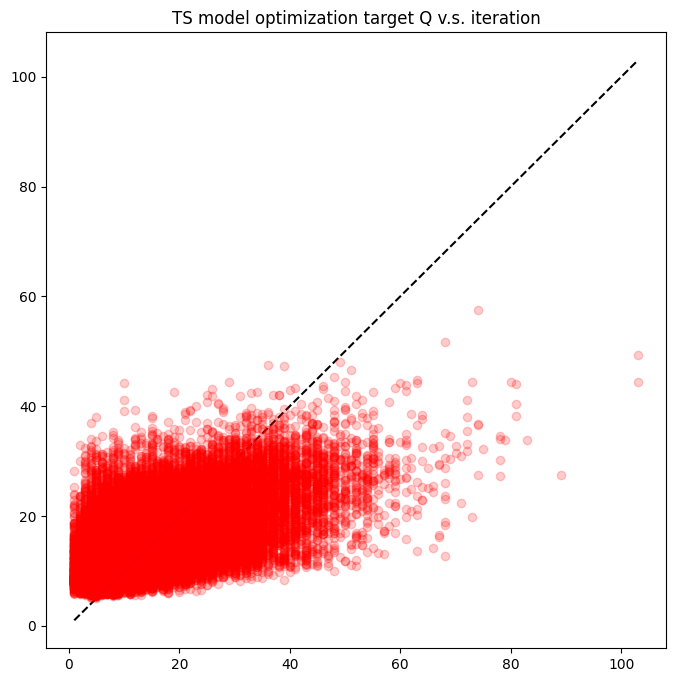

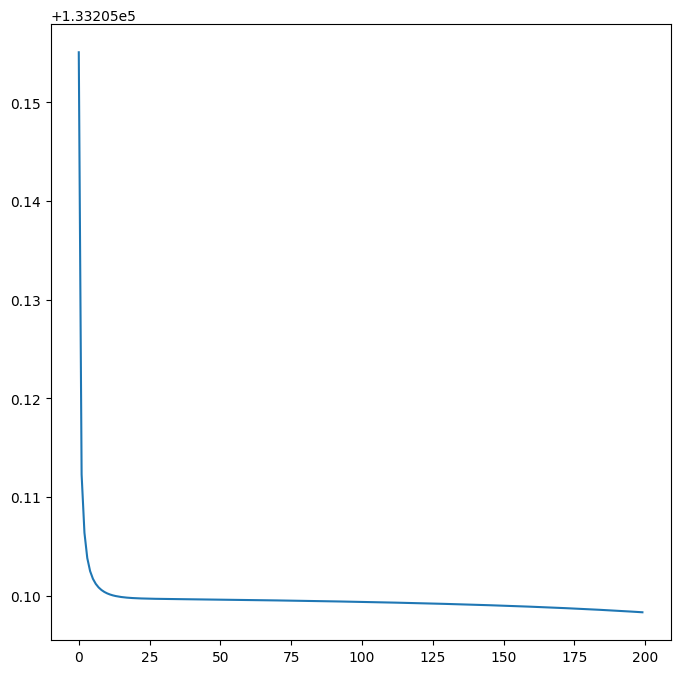

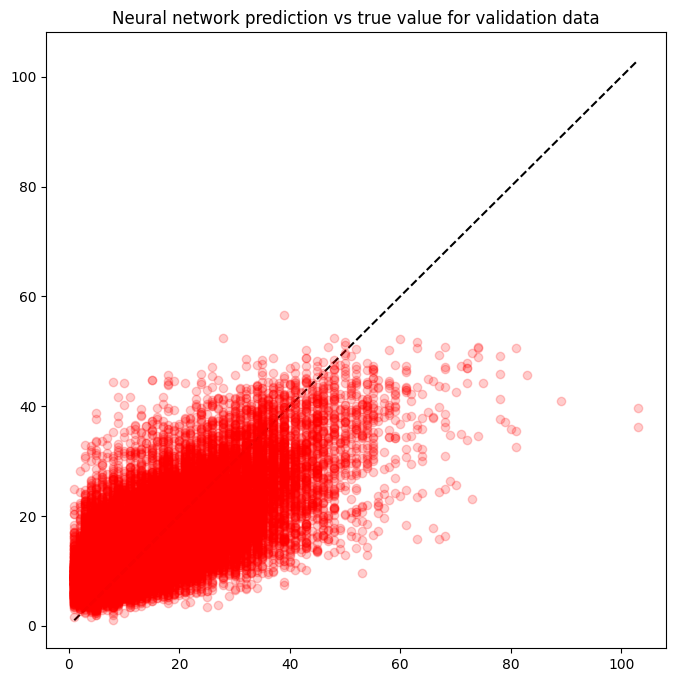

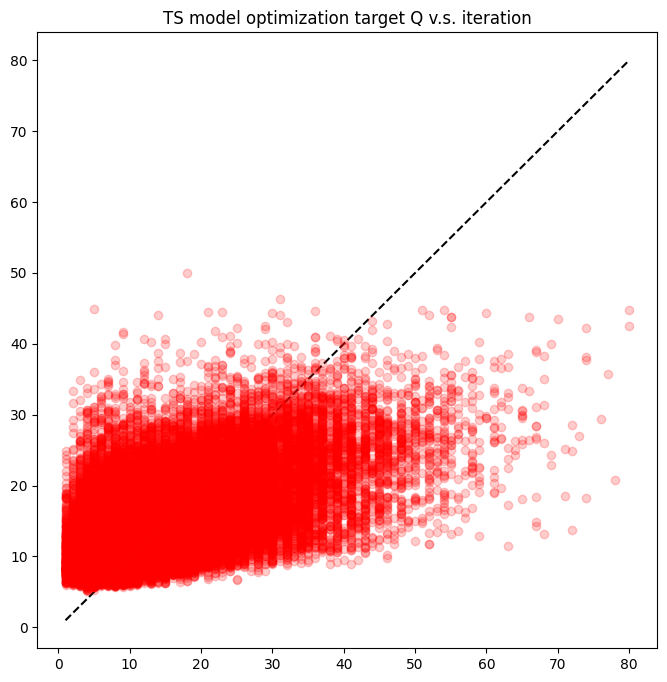

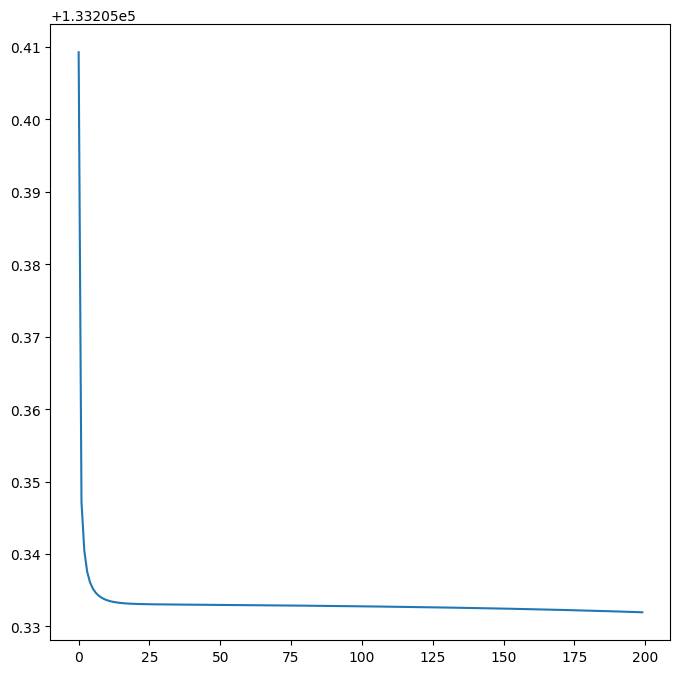

...

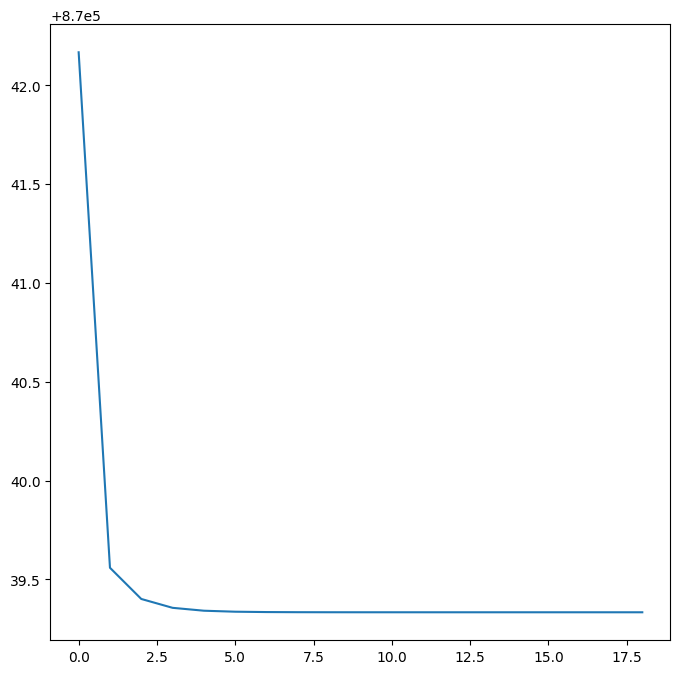

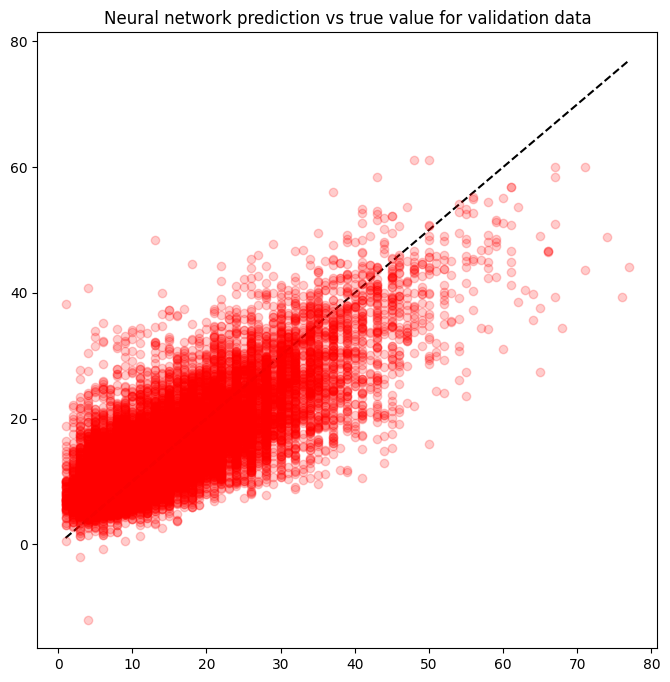

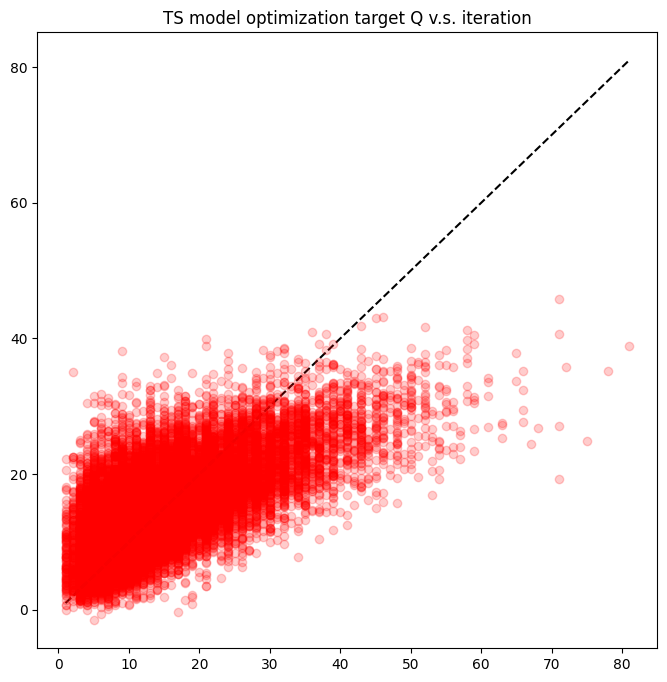

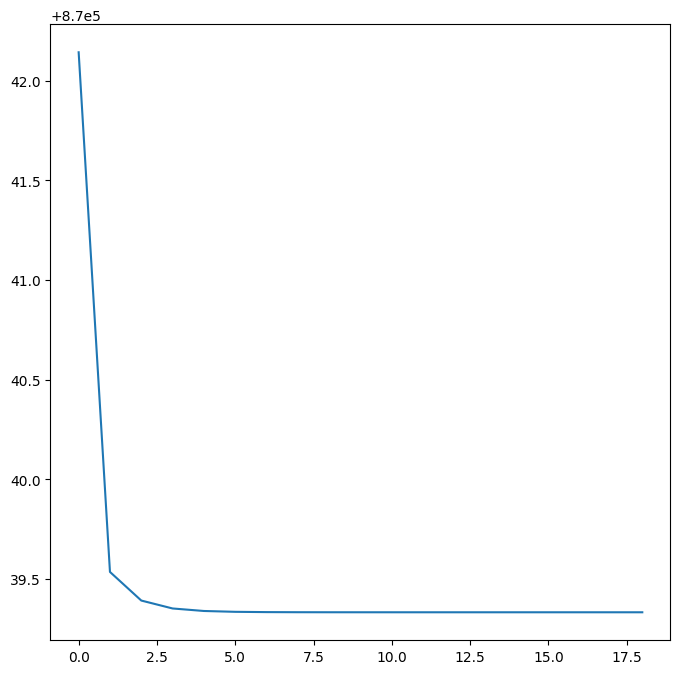

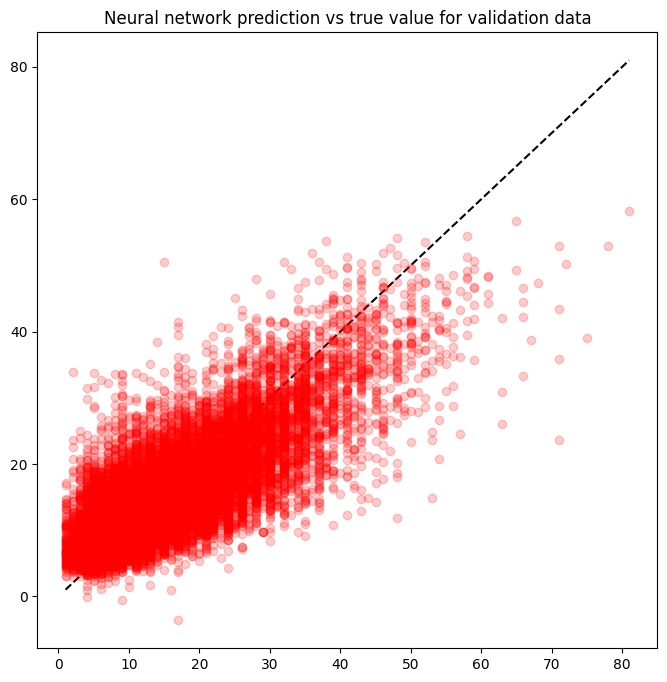

In [22]:
#do_experiment(number_of_neighbour_stations, train_data)

do_experiment(number_of_neighbour_stations)

In [27]:
training_results

[[{'linear_train': 6.937285680233024},
  {'fcm_train': 6.777653944203247},
  {'nn_train': 5.792380638122559},
  {'linear_train': 6.935833326890612},
  {'fcm_train': 6.776058697878171},
  {'nn_train': 5.79127682685852},
  {'linear_train': 6.941458575778255},
  {'fcm_train': 6.781181790015251},
  {'nn_train': 5.793268804550171},
  {'linear_train': 6.9355574360347205},
  {'fcm_train': 6.775958000226118},
  {'nn_train': 5.7977814102172855},
  {'linear_train': 6.9462447190761045},
  {'fcm_train': 6.786063755591592},
  {'nn_train': 5.794705200195312},
  {'linear_train': 6.9365646612064396},
  {'fcm_train': 6.775894674755205},
  {'nn_train': 5.800232315063477},
  {'linear_train': 6.942795790362091},
  {'fcm_train': 6.781660514873121},
  {'nn_train': 5.79719729423523},
  {'linear_train': 6.938089988861539},
  {'fcm_train': 6.779416684226652},
  {'nn_train': 5.798866624832153},
  {'linear_train': 6.939392097336989},
  {'fcm_train': 6.778826767843005},
  {'nn_train': 5.79539421081543},
  {'linea

exp
7.5965±0.0057
7.505±0.0115
6.7362±0.0098
exp
7.3281±0.0016
6.9009±0.0286
6.2541±0.0051
exp
7.0823±0.0033
6.6153±0.0128
6.0156±0.0074
exp
6.8814±0.0035
6.6879±0.0031
5.9618±0.0049
exp
6.9398±0.0029
6.7798±0.0029
5.9602±0.007
exp
6.7827±0.0023
6.7394±0.0022
5.9006±0.005
exp
6.7222±0.0039
6.6519±0.0039
5.8657±0.0082
exp
6.7355±0.0043
6.6157±0.0045
5.8997±0.0062
exp
6.6919±0.0043
6.581±0.0038
5.8519±0.0058
exp
6.7537±0.0046
6.5845±0.0063
5.8846±0.0085
exp
6.8672±0.0038
6.7549±0.0038
5.8974±0.0038
exp
6.9556±0.0039
6.8267±0.0043
5.9343±0.01
exp
7.0004±0.0059
6.874±0.0076
5.9244±0.0064
exp
7.0167±0.0046
6.9057±0.0043
5.9564±0.0093
exp
7.3629±0.003
7.2746±0.0065
6.0576±0.0156


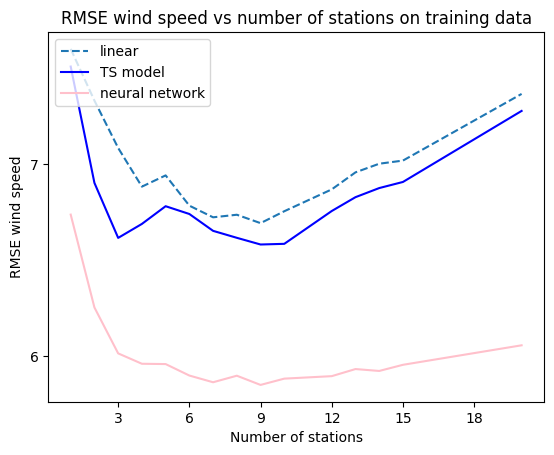

In [24]:
li_train_plot = []
fcm_train_plot = []
nn_train_plot = []
x_axis = number_of_neighbour_stations
for exp in training_results:
     li_train_plot.append(np.mean([d['linear_train'] for d in exp if 'linear_train' in d]))
     fcm_train_plot.append(np.mean([d['fcm_train'] for d in exp if 'fcm_train' in d]))
     nn_train_plot.append(np.mean([d['nn_train'] for d in exp if 'nn_train' in d]))

# insert the optimal value from previous experiments 
# li_train_plot.insert(1, 6.7202)
# fcm_train_plot.insert(1, 6.6459)
# nn_train_plot.insert(1, 5.8963)

fig, ax = plt.subplots()
for axis in [ax.xaxis, ax.yaxis]:
    axis.set_major_locator(ticker.MaxNLocator(integer=True))
    
plt.plot(x_axis, li_train_plot, '--', label='linear')
plt.plot(x_axis, fcm_train_plot, label='TS model', c='blue')
plt.plot(x_axis, nn_train_plot, label='neural network', c='pink')
plt.legend(loc="upper left")
#plt.ylim(5)
plt.xlabel('Number of stations')
plt.ylabel('RMSE wind speed')
plt.title('RMSE wind speed vs number of stations on training data')

for exp in training_results:
    print('exp')
    print(f"{np.round(np.mean([d['linear_train'] for d in exp if 'linear_train' in d]), 4)}±{np.round(np.std([d['linear_train'] for d in exp if 'linear_train' in d]),4)}")
    print(f"{np.round(np.mean([d['fcm_train'] for d in exp if 'fcm_train' in d]), 4)}±{np.round(np.std([d['fcm_train'] for d in exp if 'fcm_train' in d]),4)}")
    print(f"{np.round(np.mean([d['nn_train'] for d in exp if 'nn_train' in d]), 4)}±{np.round(np.std([d['nn_train'] for d in exp if 'nn_train' in d]),4)}")


exp
7.5964±0.0517
7.5055±0.052
6.722±0.0415
exp
7.3283±0.0145
6.9033±0.0267
6.242±0.0189
exp
7.0825±0.0297
6.6202±0.0308
6.0074±0.038
exp
6.8819±0.0311
6.6887±0.0275
5.9574±0.0264
exp
6.9405±0.0262
6.7813±0.0265
5.9571±0.0244
exp
6.7834±0.0205
6.7407±0.0206
5.8996±0.0224
exp
6.723±0.0349
6.6532±0.0352
5.8656±0.0331
exp
6.7364±0.0386
6.6173±0.0318
5.9052±0.0261
exp
6.6932±0.039
6.5834±0.0343
5.8591±0.0282
exp
6.755±0.0418
6.5869±0.0444
5.8956±0.0294
exp
6.869±0.0346
6.758±0.0331
5.9109±0.0372
exp
6.9575±0.0352
6.8296±0.038
5.9548±0.0365
exp
7.003±0.0523
6.8775±0.0498
5.9538±0.0506
exp
7.0202±0.0411
6.9098±0.0401
5.9861±0.0329
exp
7.3679±0.0288
7.2798±0.0298
6.1107±0.0323


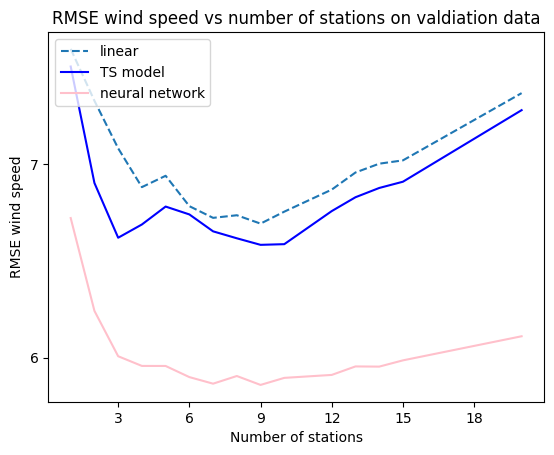

In [25]:
li_train_plot = []
fcm_train_plot = []
nn_train_plot = []
x_axis = number_of_neighbour_stations
for exp in validation_results:
     li_train_plot.append(np.mean([d['linear_val'] for d in exp if 'linear_val' in d]))
     fcm_train_plot.append(np.mean([d['fcm_val'] for d in exp if 'fcm_val' in d]))
     nn_train_plot.append(np.mean([d['nn_val'] for d in exp if 'nn_val' in d]))

fig, ax = plt.subplots()
for axis in [ax.xaxis, ax.yaxis]:
    axis.set_major_locator(ticker.MaxNLocator(integer=True))

# insert the optimal value from previous experiments 
# li_train_plot.insert(1, 6.7219)
# fcm_train_plot.insert(1, 6.6489)
# nn_train_plot.insert(1, 5.9011)


plt.plot(x_axis, li_train_plot, '--', label='linear')
plt.plot(x_axis, fcm_train_plot, label='TS model', c='blue')
plt.plot(x_axis, nn_train_plot, label='neural network', c='pink')
plt.legend(loc="upper left")
#plt.ylim(5)
plt.xlabel('Number of stations')
plt.ylabel('RMSE wind speed')
plt.title('RMSE wind speed vs number of stations on valdiation data')

for exp in validation_results:
    print('exp')
    print(f"{np.round(np.mean([d['linear_val'] for d in exp if 'linear_val' in d]), 4)}±{np.round(np.std([d['linear_val'] for d in exp if 'linear_val' in d]),4)}")
    print(f"{np.round(np.mean([d['fcm_val'] for d in exp if 'fcm_val' in d]), 4)}±{np.round(np.std([d['fcm_val'] for d in exp if 'fcm_val' in d]),4)}")
    print(f"{np.round(np.mean([d['nn_val'] for d in exp if 'nn_val' in d]), 4)}±{np.round(np.std([d['nn_val'] for d in exp if 'nn_val' in d]),4)}")


In [26]:
temp_nn = np.array(nn_histories)

In [27]:
exp = temp_nn[6]
nn_loss = exp[2]['loss']

nn_loss

[48.2754020690918,
 36.76954650878906,
 35.79018020629883,
 35.303348541259766,
 34.9672737121582,
 34.768035888671875,
 34.64188003540039,
 34.542293548583984,
 34.436248779296875,
 34.378211975097656,
 34.3110466003418,
 34.26872253417969,
 34.21078872680664,
 34.202701568603516,
 34.15977478027344,
 34.114891052246094,
 34.092403411865234,
 34.05234909057617,
 34.030250549316406,
 33.99851608276367,
 33.95941925048828,
 33.930477142333984,
 33.91409683227539,
 33.88493347167969,
 33.86783981323242,
 33.85749435424805,
 33.83987045288086,
 33.835079193115234,
 33.8038215637207,
 33.79180145263672,
 33.790855407714844,
 33.78647232055664,
 33.764984130859375,
 33.75788497924805,
 33.73994064331055,
 33.733863830566406,
 33.73542404174805,
 33.71522521972656,
 33.69873046875,
 33.70526123046875,
 33.698001861572266,
 33.66484832763672,
 33.68733215332031,
 33.67353439331055,
 33.66569519042969,
 33.654273986816406,
 33.65587615966797,
 33.66012191772461,
 33.649173736572266,
 33.634197

Text(0.5, 1.0, 'Loss vs number of epoches')

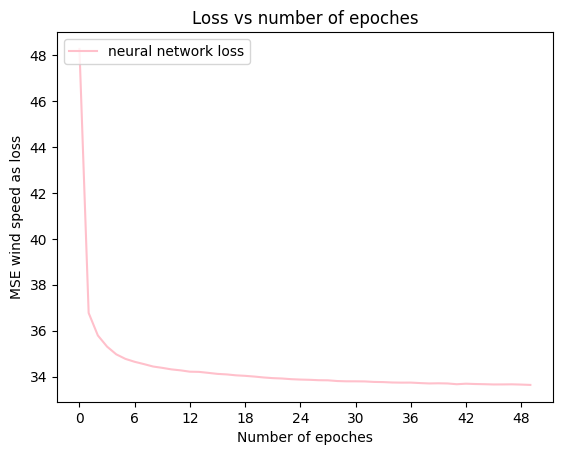

In [28]:
fig, ax = plt.subplots()
for axis in [ax.xaxis, ax.yaxis]:
    axis.set_major_locator(ticker.MaxNLocator(integer=True))
    
plt.plot(nn_loss, label='neural network loss', c='pink')
plt.legend(loc="upper left")
#plt.ylim(5)
plt.xlabel('Number of epoches')
plt.ylabel('MSE wind speed as loss')
plt.title('Loss vs number of epoches')

In [29]:
len(training_times)

450

In [30]:
# Source: https://stackoverflow.com/questions/2231663/slicing-a-list-into-a-list-of-sub-lists
grouped_training_times = [training_times[i:i+30] for i in range(0, len(training_times), 30)]        # Group by model per fold


In [35]:
grouped_training_times[11]

[{'linear_train': 1.1885337829589844},
 {'fcm_train': 47.0850293636322},
 {'nn_train': 611.6490378379822},
 {'linear_train': 1.1891915798187256},
 {'fcm_train': 47.28111672401428},
 {'nn_train': 610.892941236496},
 {'linear_train': 1.1722517013549805},
 {'fcm_train': 47.650712966918945},
 {'nn_train': 616.2367959022522},
 {'linear_train': 1.2263929843902588},
 {'fcm_train': 46.76435995101929},
 {'nn_train': 620.5487222671509},
 {'linear_train': 1.2690141201019287},
 {'fcm_train': 48.21208333969116},
 {'nn_train': 624.3018560409546},
 {'linear_train': 1.1607170104980469},
 {'fcm_train': 47.504802227020264},
 {'nn_train': 626.3915338516235},
 {'linear_train': 1.1707184314727783},
 {'fcm_train': 47.83291935920715},
 {'nn_train': 621.5114448070526},
 {'linear_train': 1.175619125366211},
 {'fcm_train': 47.43055868148804},
 {'nn_train': 621.8782846927643},
 {'linear_train': 1.1741902828216553},
 {'fcm_train': 46.92054200172424},
 {'nn_train': 625.2236030101776},
 {'linear_train': 1.188011646

Text(0.5, 1.0, 'Model traning time per fold')

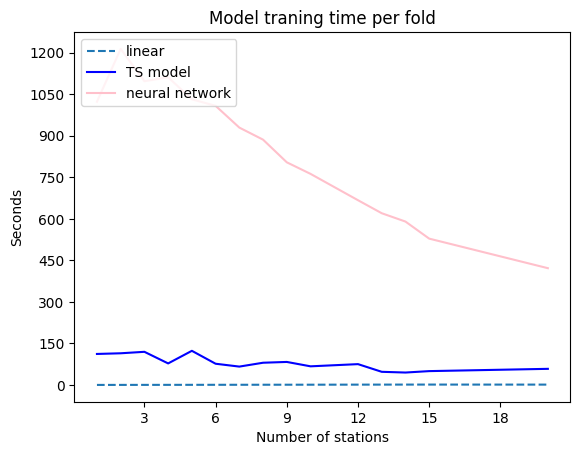

In [33]:
li_time_plot = []
fcm_time_plot = []
nn_time_plot = []
x_axis = number_of_neighbour_stations
for exp in grouped_training_times:
    li_time_plot.append(np.mean([d['linear_train'] for d in exp if 'linear_train' in d]))
    fcm_time_plot.append(np.mean([d['fcm_train'] for d in exp if 'fcm_train' in d]))
    nn_time_plot.append(np.mean([d['nn_train'] for d in exp if 'nn_train' in d]))

fig, ax = plt.subplots()
for axis in [ax.xaxis, ax.yaxis]:
    axis.set_major_locator(ticker.MaxNLocator(integer=True))
    
plt.plot(x_axis, li_time_plot, '--', label='linear')
plt.plot(x_axis, fcm_time_plot, label='TS model', c='blue')
plt.plot(x_axis, nn_time_plot, label='neural network', c='pink')
plt.legend(loc="upper left")
plt.xlabel('Number of stations')
plt.ylabel('Seconds')
plt.title('Model traning time per fold')


In [72]:
opt_x = pd.read_csv('Data/exp/1016completed/10x.csv')
opt_y = pd.read_csv('Data/exp/1016completed/10y.csv')

FCM traning RMSE: 4.7041978587581745
FCM traning RMSE: 4.578349891095775
FCM traning RMSE: 4.462840415679469
FCM traning RMSE: 4.37252234427543
FCM traning RMSE: 4.331001145241712
FCM traning RMSE: 4.247307560494564
FCM traning RMSE: 4.212377299815498
FCM traning RMSE: 4.159740246808089
FCM traning RMSE: 4.140635021023132
FCM traning RMSE: 4.109718360390749
FCM traning RMSE: 4.082638429622358
FCM traning RMSE: 4.040184030129435
FCM traning RMSE: 4.024720698170112


ValueError: Input could not be cast to an at-least-1D NumPy array

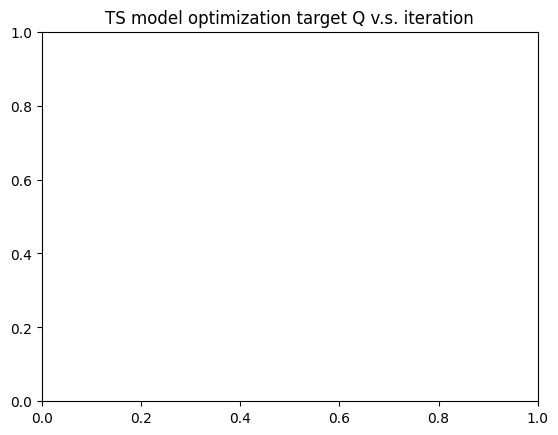

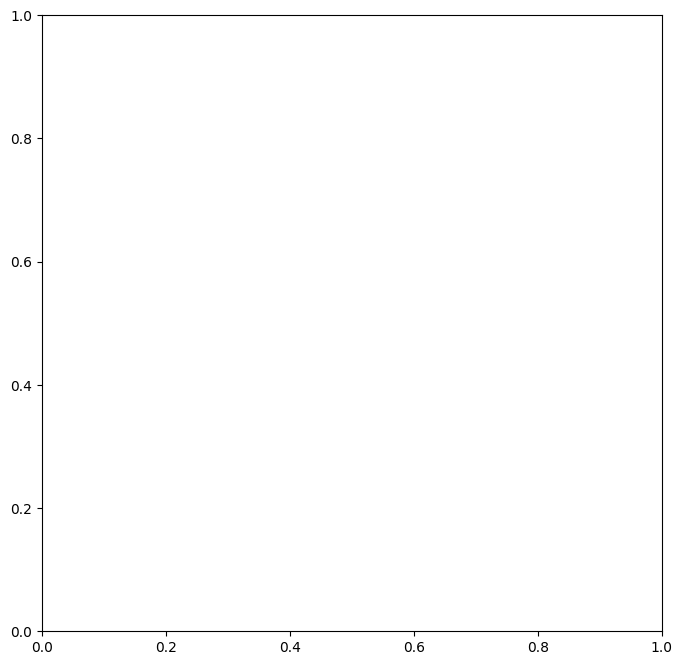

In [74]:
# Plot Q vs # of Nc
# Fcm hyperparameters
FCM_Ncs = [2,3,5,8,10,15,20,25,30,40,50,80,100]
FCM_m = 2
tol = 1e-5
max_iter = 200
qs = []

for FCM_Nc in FCM_Ncs:   
    N = opt_x.shape[0]
    U = np.random.rand(N, FCM_Nc)
    U = U / np.sum(U, axis=1, keepdims=True)
    temp_qs = []

    # Fuzzy C-Means 聚类
    for _ in range(max_iter):
        U_old = U.copy()
        mf = U ** FCM_m
        cen = np.dot(mf.T, opt_x) / np.sum(mf, axis=0, keepdims=True).T
        dists = cdist(opt_x, cen)
        tmp = np.power(dists, -2 / (FCM_m - 1))
        U = tmp / np.sum(tmp, axis=1, keepdims=True)

        q = np.sum((U ** FCM_m) * (dists ** 2))
        temp_qs.append(q)

        # 检查是否收敛
        if np.linalg.norm(U - U_old) < tol:
            break
    # 模型训练 find if this can be optimized
    z = np.hstack((np.ones((N, 1)), opt_x))
    H = np.zeros((N, FCM_Nc * (opt_x.shape[1] + 1)))

    # 生成模糊规则矩阵 H
    for j in range(FCM_Nc):
        Uj = np.tile(U[:, j], (opt_x.shape[1] + 1, 1)).T
        H[:, (j * (opt_x.shape[1] + 1)):((j + 1) * (opt_x.shape[1] + 1))] = Uj * z

    # 计算权重 W
    W = pinv(np.dot(H.T, H)).dot(H.T).dot(opt_y)

        
    # 在训练集上进行预测
    y_hat_train = np.dot(H, W)
    mse_train = mean_squared_error(opt_y, y_hat_train)
    rmse_train = sqrt(mean_squared_error(opt_y, y_hat_train))
    print("FCM traning RMSE:", rmse_train)
    qs.append(temp_qs)
    
plt.title('TS model optimization target Q v.s. iteration')
plt.figure(figsize=(8,8))
plt.plot(qs)

Text(0.5, 1.0, 'TS model optimization target Q v.s. iteration for differenct number of rules')

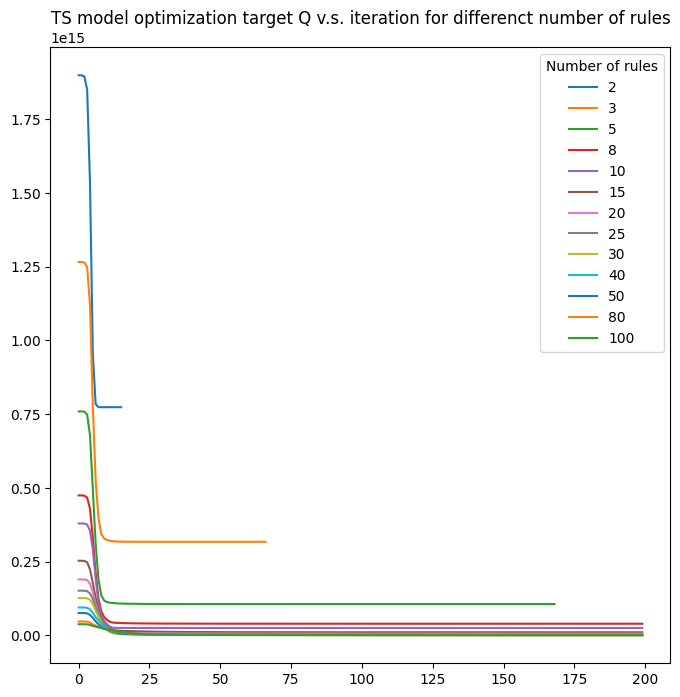

In [90]:
plt.figure(figsize=(8,8))

for exp in qs:
    plt.plot(exp)

plt.legend(FCM_Ncs, title="Number of rules")
plt.title('TS model optimization target Q v.s. iteration for differenct number of rules')